In [53]:
import pathlib

# Define data directory
data_dir = pathlib.Path('data/heatmap')
train_dir = data_dir / 'train'
test_dir = data_dir / 'test'
train_masks_dir = pathlib.Path('masks/train')
test_masks_dir = pathlib.Path('masks/test')

In [54]:
import os
import cv2
import numpy as np

# check if the pixels are normalized
img = cv2.imread(os.path.join(test_dir, 'P1MF1_C.png'), cv2.IMREAD_GRAYSCALE)
print(np.max(img), np.min(img))
img_mask = cv2.imread(os.path.join(test_masks_dir, 'P1MF1_C.Png'), cv2.IMREAD_GRAYSCALE)
print(np.max(img_mask), np.min(img_mask))
print(img.shape, img_mask.shape)

225 14
255 0
(4096, 4096) (4096, 4096)


In [55]:
X_train = []
y_train = []
X_test = []
y_test = []

for img_path in train_dir.glob('*.png'):
    img = cv2.imread(str(img_path))
    img = cv2.resize(img, (256, 256))
    X_train.append(img)
    mask_path = os.path.join(train_masks_dir, img_path.stem + '.Png')
    img_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    img_mask = cv2.resize(img_mask, (256, 256))
    y_train.append(img_mask)

for img_path in test_dir.glob('*.png'):
    img = cv2.imread(str(img_path))
    img = cv2.resize(img, (256, 256))
    X_test.append(img)
    mask_path = os.path.join(test_masks_dir, img_path.stem + '.Png')
    img_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    img_mask = cv2.resize(img_mask, (256, 256))
    y_test.append(img_mask)

X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

# # Expand the dimensions of the images
#X_train = np.expand_dims(X_train, axis = 3)
y_train = np.expand_dims(y_train, axis = 3)
#X_test = np.expand_dims(X_test, axis = 3)
y_test = np.expand_dims(y_test, axis = 3)

print(X_train.shape, y_train.shape)

(50, 256, 256, 3) (50, 256, 256, 1)


In [56]:
import tensorflow as tf

train_dataset = tf.data.Dataset.from_tensor_slices((X_train, y_train))
test_dataset = tf.data.Dataset.from_tensor_slices((X_test, y_test))

In [57]:
def normalize(input_image, input_mask):
    input_image = tf.cast(input_image, tf.float32) / 255.0
    input_mask = tf.round(tf.cast(input_mask, tf.float32) / 255.0)
    return input_image, input_mask

def load_image(input_image, input_mask):
    input_image = tf.image.resize(input_image, (128, 128))
    input_mask = tf.image.resize(input_mask,(128, 128), method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    input_image, input_mask = normalize(input_image, input_mask)
    return input_image, input_mask

In [58]:
TRAIN_LENGTH = len(X_train)
BATCH_SIZE = 8
BUFFER_SIZE = 1000
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

In [59]:
train_ds = train_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
test_ds = test_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

print("the shape of the train dataset is: ", train_ds)
# Show the labels of the first image
for image, mask in train_ds.take(1):
    print(" max value of the image is: ", np.min(image.numpy()))
    # print("the shape of the image is: ", image.numpy().shape)
    # print("the shape of the mask is: ", mask.numpy().shape)
    # print("the label of the first image is: ", mask.numpy())

the shape of the train dataset is:  <_ParallelMapDataset element_spec=(TensorSpec(shape=(128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(128, 128, 1), dtype=tf.float32, name=None))>
 max value of the image is:  0.0


In [60]:
class Augment(tf.keras.layers.Layer):
  def __init__(self, seed=42):
    super().__init__()
    # both use the same seed, so they'll make the same random changes.
    # do augmentation in ratio of 1 to 5 images in the train
    self.augment_inputs = tf.keras.Sequential([
        tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
        tf.keras.layers.RandomRotation(factor=0.2, seed=seed),
        tf.keras.layers.RandomZoom(height_factor=0.1, width_factor=0.1, seed=seed),
        tf.keras.layers.RandomTranslation(height_factor=0.1, width_factor=0.1, seed=seed),
        tf.keras.layers.RandomContrast(factor=0.1, seed=seed),
    ], name="augment_inputs")

    self.augment_labels = tf.keras.Sequential([
        tf.keras.layers.RandomFlip(mode="horizontal", seed=seed),
        tf.keras.layers.RandomRotation(factor=0.2, seed=seed),
        tf.keras.layers.RandomZoom(height_factor=0.1, width_factor=0.1, seed=seed),
        tf.keras.layers.RandomTranslation(height_factor=0.1, width_factor=0.1, seed=seed),
    ], name="augment_labels")

  def call(self, inputs, labels):
    inputs = self.augment_inputs(inputs)
    labels = self.augment_labels(labels)
    return inputs, labels

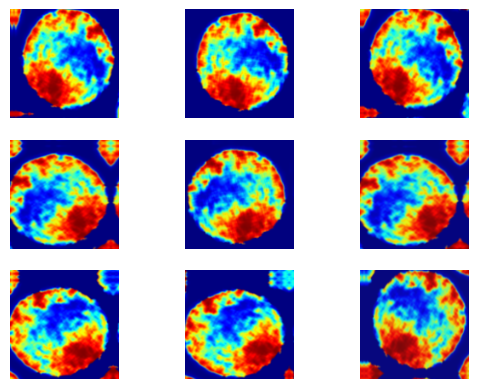

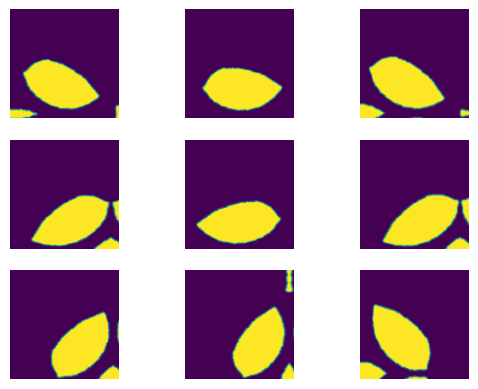

In [61]:
from matplotlib import pyplot as plt
# plot 9 augmentations of the image and the mask for one original image and its mask
for image, mask in train_ds.take(1):
    # random seed array
    seed = np.random.randint(0, 1000, 9)
    for i in range(9):
        plt.subplot(330 + 1 + i)
        augmented_image, augmented_mask = Augment(seed[i])(image, mask)
        # Convert from gbr to rgb
        augmented_image = augmented_image.numpy()
        augmented_image = cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB)
        plt.imshow(augmented_image)
        plt.axis("off")
    plt.show()
    for i in range(9):
        plt.subplot(330 + 1 + i)
        augmented_image, augmented_mask = Augment(seed[i])(image, mask)
        plt.imshow(augmented_mask.numpy())
        plt.axis("off")
    plt.show()

In [62]:
train_batches = (
    train_ds
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .map(Augment())
    .prefetch(buffer_size=tf.data.AUTOTUNE))

test_batches = test_ds.batch(BATCH_SIZE)

In [63]:
from matplotlib import pyplot as plt

def display(display_list):
  plt.figure(figsize=(15, 15))

  title = ['Input Image', 'True Mask', 'Predicted Mask']

  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    img = tf.keras.preprocessing.image.array_to_img(display_list[i])
    # Convert from gbr to rgb
    img = cv2.cvtColor(np.array(img), cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    # print the unique values of the image
    #print(np.unique(display_list[i]))
    plt.axis('off')
  plt.show()

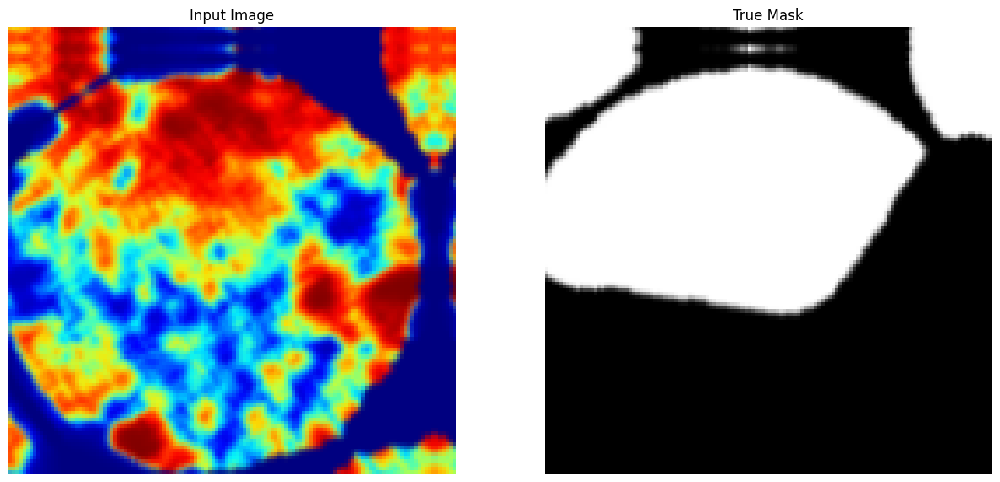

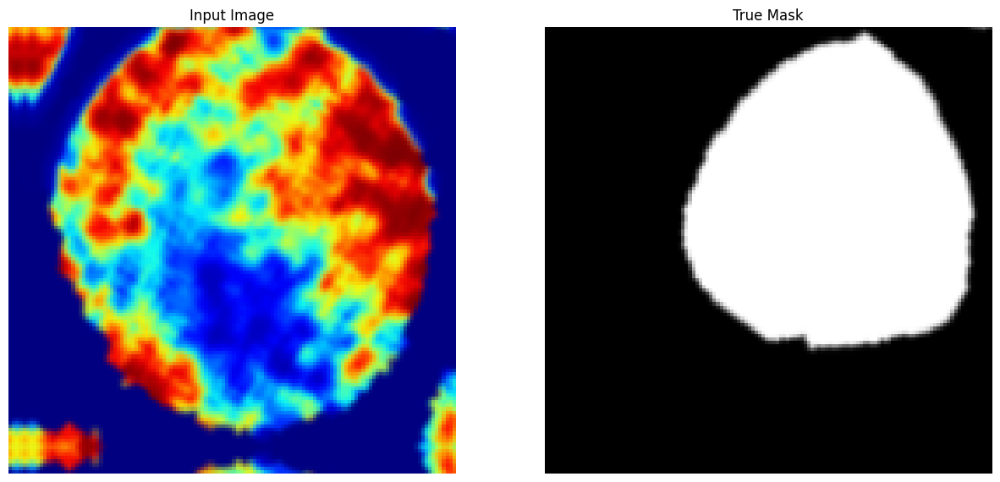

In [64]:
for images, masks in train_batches.take(2):
  sample_image, sample_mask = images[0], masks[0]
  display([sample_image, sample_mask])

In [65]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[128, 128, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)

# Make the last two layers trainable, but keep the rest frozen
for layer in down_stack.layers:  # Exclude the last two layers
    layer.trainable = False

# # Now, set the last two layers to be trainable
# for layer in down_stack.layers[-1:]:
#     layer.trainable = True

In [66]:
from tensorflow_examples.models.pix2pix import pix2pix

up_stack = [
    pix2pix.upsample(512, 3),  # 4x4 -> 8x8
    pix2pix.upsample(256, 3),  # 8x8 -> 16x16
    pix2pix.upsample(128, 3),  # 16x16 -> 32x32
    pix2pix.upsample(64, 3),   # 32x32 -> 64x64
    pix2pix.upsample(32, 3),   # 64x64 -> 128x128
]

# Make the last two layers of the up_stack trainable, but keep the rest frozen
# for layer in up_stack[0:0]:  # Exclude the last two layers
#     layer.trainable = False

# # Now, set the last two layers to be trainable
for layer in up_stack:
    layer.trainable = True


In [67]:
def unet_model(output_channels:int):
  inputs = tf.keras.layers.Input(shape=[128, 128, 3])

  # Downsampling through the model
  skips = down_stack(inputs)
  x = skips[-1]
  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    concat = tf.keras.layers.Concatenate()
    x = concat([x, skip])

  # This is the last layer of the model
  last = tf.keras.layers.Conv2DTranspose(
      filters=output_channels, kernel_size=3, strides=2,
      padding='same')  #64x64 -> 128x128

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

In [68]:
# Try the model
def create_mask(pred_mask):
  pred_mask = tf.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

In [69]:
class WeightedSCCE(tf.keras.losses.Loss):
    def __init__(self, class_weight, from_logits=False, name='weighted_scce'):
        if class_weight is None or all(v == 1. for v in class_weight):
            self.class_weight = None
        else:
            self.class_weight = tf.convert_to_tensor(class_weight,
                dtype=tf.float32)
        self.name = name
        self.reduction = tf.keras.losses.Reduction.NONE
        self.unreduced_scce = tf.keras.losses.SparseCategoricalCrossentropy(
            from_logits=from_logits, name=name,
            reduction=self.reduction)

    def __call__(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, dtype=tf.int32)
        loss = self.unreduced_scce(y_true, y_pred, sample_weight)
        if self.class_weight is not None:
            weight_mask = tf.gather(self.class_weight, y_true)
            loss = tf.math.multiply(loss, weight_mask)
        return loss


In [70]:
import tensorflow as tf
# Assuming OUTPUT_CLASSES is the number of classes in your segmentation task
OUTPUT_CLASSES = 2

# Create the U-Net model
model = unet_model(output_channels=OUTPUT_CLASSES)

# Compile the model
model.compile(optimizer='adam',
              loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [71]:
def show_predictions(dataset=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask,
             create_mask(model.predict(sample_image[tf.newaxis, ...]))])

1/1 [==============================] - 1s 731ms/step


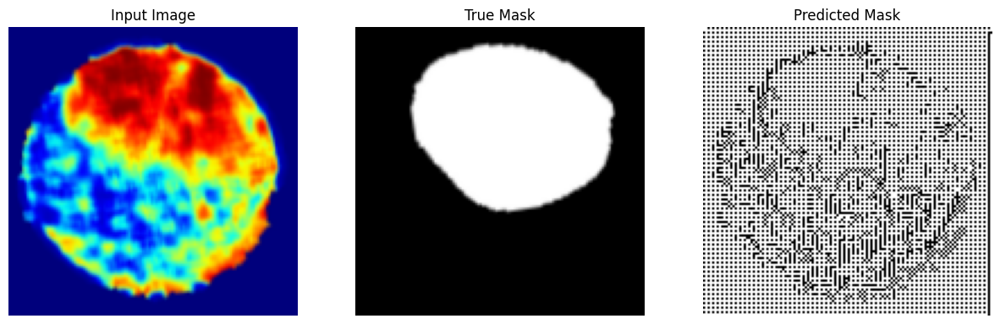

1/1 [==============================] - 0s 175ms/step


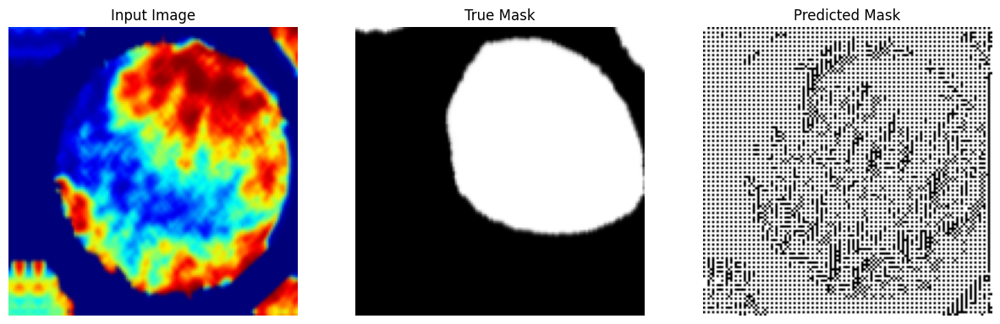

1/1 [==============================] - 0s 189ms/step


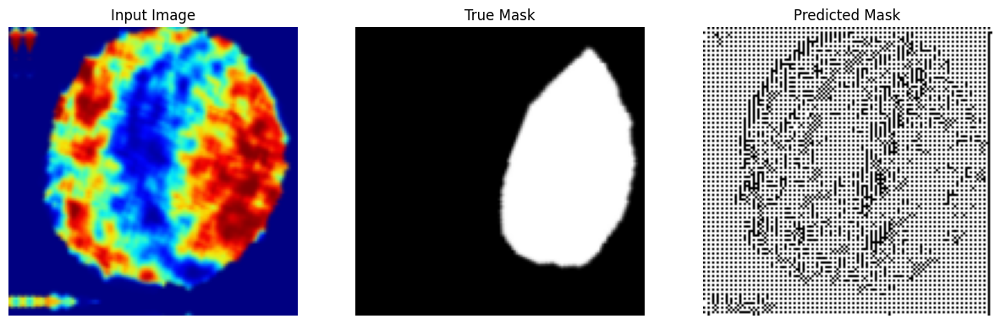

In [72]:
show_predictions(train_batches, 3)

In [73]:
from IPython.display import clear_output

class DisplayCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):
    #clear_output(wait=True)
    show_predictions(train_batches, 1)
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

Epoch 1/200
1/1 [==============================] - 0s 155ms/step


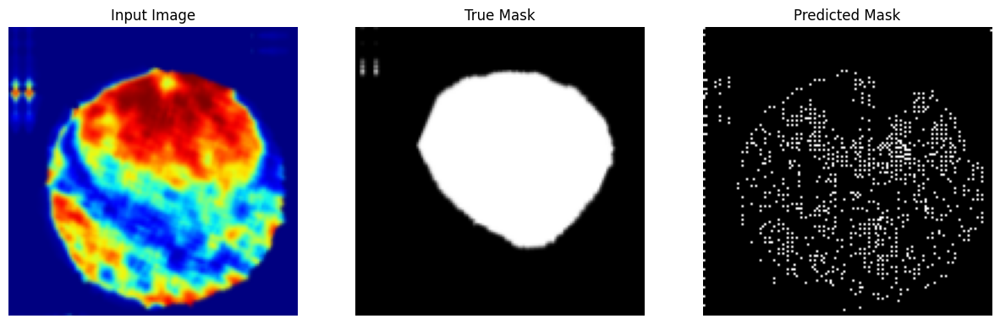


Sample Prediction after epoch 1

6/6 [==============================] - 6s 648ms/step - loss: 0.7174 - accuracy: 0.5428 - val_loss: 0.6195 - val_accuracy: 0.6921
Epoch 2/200
1/1 [==============================] - 0s 137ms/step


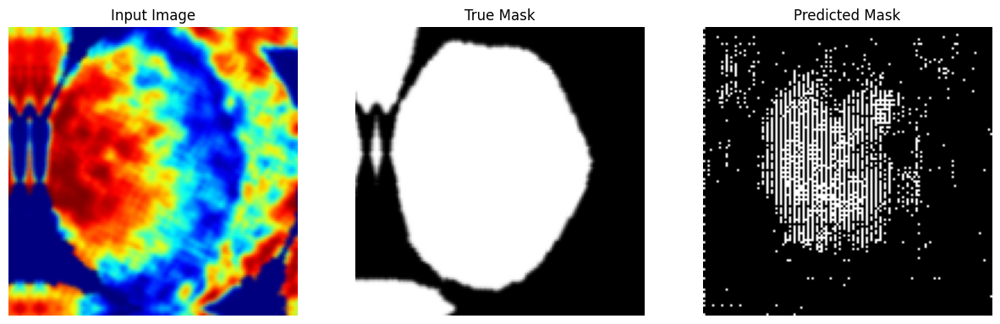


Sample Prediction after epoch 2

6/6 [==============================] - 2s 425ms/step - loss: 0.5082 - accuracy: 0.6693 - val_loss: 0.5076 - val_accuracy: 0.7521
Epoch 3/200
1/1 [==============================] - 0s 127ms/step


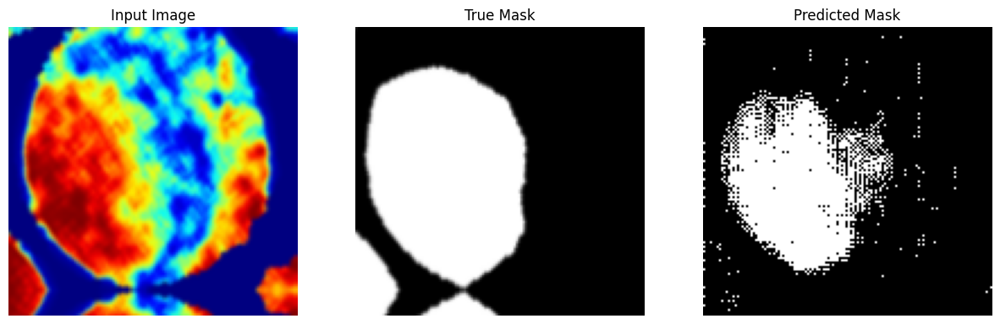


Sample Prediction after epoch 3

6/6 [==============================] - 2s 393ms/step - loss: 0.3994 - accuracy: 0.7478 - val_loss: 0.3958 - val_accuracy: 0.8150
Epoch 4/200
1/1 [==============================] - 0s 142ms/step


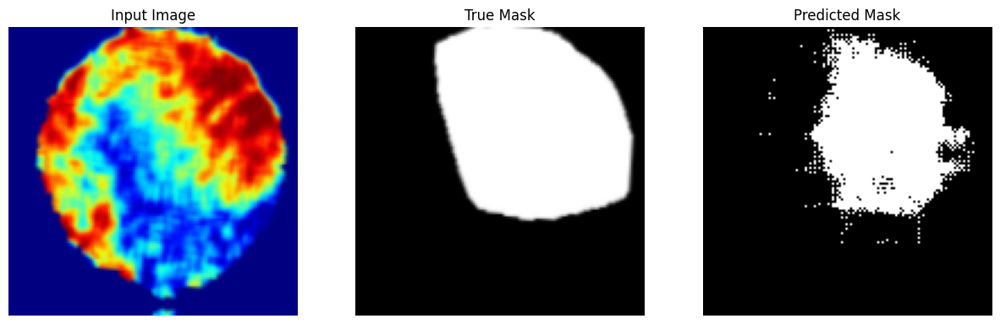


Sample Prediction after epoch 4

6/6 [==============================] - 2s 417ms/step - loss: 0.3366 - accuracy: 0.8019 - val_loss: 0.3697 - val_accuracy: 0.8407
Epoch 5/200
1/1 [==============================] - 0s 143ms/step


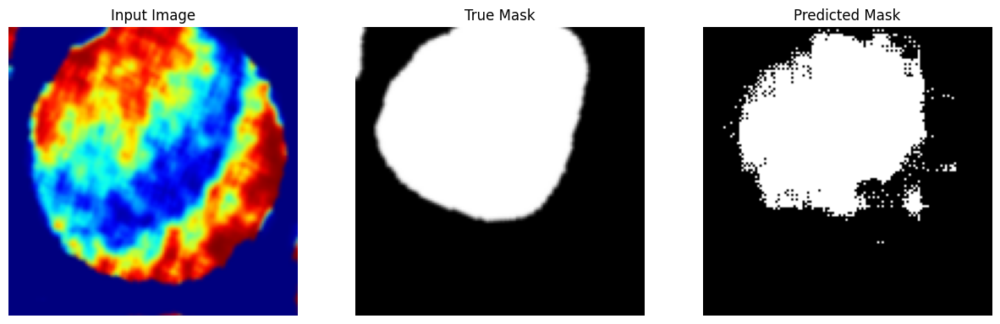


Sample Prediction after epoch 5

6/6 [==============================] - 2s 379ms/step - loss: 0.2988 - accuracy: 0.8262 - val_loss: 0.3019 - val_accuracy: 0.8726
Epoch 6/200
1/1 [==============================] - 0s 141ms/step


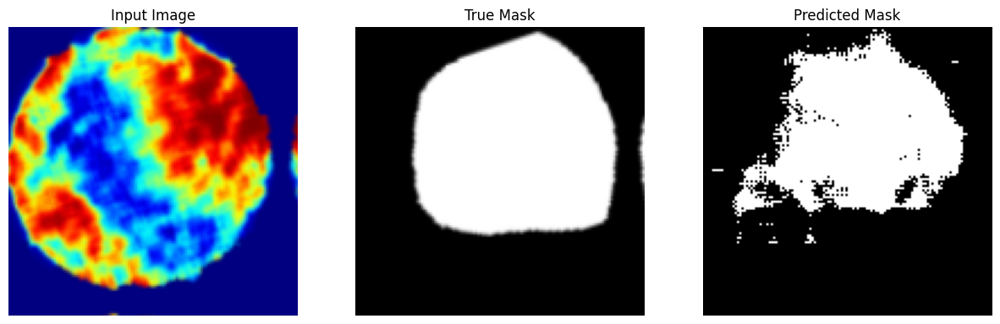


Sample Prediction after epoch 6

6/6 [==============================] - 2s 371ms/step - loss: 0.2736 - accuracy: 0.8283 - val_loss: 0.3399 - val_accuracy: 0.8554
Epoch 7/200
1/1 [==============================] - 0s 142ms/step


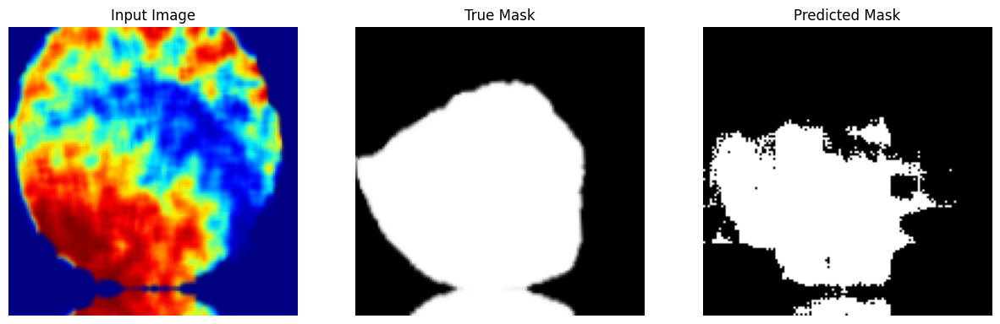


Sample Prediction after epoch 7

6/6 [==============================] - 2s 373ms/step - loss: 0.2472 - accuracy: 0.8405 - val_loss: 0.3984 - val_accuracy: 0.8421
Epoch 8/200
1/1 [==============================] - 0s 141ms/step


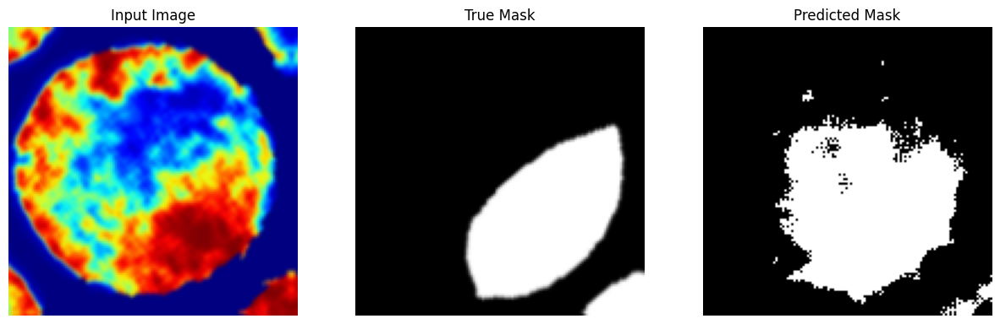


Sample Prediction after epoch 8

6/6 [==============================] - 2s 415ms/step - loss: 0.2275 - accuracy: 0.8439 - val_loss: 0.2799 - val_accuracy: 0.8823
Epoch 9/200
1/1 [==============================] - 0s 142ms/step


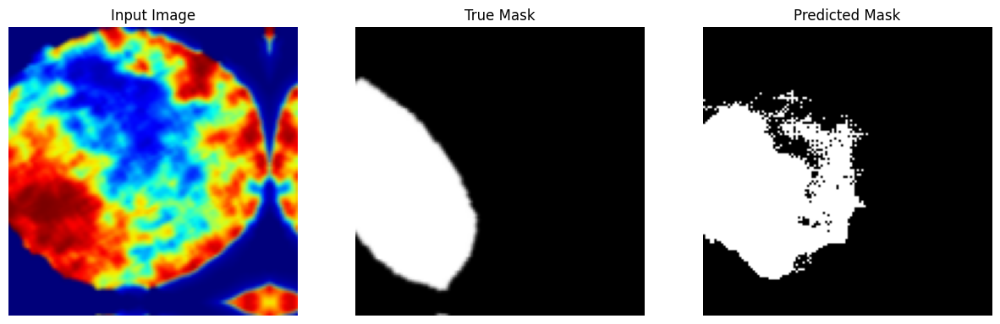


Sample Prediction after epoch 9

6/6 [==============================] - 2s 411ms/step - loss: 0.2187 - accuracy: 0.8507 - val_loss: 0.4473 - val_accuracy: 0.8287
Epoch 10/200
1/1 [==============================] - 0s 142ms/step


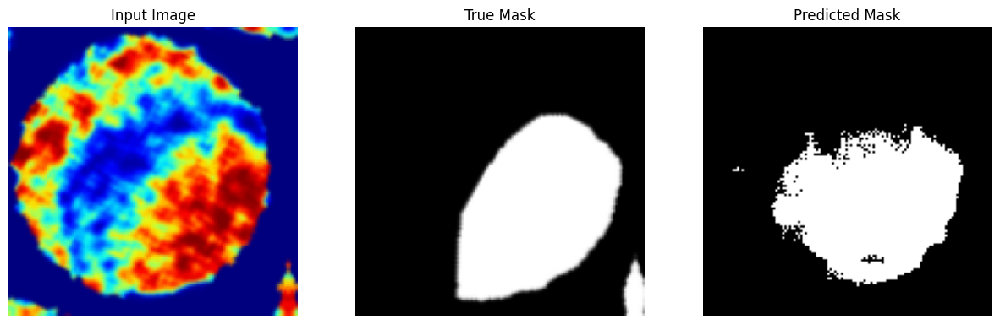


Sample Prediction after epoch 10

6/6 [==============================] - 2s 373ms/step - loss: 0.1945 - accuracy: 0.8649 - val_loss: 0.2910 - val_accuracy: 0.8768
Epoch 11/200
1/1 [==============================] - 0s 142ms/step


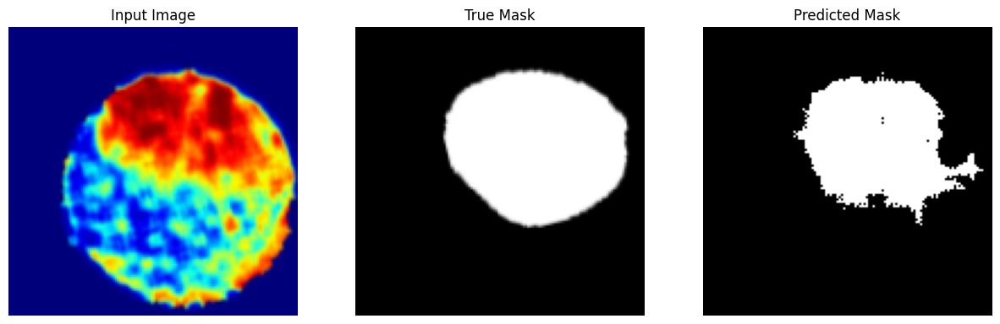


Sample Prediction after epoch 11

6/6 [==============================] - 2s 401ms/step - loss: 0.2054 - accuracy: 0.8571 - val_loss: 0.3322 - val_accuracy: 0.8747
Epoch 12/200
1/1 [==============================] - 0s 142ms/step


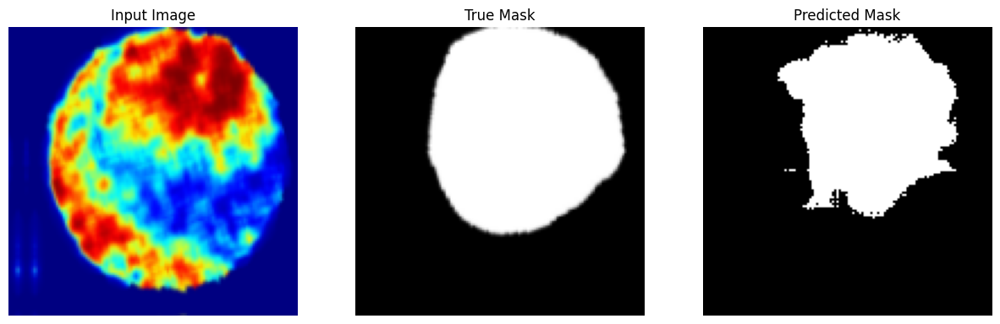


Sample Prediction after epoch 12

6/6 [==============================] - 2s 405ms/step - loss: 0.1991 - accuracy: 0.8596 - val_loss: 0.3516 - val_accuracy: 0.8731
Epoch 13/200
1/1 [==============================] - 0s 157ms/step


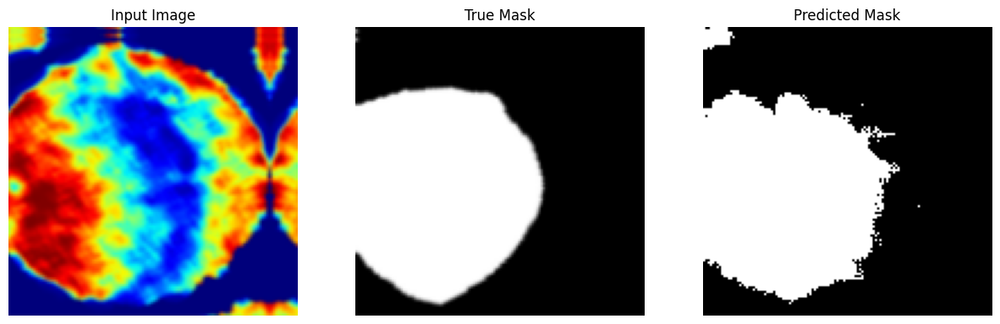


Sample Prediction after epoch 13

6/6 [==============================] - 2s 415ms/step - loss: 0.2101 - accuracy: 0.8508 - val_loss: 0.2694 - val_accuracy: 0.8878
Epoch 14/200
1/1 [==============================] - 0s 142ms/step


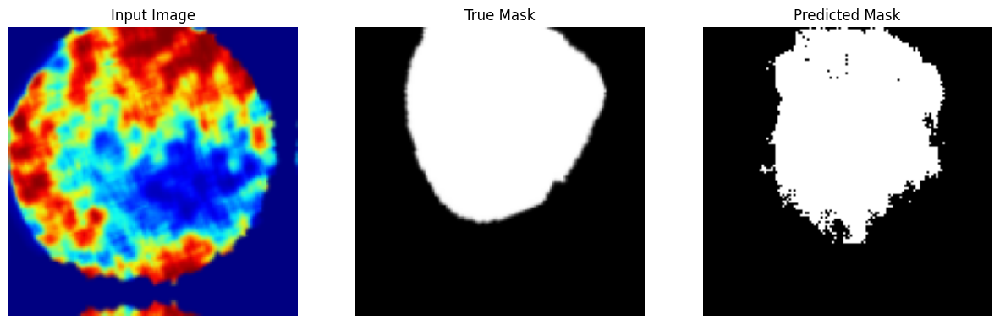


Sample Prediction after epoch 14

6/6 [==============================] - 2s 382ms/step - loss: 0.1884 - accuracy: 0.8602 - val_loss: 0.2343 - val_accuracy: 0.8943
Epoch 15/200
1/1 [==============================] - 0s 127ms/step


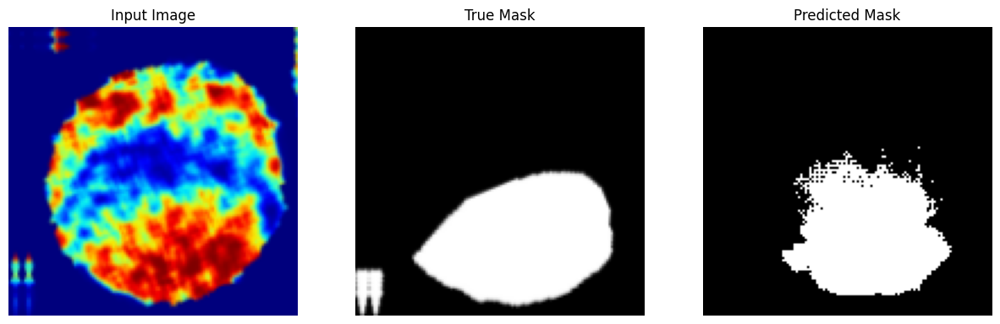


Sample Prediction after epoch 15

6/6 [==============================] - 2s 403ms/step - loss: 0.2052 - accuracy: 0.8553 - val_loss: 0.2874 - val_accuracy: 0.8784
Epoch 16/200
1/1 [==============================] - 0s 126ms/step


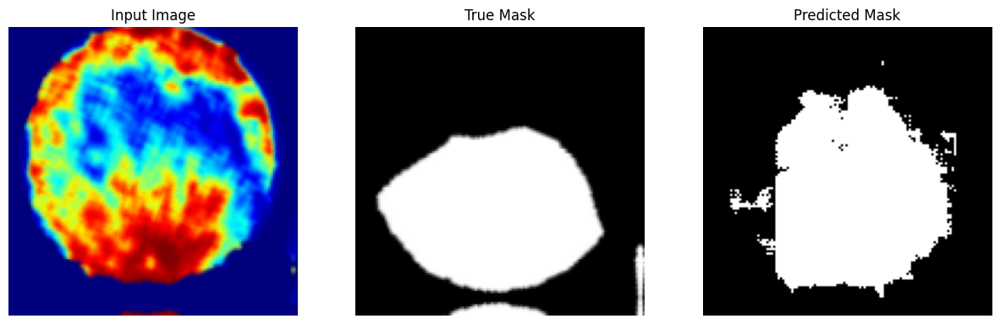


Sample Prediction after epoch 16

6/6 [==============================] - 2s 405ms/step - loss: 0.1822 - accuracy: 0.8621 - val_loss: 0.2013 - val_accuracy: 0.9078
Epoch 17/200
1/1 [==============================] - 0s 142ms/step


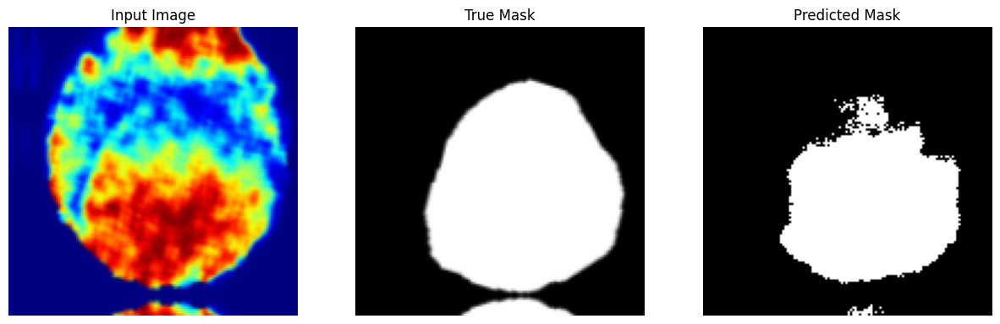


Sample Prediction after epoch 17

6/6 [==============================] - 2s 388ms/step - loss: 0.1859 - accuracy: 0.8627 - val_loss: 0.2380 - val_accuracy: 0.8992
Epoch 18/200
1/1 [==============================] - 0s 153ms/step


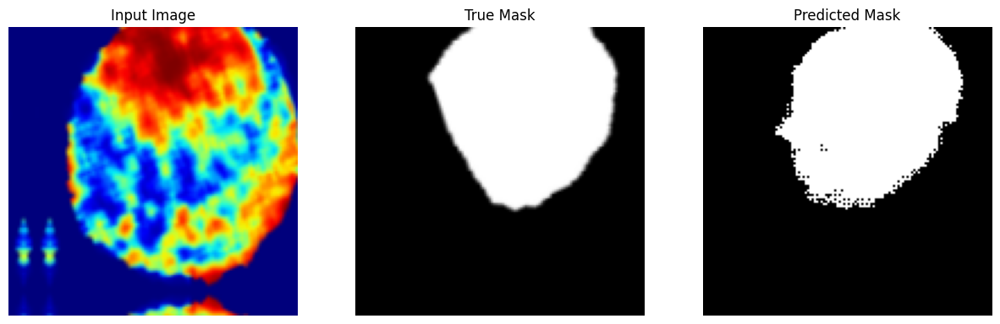


Sample Prediction after epoch 18

6/6 [==============================] - 2s 409ms/step - loss: 0.1863 - accuracy: 0.8633 - val_loss: 0.2334 - val_accuracy: 0.9035
Epoch 19/200
1/1 [==============================] - 0s 157ms/step


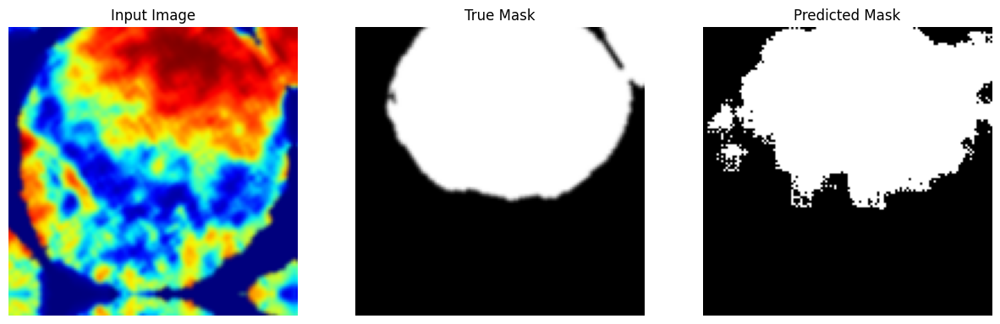


Sample Prediction after epoch 19

6/6 [==============================] - 2s 392ms/step - loss: 0.1948 - accuracy: 0.8598 - val_loss: 0.2088 - val_accuracy: 0.9099
Epoch 20/200
1/1 [==============================] - 0s 141ms/step


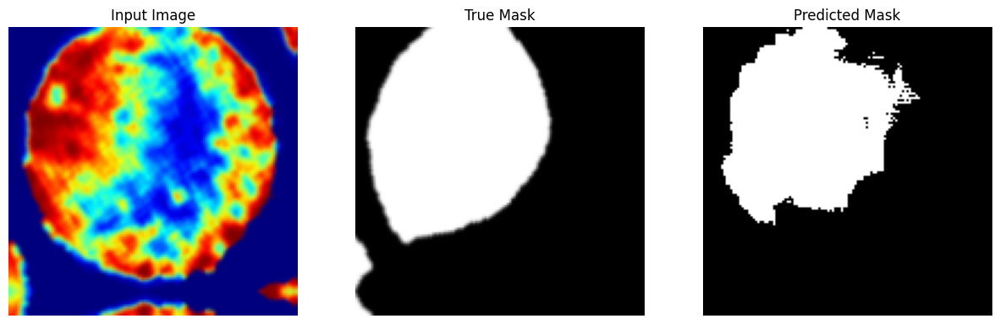


Sample Prediction after epoch 20

6/6 [==============================] - 2s 369ms/step - loss: 0.1756 - accuracy: 0.8695 - val_loss: 0.3038 - val_accuracy: 0.8835
Epoch 21/200
1/1 [==============================] - 0s 158ms/step


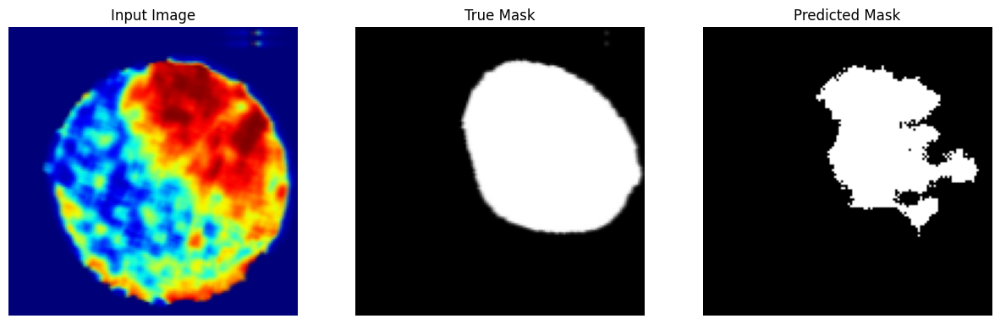


Sample Prediction after epoch 21

6/6 [==============================] - 3s 455ms/step - loss: 0.1692 - accuracy: 0.8740 - val_loss: 0.4354 - val_accuracy: 0.8544
Epoch 22/200
1/1 [==============================] - 0s 141ms/step


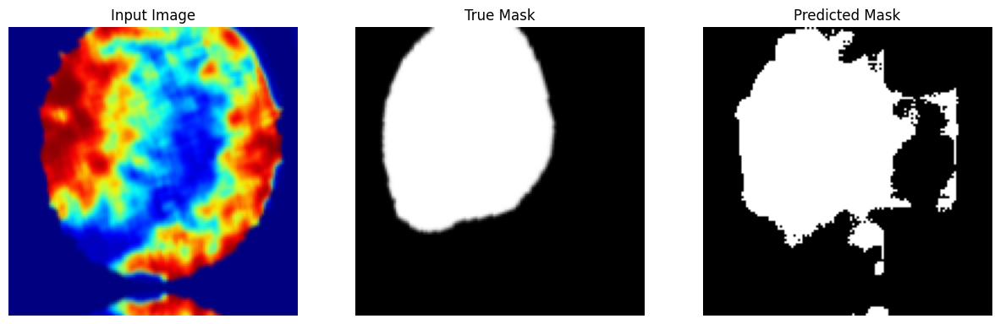


Sample Prediction after epoch 22

6/6 [==============================] - 3s 444ms/step - loss: 0.1867 - accuracy: 0.8638 - val_loss: 0.2708 - val_accuracy: 0.8892
Epoch 23/200
1/1 [==============================] - 0s 166ms/step


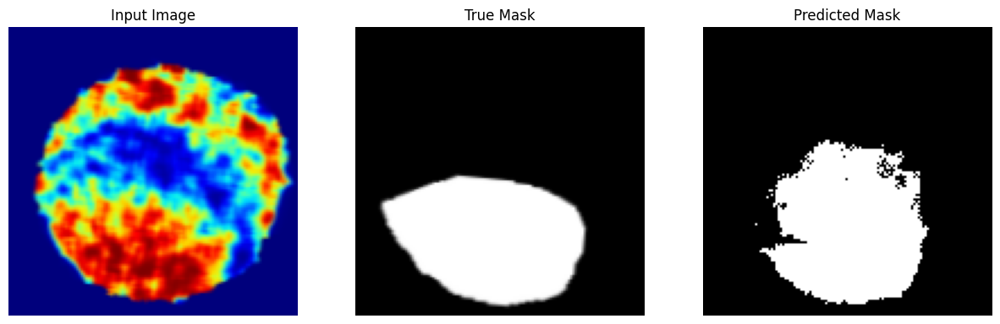


Sample Prediction after epoch 23

6/6 [==============================] - 2s 406ms/step - loss: 0.1581 - accuracy: 0.8694 - val_loss: 0.2771 - val_accuracy: 0.8861
Epoch 24/200
1/1 [==============================] - 0s 142ms/step


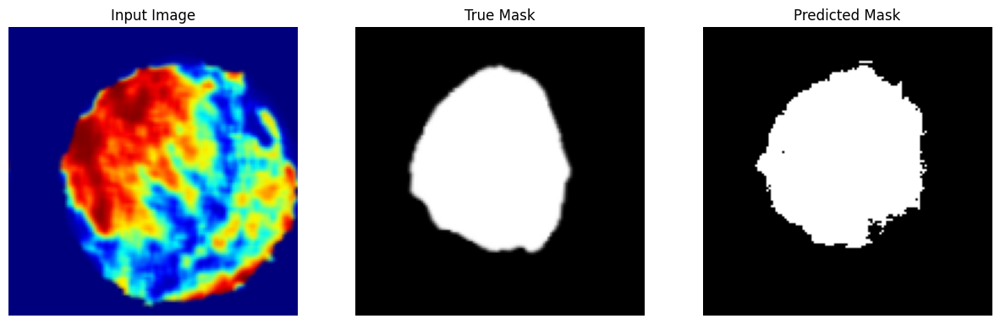


Sample Prediction after epoch 24

6/6 [==============================] - 2s 424ms/step - loss: 0.1824 - accuracy: 0.8649 - val_loss: 0.3542 - val_accuracy: 0.8666
Epoch 25/200
1/1 [==============================] - 0s 158ms/step


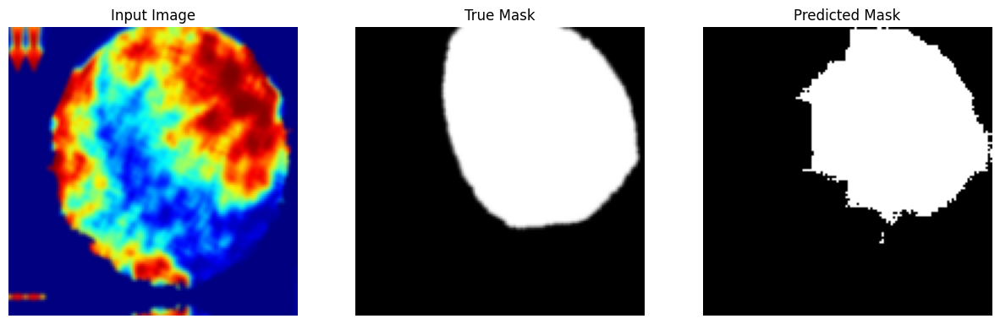


Sample Prediction after epoch 25

6/6 [==============================] - 2s 393ms/step - loss: 0.1828 - accuracy: 0.8678 - val_loss: 0.2403 - val_accuracy: 0.8997
Epoch 26/200
1/1 [==============================] - 0s 126ms/step


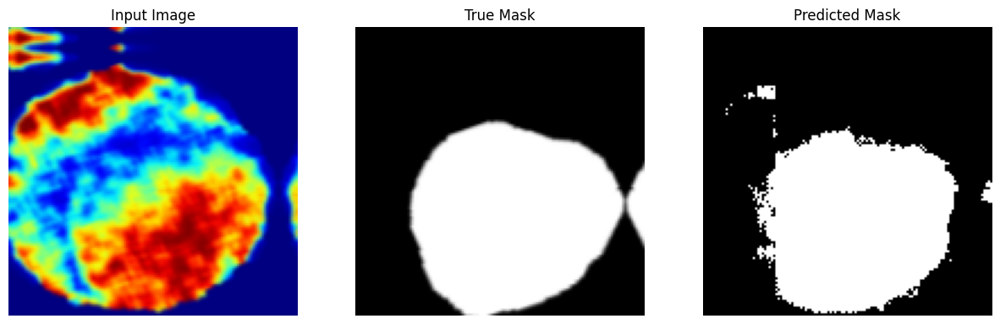


Sample Prediction after epoch 26

6/6 [==============================] - 2s 389ms/step - loss: 0.1674 - accuracy: 0.8709 - val_loss: 0.3223 - val_accuracy: 0.8697
Epoch 27/200
1/1 [==============================] - 0s 142ms/step


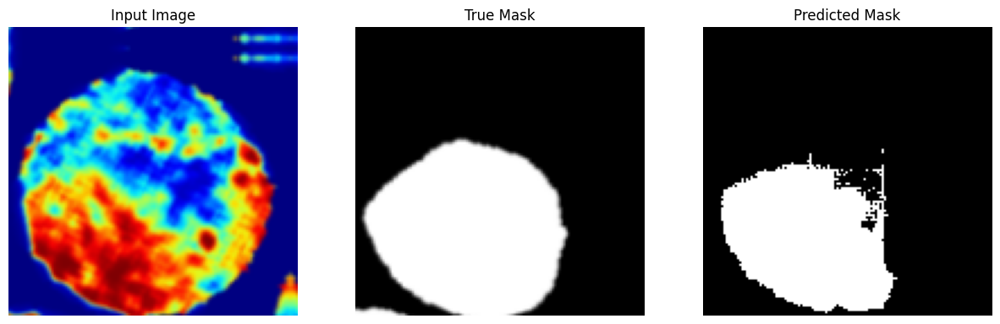


Sample Prediction after epoch 27

6/6 [==============================] - 2s 419ms/step - loss: 0.1718 - accuracy: 0.8684 - val_loss: 0.5944 - val_accuracy: 0.8159
Epoch 28/200
1/1 [==============================] - 0s 157ms/step


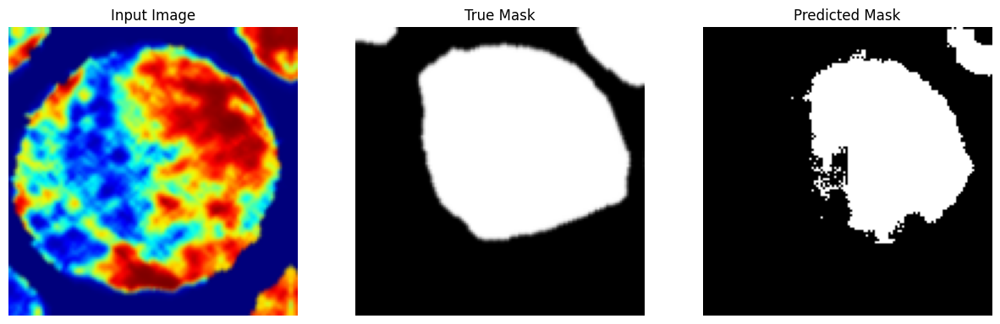


Sample Prediction after epoch 28

6/6 [==============================] - 2s 391ms/step - loss: 0.1741 - accuracy: 0.8654 - val_loss: 0.2997 - val_accuracy: 0.8821
Epoch 29/200
1/1 [==============================] - 0s 159ms/step


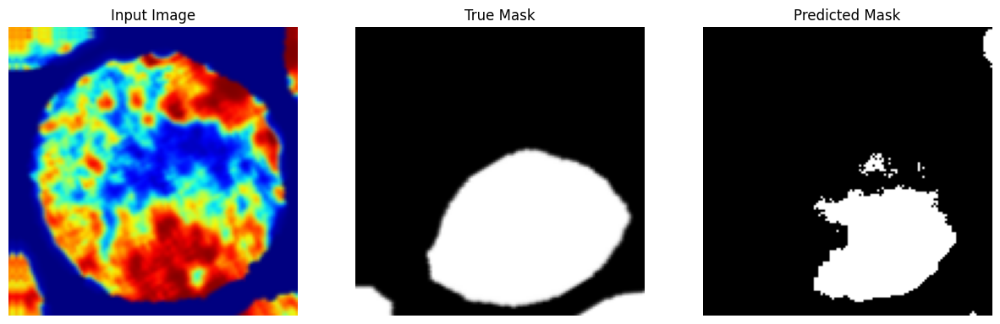


Sample Prediction after epoch 29

6/6 [==============================] - 3s 442ms/step - loss: 0.1686 - accuracy: 0.8682 - val_loss: 0.2859 - val_accuracy: 0.8837
Epoch 30/200
1/1 [==============================] - 0s 126ms/step


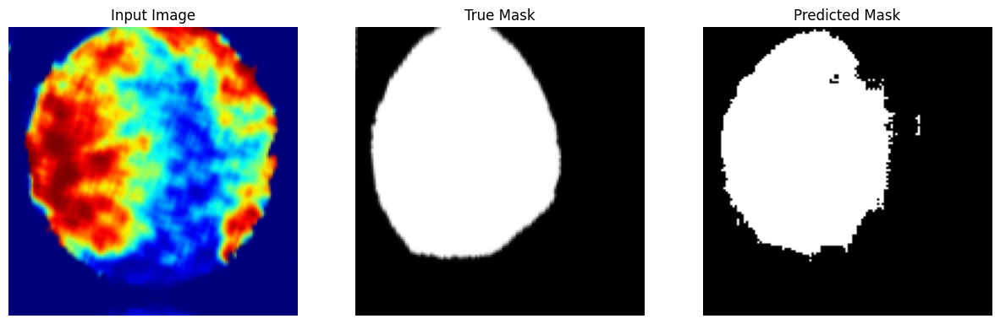


Sample Prediction after epoch 30

6/6 [==============================] - 2s 410ms/step - loss: 0.1682 - accuracy: 0.8701 - val_loss: 0.2846 - val_accuracy: 0.8810
Epoch 31/200
1/1 [==============================] - 0s 156ms/step


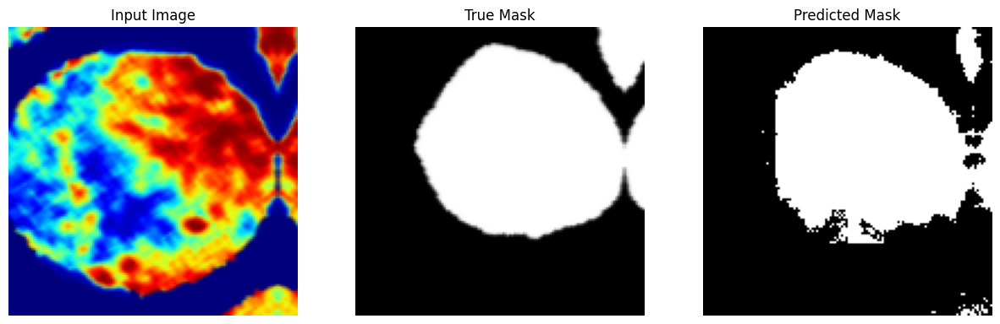


Sample Prediction after epoch 31

6/6 [==============================] - 2s 405ms/step - loss: 0.1680 - accuracy: 0.8717 - val_loss: 0.1990 - val_accuracy: 0.9137
Epoch 32/200
1/1 [==============================] - 0s 142ms/step


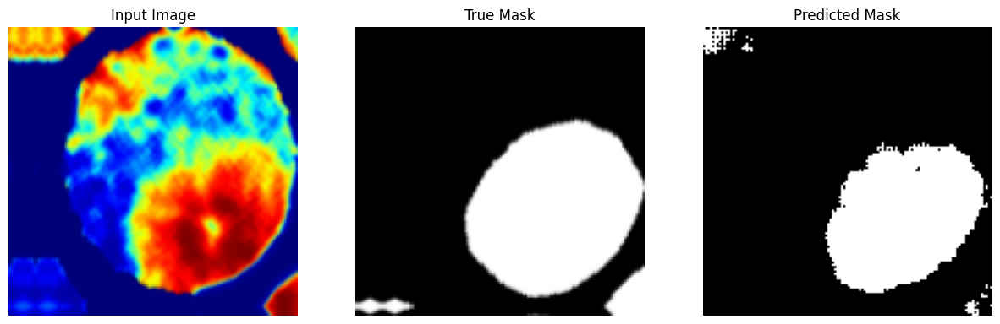


Sample Prediction after epoch 32

6/6 [==============================] - 2s 395ms/step - loss: 0.1754 - accuracy: 0.8637 - val_loss: 0.5235 - val_accuracy: 0.8395
Epoch 33/200
1/1 [==============================] - 0s 173ms/step


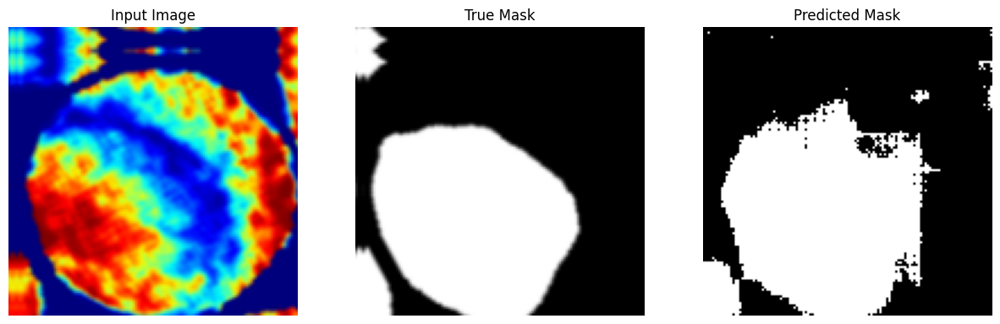


Sample Prediction after epoch 33

6/6 [==============================] - 2s 414ms/step - loss: 0.1799 - accuracy: 0.8660 - val_loss: 0.2064 - val_accuracy: 0.9110
Epoch 34/200
1/1 [==============================] - 0s 144ms/step


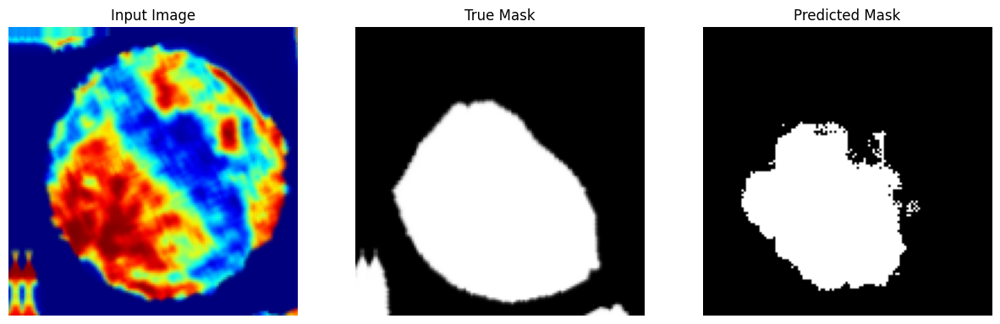


Sample Prediction after epoch 34

6/6 [==============================] - 2s 416ms/step - loss: 0.1849 - accuracy: 0.8574 - val_loss: 0.4063 - val_accuracy: 0.8601
Epoch 35/200
1/1 [==============================] - 0s 128ms/step


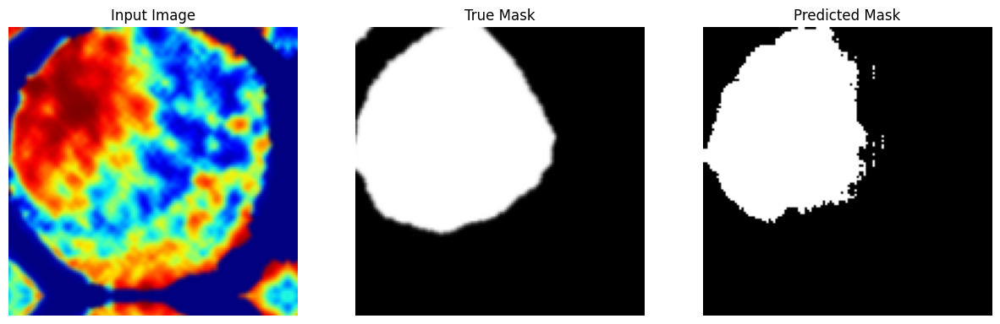


Sample Prediction after epoch 35

6/6 [==============================] - 2s 387ms/step - loss: 0.1668 - accuracy: 0.8710 - val_loss: 0.4155 - val_accuracy: 0.8586
Epoch 36/200
1/1 [==============================] - 0s 141ms/step


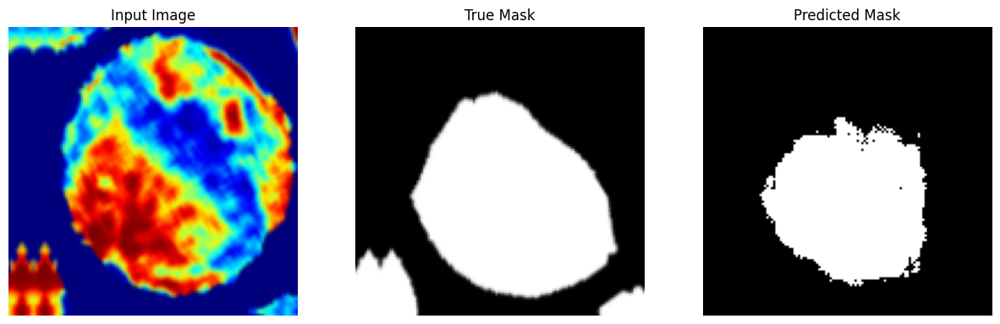


Sample Prediction after epoch 36

6/6 [==============================] - 2s 405ms/step - loss: 0.1669 - accuracy: 0.8648 - val_loss: 0.4249 - val_accuracy: 0.8560
Epoch 37/200
1/1 [==============================] - 0s 142ms/step


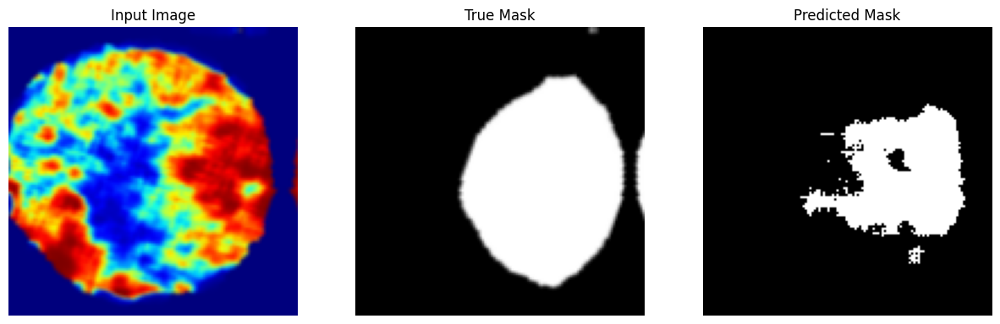


Sample Prediction after epoch 37

6/6 [==============================] - 2s 404ms/step - loss: 0.1687 - accuracy: 0.8703 - val_loss: 0.3409 - val_accuracy: 0.8712
Epoch 38/200
1/1 [==============================] - 0s 141ms/step


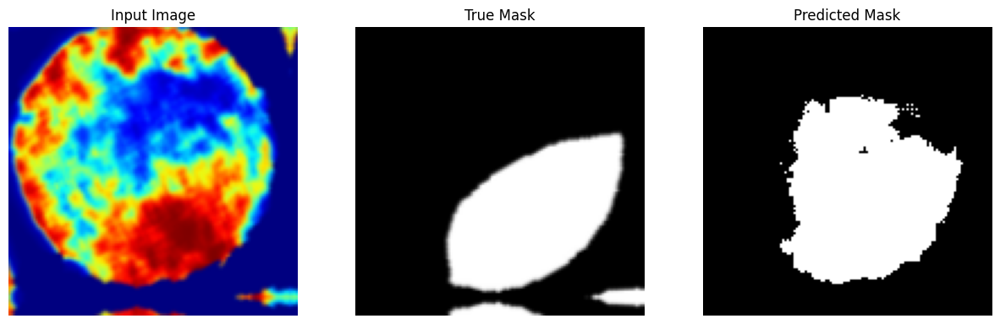


Sample Prediction after epoch 38

6/6 [==============================] - 2s 398ms/step - loss: 0.1625 - accuracy: 0.8653 - val_loss: 0.2816 - val_accuracy: 0.8825
Epoch 39/200
1/1 [==============================] - 0s 173ms/step


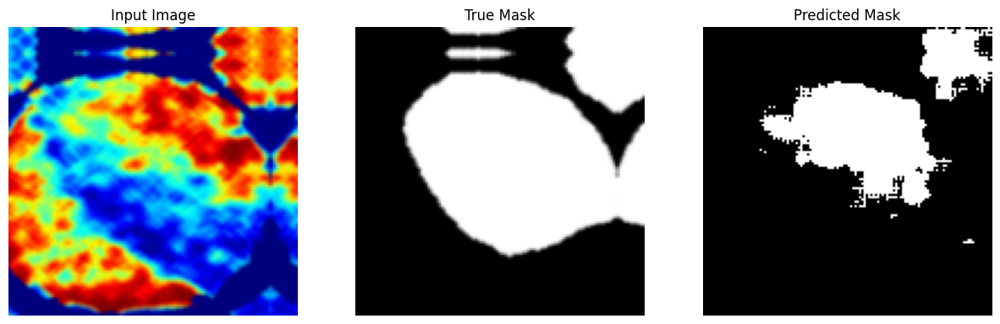


Sample Prediction after epoch 39

6/6 [==============================] - 2s 397ms/step - loss: 0.1587 - accuracy: 0.8751 - val_loss: 0.2901 - val_accuracy: 0.8825
Epoch 40/200
1/1 [==============================] - 0s 157ms/step


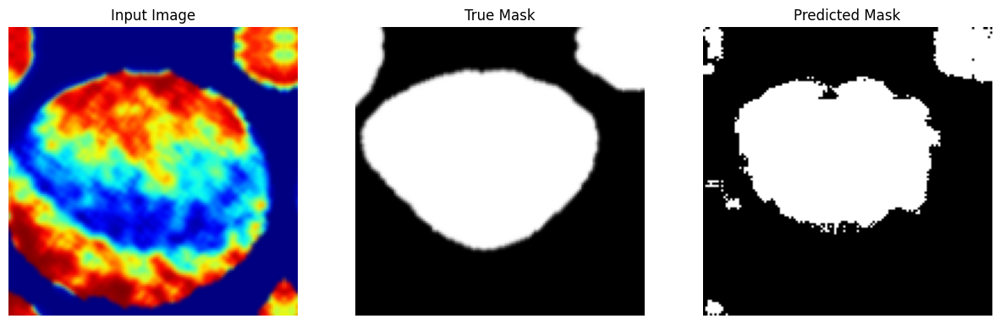


Sample Prediction after epoch 40

6/6 [==============================] - 2s 416ms/step - loss: 0.1548 - accuracy: 0.8732 - val_loss: 0.2819 - val_accuracy: 0.8874
Epoch 41/200
1/1 [==============================] - 0s 145ms/step


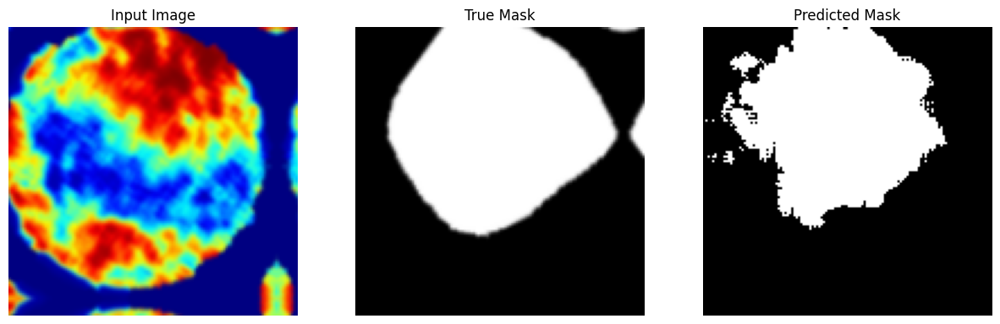


Sample Prediction after epoch 41

6/6 [==============================] - 2s 393ms/step - loss: 0.1592 - accuracy: 0.8757 - val_loss: 0.2530 - val_accuracy: 0.8974
Epoch 42/200
1/1 [==============================] - 0s 142ms/step


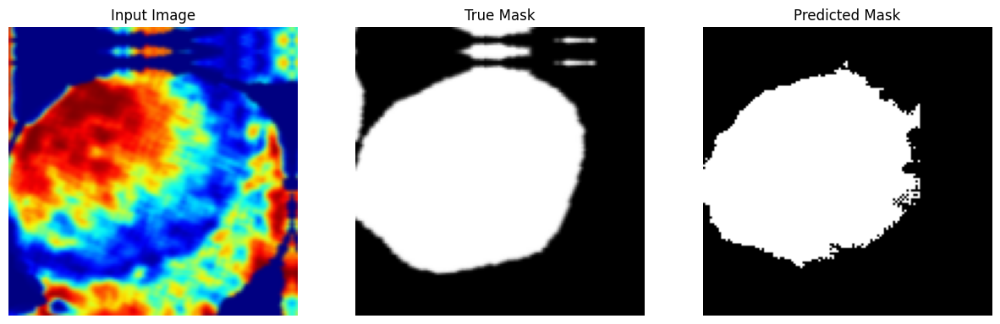


Sample Prediction after epoch 42

6/6 [==============================] - 2s 433ms/step - loss: 0.1607 - accuracy: 0.8718 - val_loss: 0.2416 - val_accuracy: 0.9020
Epoch 43/200
1/1 [==============================] - 0s 142ms/step


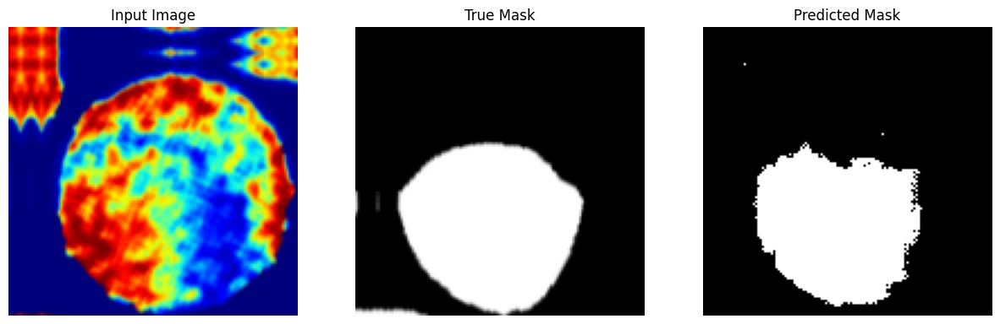


Sample Prediction after epoch 43

6/6 [==============================] - 2s 407ms/step - loss: 0.1634 - accuracy: 0.8680 - val_loss: 0.1975 - val_accuracy: 0.9168
Epoch 44/200
1/1 [==============================] - 0s 141ms/step


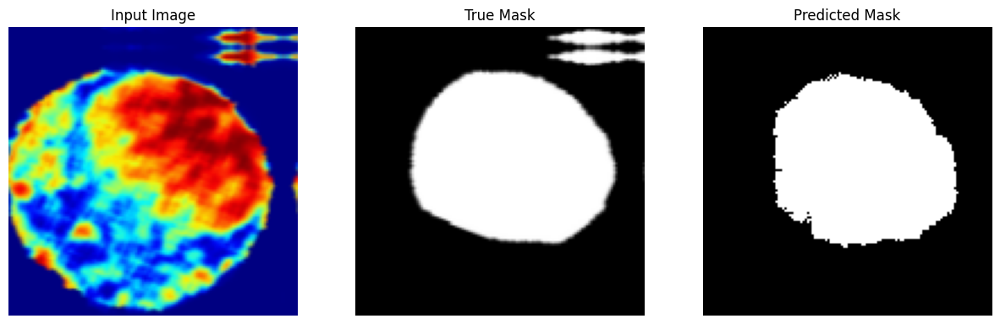


Sample Prediction after epoch 44

6/6 [==============================] - 2s 403ms/step - loss: 0.1558 - accuracy: 0.8755 - val_loss: 0.3165 - val_accuracy: 0.8785
Epoch 45/200
1/1 [==============================] - 0s 157ms/step


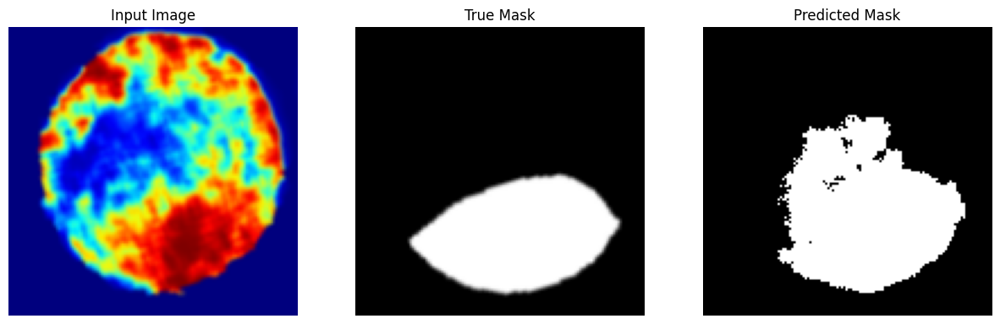


Sample Prediction after epoch 45

6/6 [==============================] - 2s 375ms/step - loss: 0.1566 - accuracy: 0.8682 - val_loss: 0.2378 - val_accuracy: 0.9006
Epoch 46/200
1/1 [==============================] - 0s 141ms/step


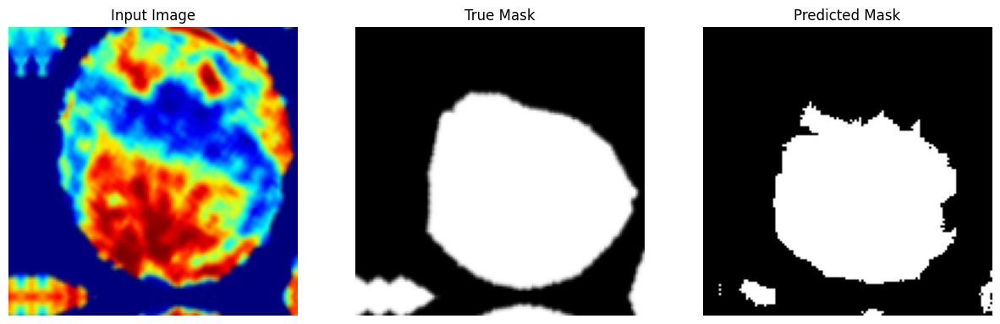


Sample Prediction after epoch 46

6/6 [==============================] - 2s 389ms/step - loss: 0.1473 - accuracy: 0.8811 - val_loss: 0.2290 - val_accuracy: 0.9080
Epoch 47/200
1/1 [==============================] - 0s 146ms/step


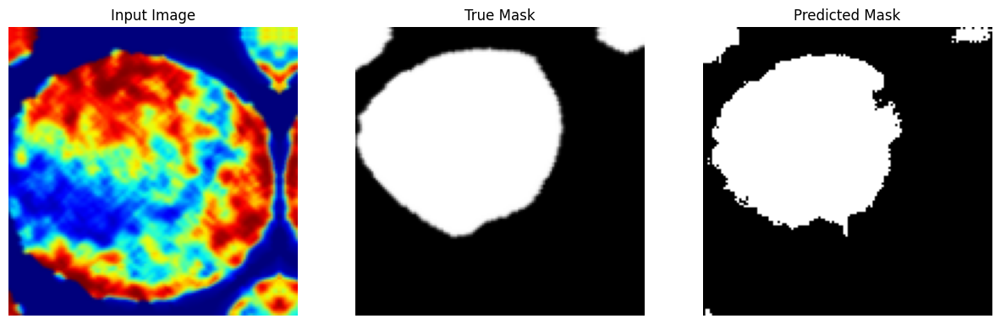


Sample Prediction after epoch 47

6/6 [==============================] - 2s 417ms/step - loss: 0.1640 - accuracy: 0.8698 - val_loss: 0.3673 - val_accuracy: 0.8799
Epoch 48/200
1/1 [==============================] - 0s 140ms/step


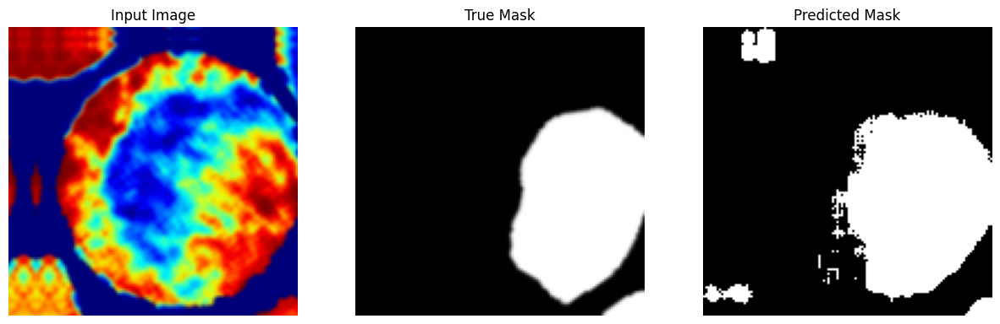


Sample Prediction after epoch 48

6/6 [==============================] - 2s 392ms/step - loss: 0.1519 - accuracy: 0.8797 - val_loss: 0.2019 - val_accuracy: 0.9186
Epoch 49/200
1/1 [==============================] - 0s 142ms/step


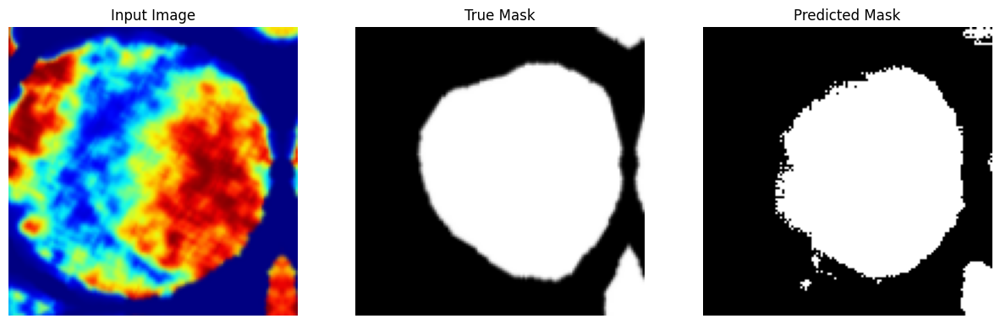


Sample Prediction after epoch 49

6/6 [==============================] - 2s 402ms/step - loss: 0.1678 - accuracy: 0.8628 - val_loss: 0.2234 - val_accuracy: 0.9087
Epoch 50/200
1/1 [==============================] - 0s 146ms/step


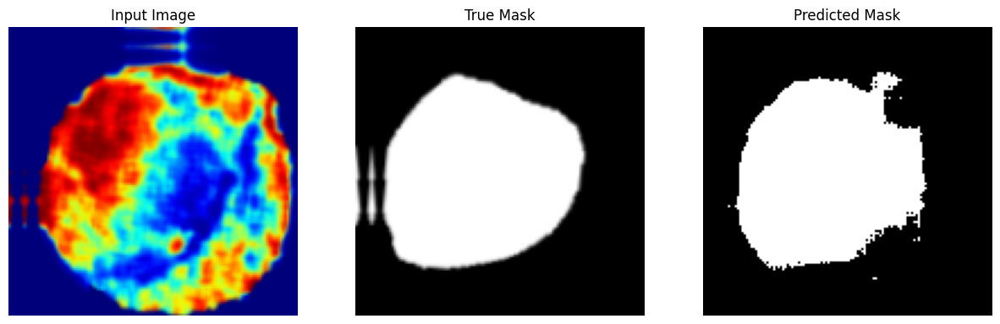


Sample Prediction after epoch 50

6/6 [==============================] - 2s 425ms/step - loss: 0.1506 - accuracy: 0.8771 - val_loss: 0.2241 - val_accuracy: 0.9092
Epoch 51/200
1/1 [==============================] - 0s 146ms/step


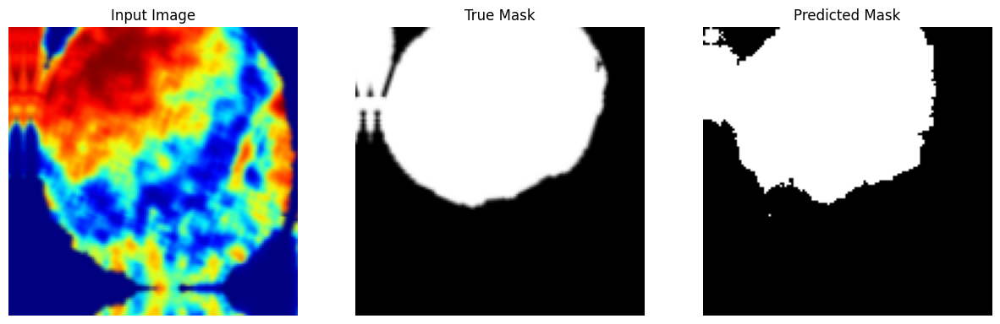


Sample Prediction after epoch 51

6/6 [==============================] - 2s 409ms/step - loss: 0.1588 - accuracy: 0.8809 - val_loss: 0.2549 - val_accuracy: 0.9009
Epoch 52/200
1/1 [==============================] - 0s 144ms/step


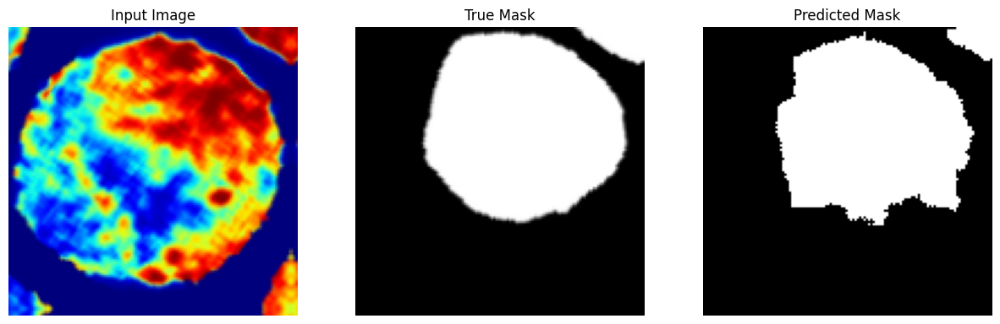


Sample Prediction after epoch 52

6/6 [==============================] - 2s 390ms/step - loss: 0.1639 - accuracy: 0.8682 - val_loss: 0.2812 - val_accuracy: 0.8913
Epoch 53/200
1/1 [==============================] - 0s 141ms/step


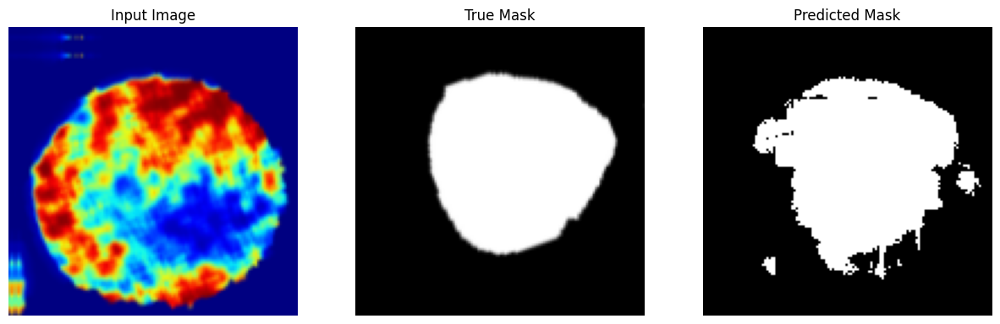


Sample Prediction after epoch 53

6/6 [==============================] - 2s 410ms/step - loss: 0.1554 - accuracy: 0.8803 - val_loss: 0.1819 - val_accuracy: 0.9205
Epoch 54/200
1/1 [==============================] - 0s 158ms/step


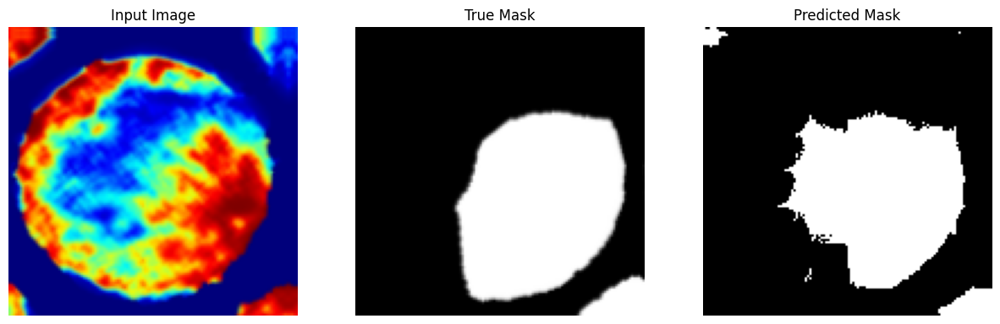


Sample Prediction after epoch 54

6/6 [==============================] - 2s 438ms/step - loss: 0.1555 - accuracy: 0.8679 - val_loss: 0.2508 - val_accuracy: 0.8909
Epoch 55/200
1/1 [==============================] - 0s 142ms/step


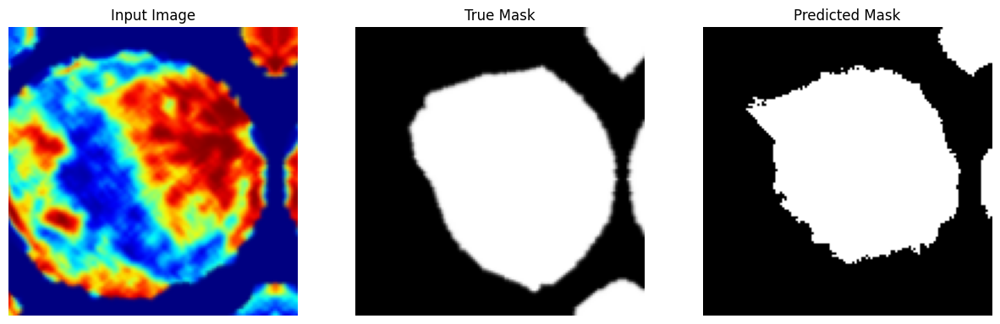


Sample Prediction after epoch 55

6/6 [==============================] - 3s 448ms/step - loss: 0.1654 - accuracy: 0.8685 - val_loss: 0.2342 - val_accuracy: 0.9037
Epoch 56/200
1/1 [==============================] - 0s 157ms/step


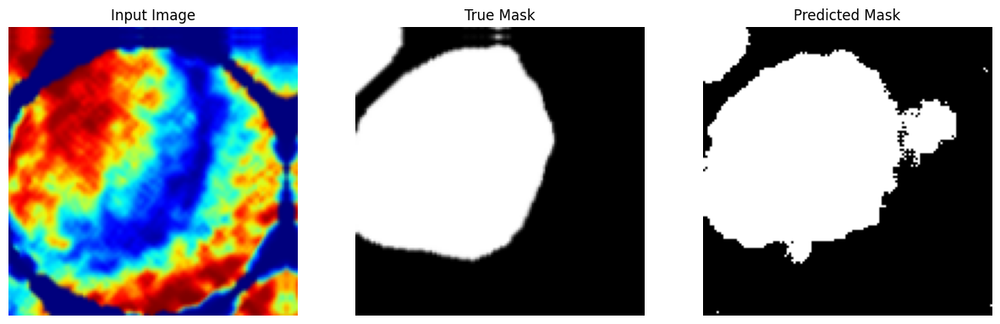


Sample Prediction after epoch 56

6/6 [==============================] - 2s 413ms/step - loss: 0.1497 - accuracy: 0.8788 - val_loss: 0.1954 - val_accuracy: 0.9185
Epoch 57/200
1/1 [==============================] - 0s 174ms/step


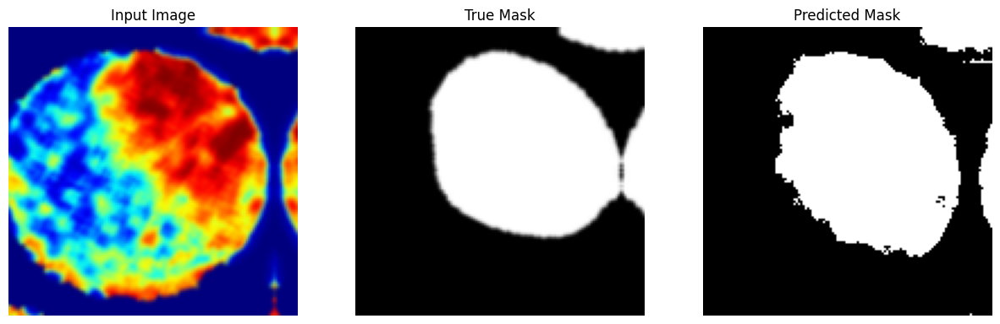


Sample Prediction after epoch 57

6/6 [==============================] - 3s 462ms/step - loss: 0.1497 - accuracy: 0.8728 - val_loss: 0.2040 - val_accuracy: 0.9150
Epoch 58/200
1/1 [==============================] - 0s 175ms/step


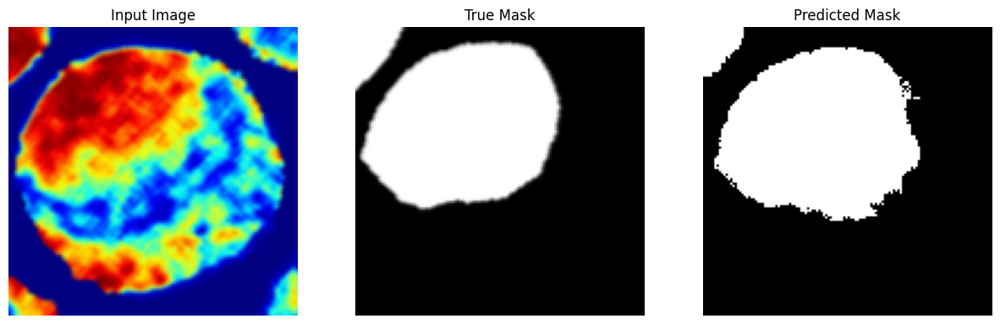


Sample Prediction after epoch 58

6/6 [==============================] - 3s 485ms/step - loss: 0.1470 - accuracy: 0.8814 - val_loss: 0.2123 - val_accuracy: 0.9134
Epoch 59/200
1/1 [==============================] - 0s 142ms/step


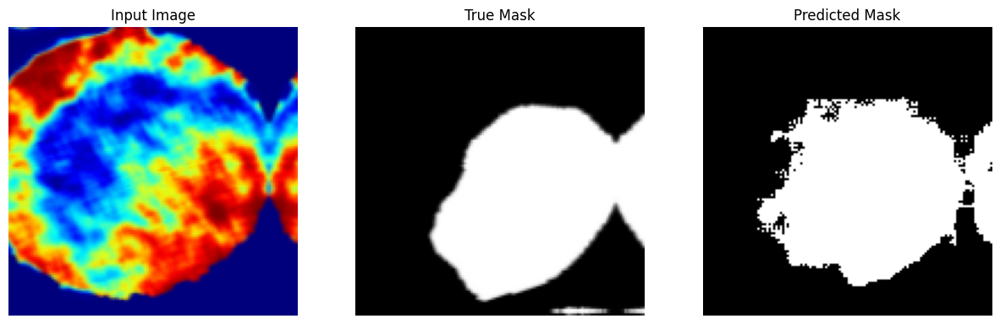


Sample Prediction after epoch 59

6/6 [==============================] - 3s 439ms/step - loss: 0.1474 - accuracy: 0.8795 - val_loss: 0.2104 - val_accuracy: 0.9138
Epoch 60/200
1/1 [==============================] - 0s 157ms/step


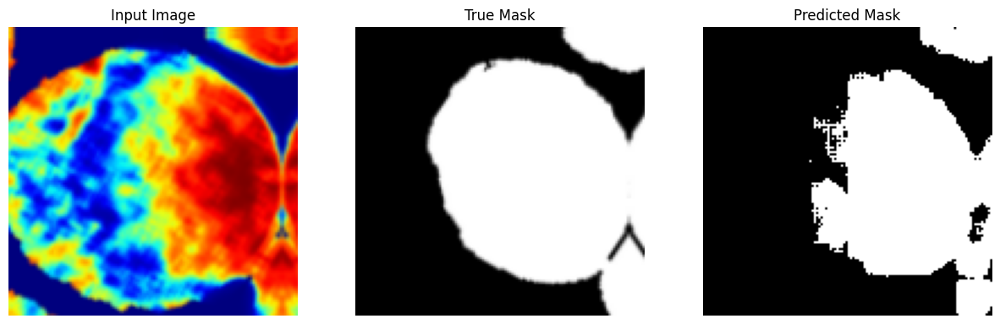


Sample Prediction after epoch 60

6/6 [==============================] - 2s 392ms/step - loss: 0.1635 - accuracy: 0.8706 - val_loss: 0.5073 - val_accuracy: 0.8422
Epoch 61/200
1/1 [==============================] - 0s 130ms/step


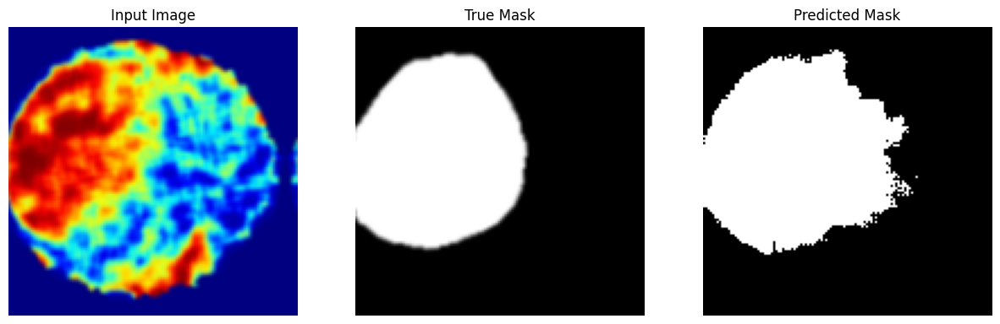


Sample Prediction after epoch 61

6/6 [==============================] - 3s 459ms/step - loss: 0.1598 - accuracy: 0.8656 - val_loss: 0.2302 - val_accuracy: 0.9077
Epoch 62/200
1/1 [==============================] - 0s 145ms/step


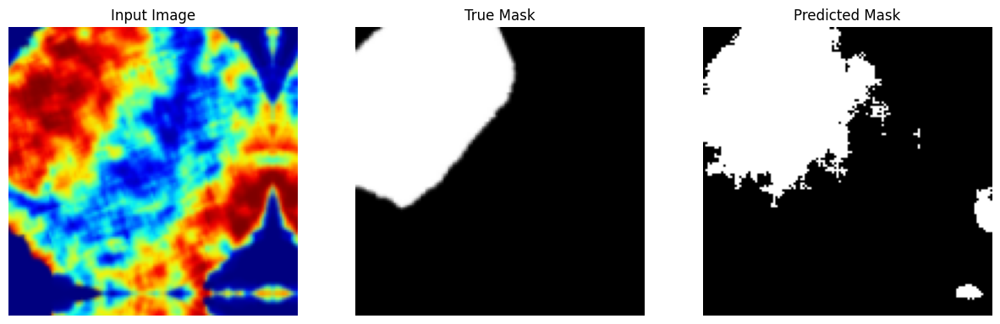


Sample Prediction after epoch 62

6/6 [==============================] - 2s 405ms/step - loss: 0.1497 - accuracy: 0.8772 - val_loss: 0.3185 - val_accuracy: 0.8842
Epoch 63/200
1/1 [==============================] - 0s 165ms/step


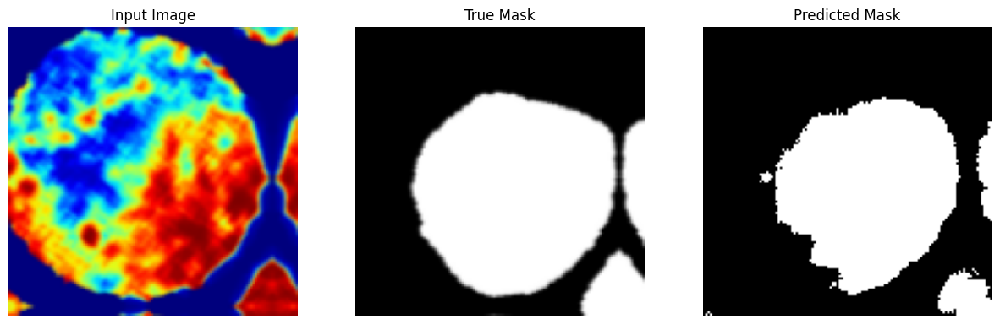


Sample Prediction after epoch 63

6/6 [==============================] - 2s 402ms/step - loss: 0.1593 - accuracy: 0.8710 - val_loss: 0.2594 - val_accuracy: 0.9022
Epoch 64/200
1/1 [==============================] - 0s 142ms/step


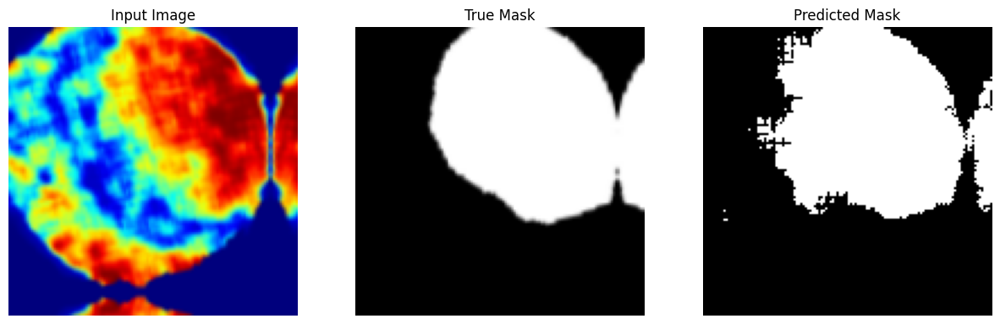


Sample Prediction after epoch 64

6/6 [==============================] - 3s 452ms/step - loss: 0.1545 - accuracy: 0.8715 - val_loss: 0.2672 - val_accuracy: 0.8933
Epoch 65/200
1/1 [==============================] - 0s 158ms/step


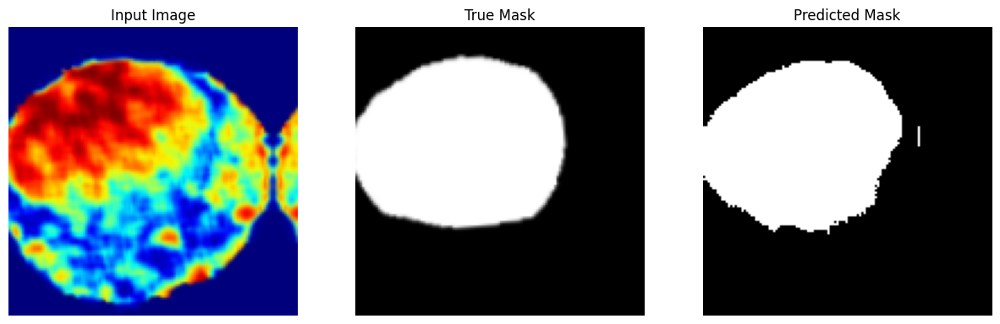


Sample Prediction after epoch 65

6/6 [==============================] - 3s 485ms/step - loss: 0.1469 - accuracy: 0.8804 - val_loss: 0.2460 - val_accuracy: 0.8982
Epoch 66/200
1/1 [==============================] - 0s 158ms/step


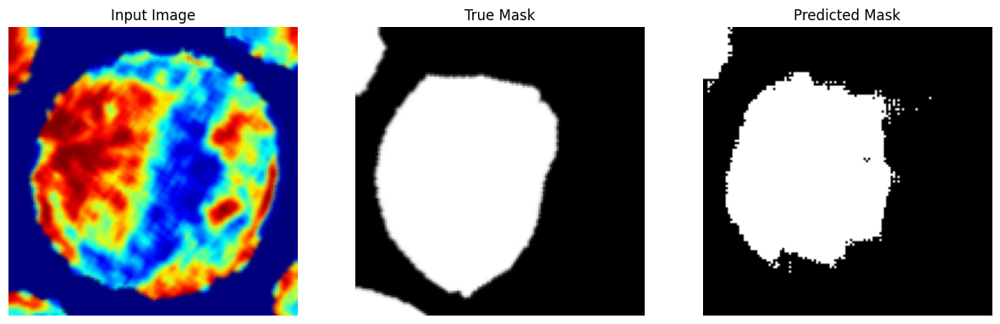


Sample Prediction after epoch 66

6/6 [==============================] - 2s 419ms/step - loss: 0.1472 - accuracy: 0.8749 - val_loss: 0.2314 - val_accuracy: 0.9059
Epoch 67/200
1/1 [==============================] - 0s 141ms/step


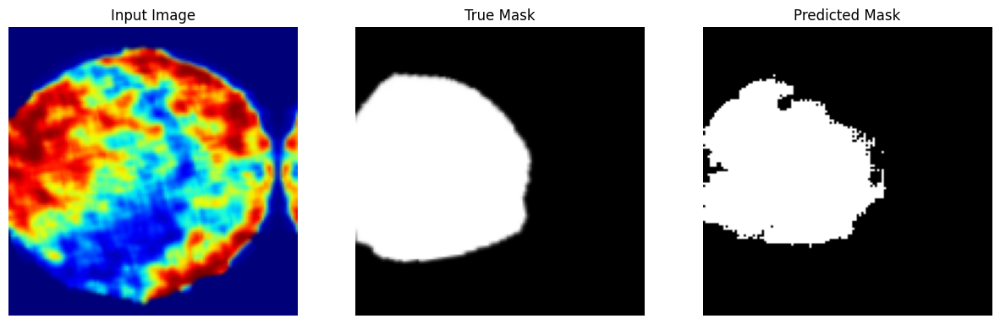


Sample Prediction after epoch 67

6/6 [==============================] - 2s 405ms/step - loss: 0.1517 - accuracy: 0.8774 - val_loss: 0.3074 - val_accuracy: 0.8857
Epoch 68/200
1/1 [==============================] - 0s 158ms/step


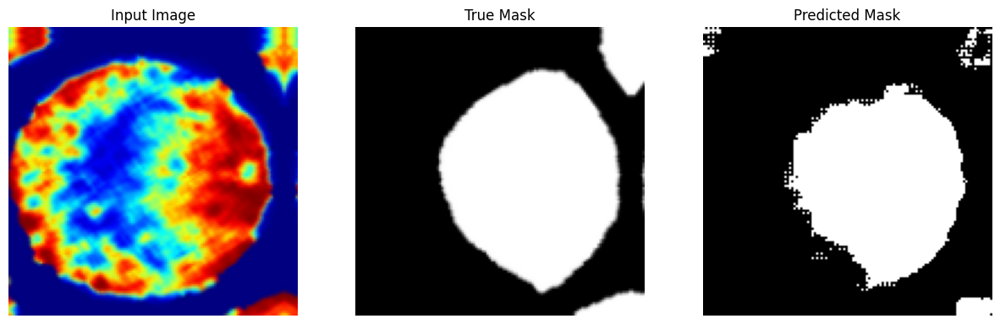


Sample Prediction after epoch 68

6/6 [==============================] - 2s 415ms/step - loss: 0.1482 - accuracy: 0.8723 - val_loss: 0.2794 - val_accuracy: 0.8863
Epoch 69/200
1/1 [==============================] - 0s 142ms/step


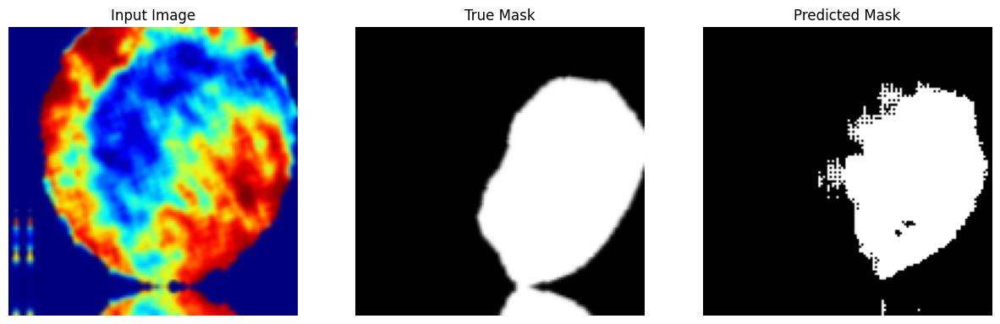


Sample Prediction after epoch 69

6/6 [==============================] - 2s 421ms/step - loss: 0.1455 - accuracy: 0.8854 - val_loss: 0.3347 - val_accuracy: 0.8769
Epoch 70/200
1/1 [==============================] - 0s 158ms/step


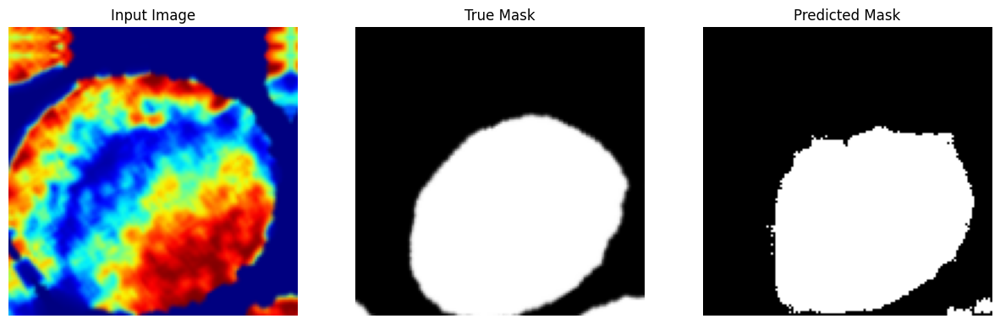


Sample Prediction after epoch 70

6/6 [==============================] - 2s 425ms/step - loss: 0.1379 - accuracy: 0.8794 - val_loss: 0.2113 - val_accuracy: 0.9149
Epoch 71/200
1/1 [==============================] - 0s 127ms/step


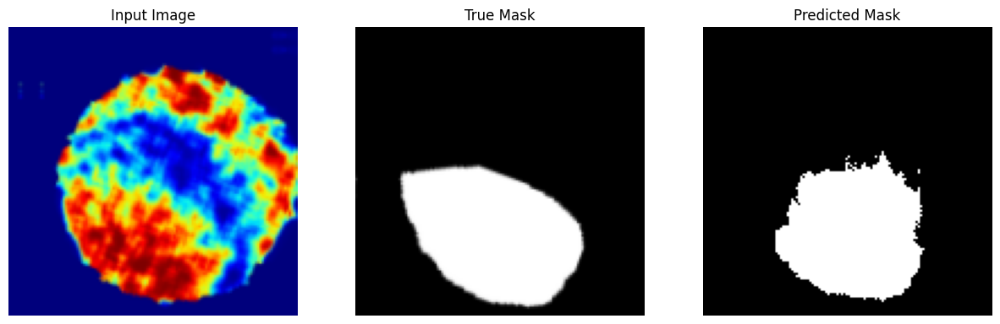


Sample Prediction after epoch 71

6/6 [==============================] - 2s 436ms/step - loss: 0.1537 - accuracy: 0.8803 - val_loss: 0.2789 - val_accuracy: 0.8979
Epoch 72/200
1/1 [==============================] - 0s 157ms/step


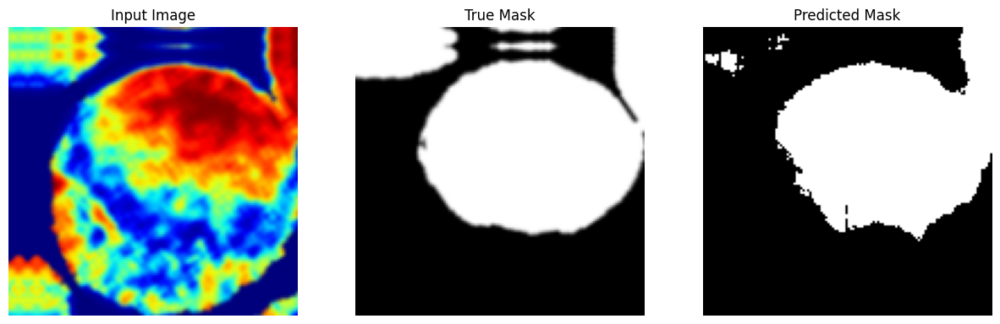


Sample Prediction after epoch 72

6/6 [==============================] - 2s 437ms/step - loss: 0.1619 - accuracy: 0.8693 - val_loss: 0.2055 - val_accuracy: 0.9159
Epoch 73/200
1/1 [==============================] - 0s 142ms/step


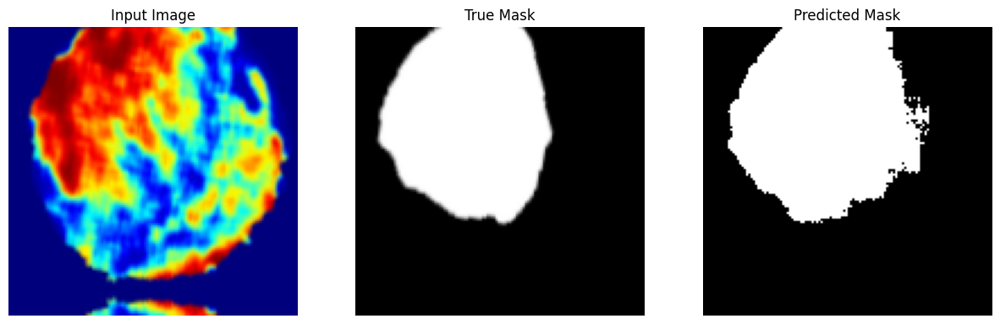


Sample Prediction after epoch 73

6/6 [==============================] - 2s 411ms/step - loss: 0.1341 - accuracy: 0.8858 - val_loss: 0.2327 - val_accuracy: 0.9048
Epoch 74/200
1/1 [==============================] - 0s 150ms/step


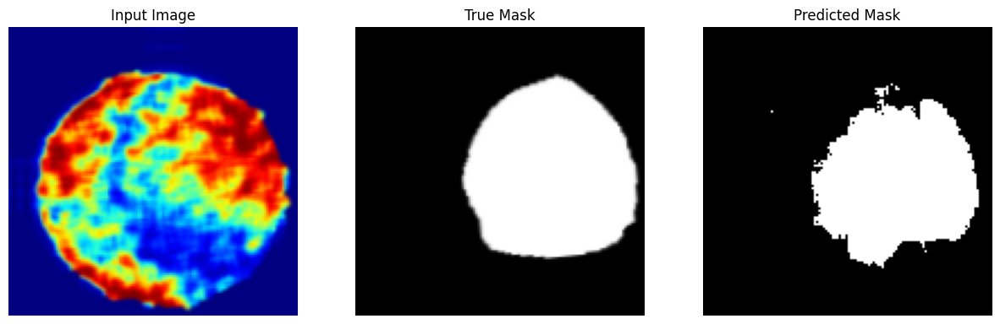


Sample Prediction after epoch 74

6/6 [==============================] - 2s 404ms/step - loss: 0.1413 - accuracy: 0.8807 - val_loss: 0.2473 - val_accuracy: 0.8982
Epoch 75/200
1/1 [==============================] - 0s 157ms/step


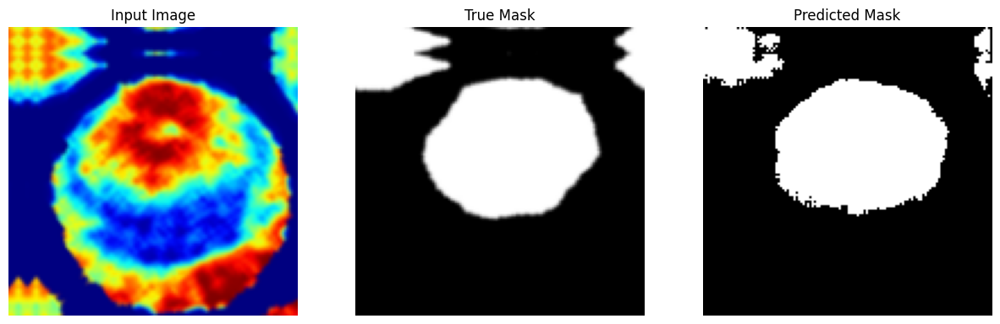


Sample Prediction after epoch 75

6/6 [==============================] - 2s 429ms/step - loss: 0.1524 - accuracy: 0.8717 - val_loss: 0.2750 - val_accuracy: 0.8943
Epoch 76/200
1/1 [==============================] - 0s 141ms/step


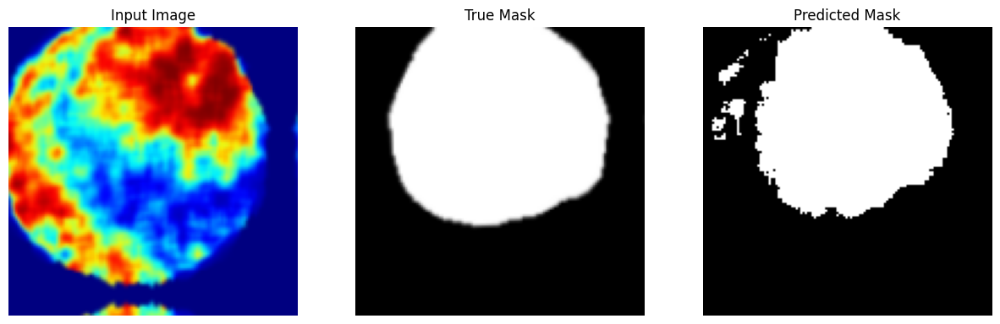


Sample Prediction after epoch 76

6/6 [==============================] - 2s 406ms/step - loss: 0.1429 - accuracy: 0.8823 - val_loss: 0.2801 - val_accuracy: 0.8946
Epoch 77/200
1/1 [==============================] - 0s 153ms/step


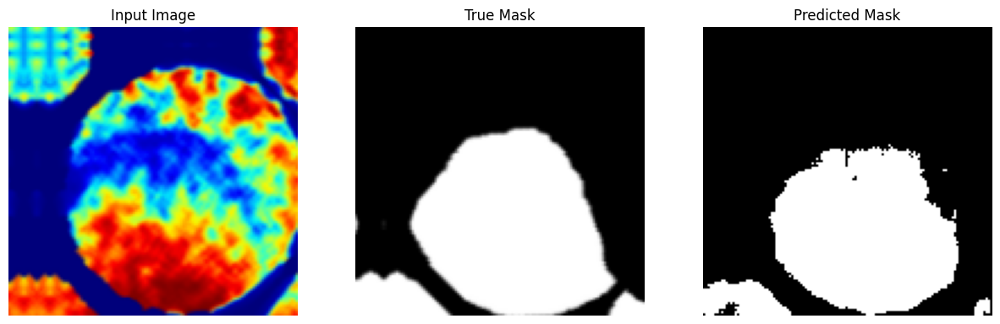


Sample Prediction after epoch 77

6/6 [==============================] - 2s 400ms/step - loss: 0.1363 - accuracy: 0.8826 - val_loss: 0.2089 - val_accuracy: 0.9150
Epoch 78/200
1/1 [==============================] - 0s 158ms/step


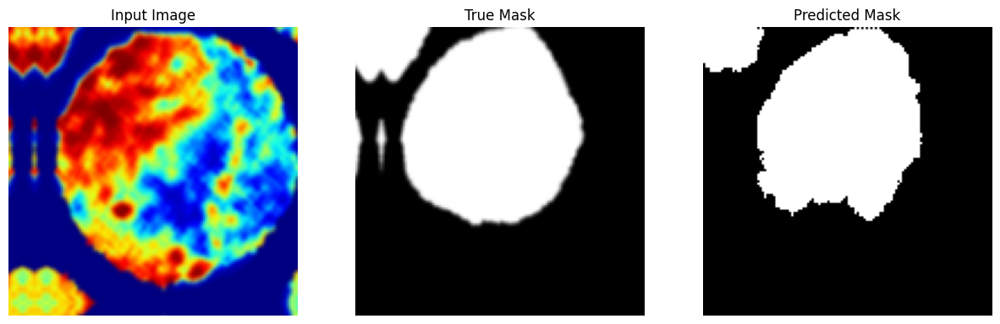


Sample Prediction after epoch 78

6/6 [==============================] - 2s 423ms/step - loss: 0.1411 - accuracy: 0.8812 - val_loss: 0.2260 - val_accuracy: 0.9092
Epoch 79/200
1/1 [==============================] - 0s 142ms/step


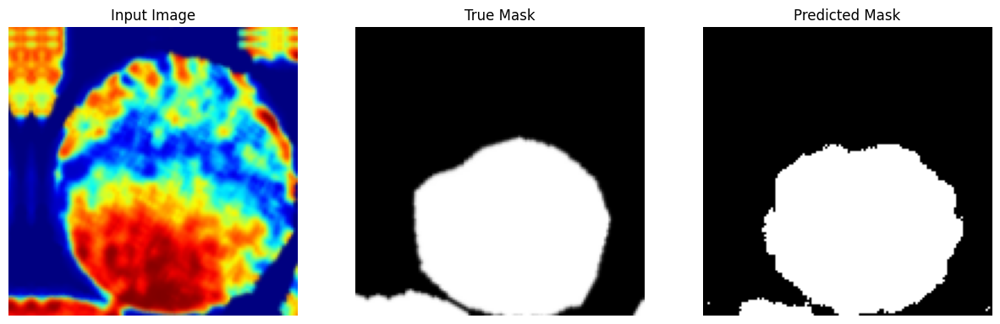


Sample Prediction after epoch 79

6/6 [==============================] - 2s 429ms/step - loss: 0.1288 - accuracy: 0.8876 - val_loss: 0.2266 - val_accuracy: 0.9093
Epoch 80/200
1/1 [==============================] - 0s 133ms/step


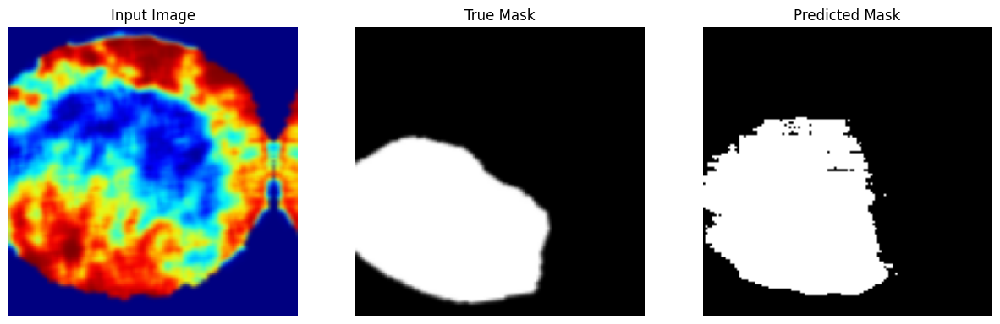


Sample Prediction after epoch 80

6/6 [==============================] - 2s 383ms/step - loss: 0.1551 - accuracy: 0.8759 - val_loss: 0.2183 - val_accuracy: 0.9113
Epoch 81/200
1/1 [==============================] - 0s 143ms/step


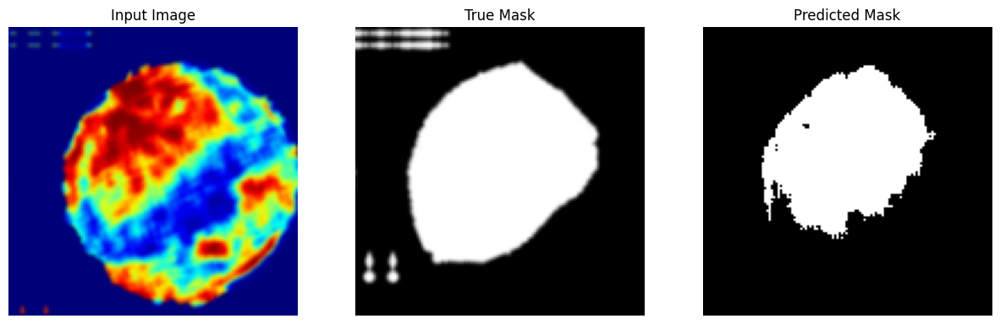


Sample Prediction after epoch 81

6/6 [==============================] - 2s 420ms/step - loss: 0.1410 - accuracy: 0.8779 - val_loss: 0.3022 - val_accuracy: 0.8871
Epoch 82/200
1/1 [==============================] - 0s 142ms/step


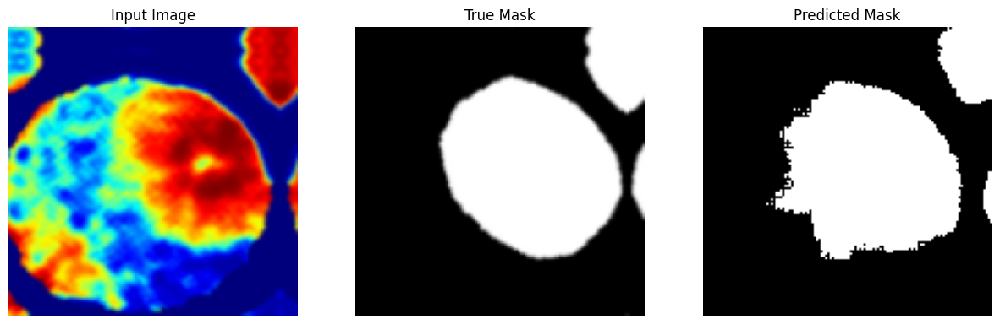


Sample Prediction after epoch 82

6/6 [==============================] - 3s 448ms/step - loss: 0.1477 - accuracy: 0.8740 - val_loss: 0.2883 - val_accuracy: 0.8912
Epoch 83/200
1/1 [==============================] - 0s 140ms/step


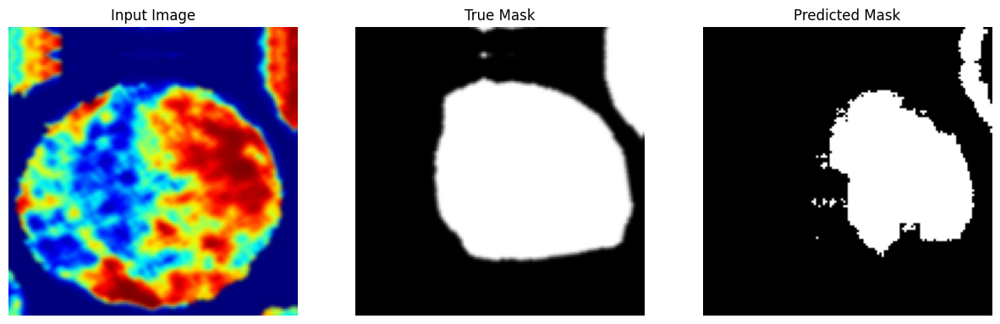


Sample Prediction after epoch 83

6/6 [==============================] - 2s 395ms/step - loss: 0.1558 - accuracy: 0.8745 - val_loss: 0.4923 - val_accuracy: 0.8452
Epoch 84/200
1/1 [==============================] - 0s 142ms/step


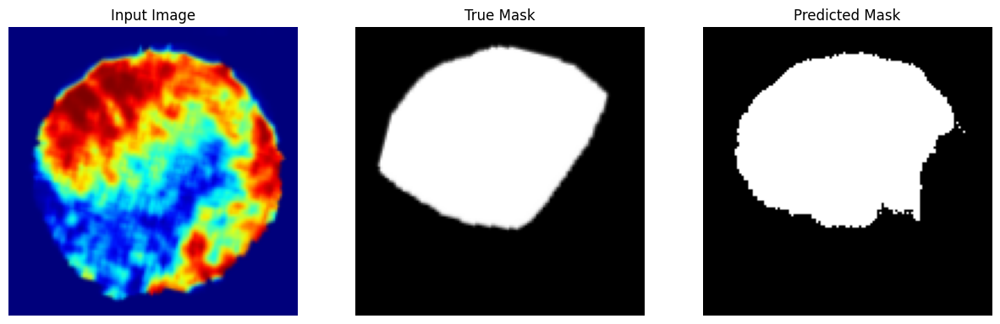


Sample Prediction after epoch 84

6/6 [==============================] - 2s 410ms/step - loss: 0.1452 - accuracy: 0.8761 - val_loss: 0.2197 - val_accuracy: 0.9133
Epoch 85/200
1/1 [==============================] - 0s 158ms/step


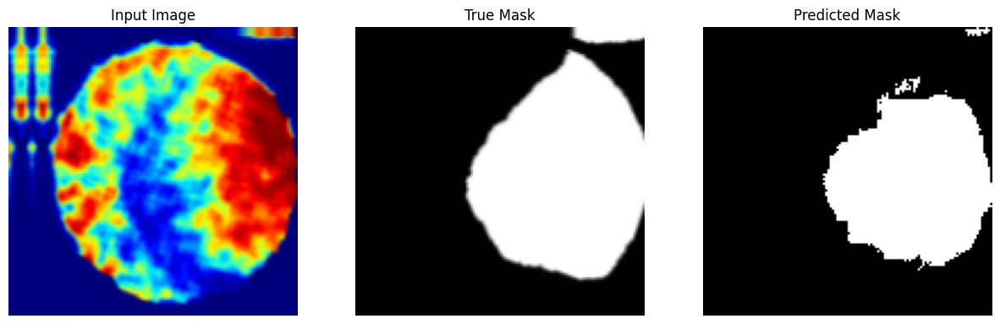


Sample Prediction after epoch 85

6/6 [==============================] - 2s 452ms/step - loss: 0.1504 - accuracy: 0.8736 - val_loss: 0.3469 - val_accuracy: 0.8769
Epoch 86/200
1/1 [==============================] - 0s 142ms/step


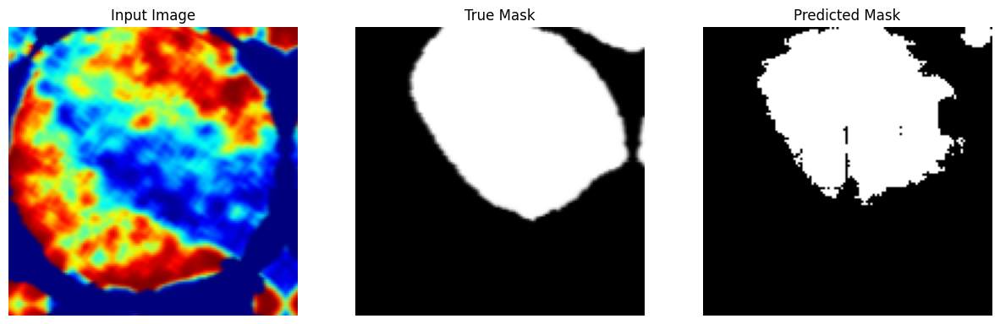


Sample Prediction after epoch 86

6/6 [==============================] - 3s 480ms/step - loss: 0.1408 - accuracy: 0.8796 - val_loss: 0.3263 - val_accuracy: 0.8787
Epoch 87/200
1/1 [==============================] - 0s 158ms/step


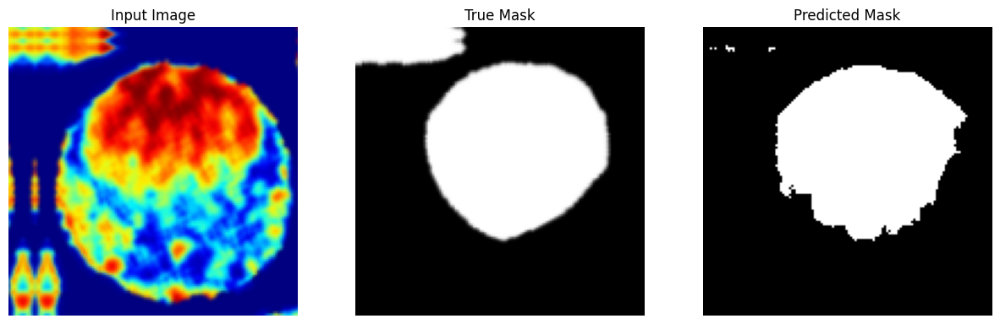


Sample Prediction after epoch 87

6/6 [==============================] - 2s 412ms/step - loss: 0.1376 - accuracy: 0.8863 - val_loss: 0.2353 - val_accuracy: 0.9068
Epoch 88/200
1/1 [==============================] - 0s 148ms/step


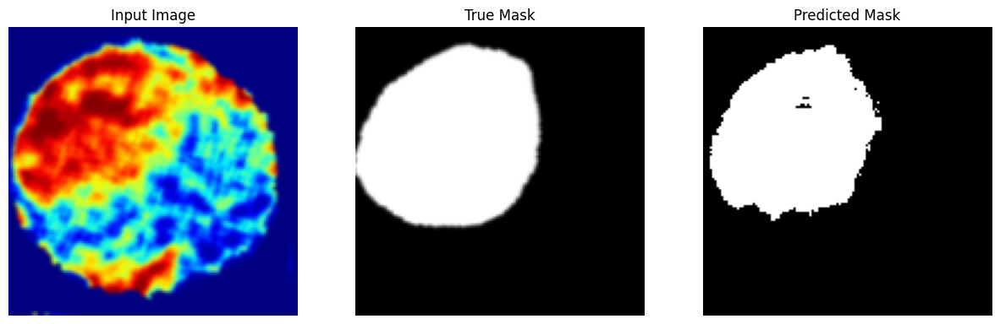


Sample Prediction after epoch 88

6/6 [==============================] - 2s 414ms/step - loss: 0.1522 - accuracy: 0.8744 - val_loss: 0.5053 - val_accuracy: 0.8433
Epoch 89/200
1/1 [==============================] - 0s 159ms/step


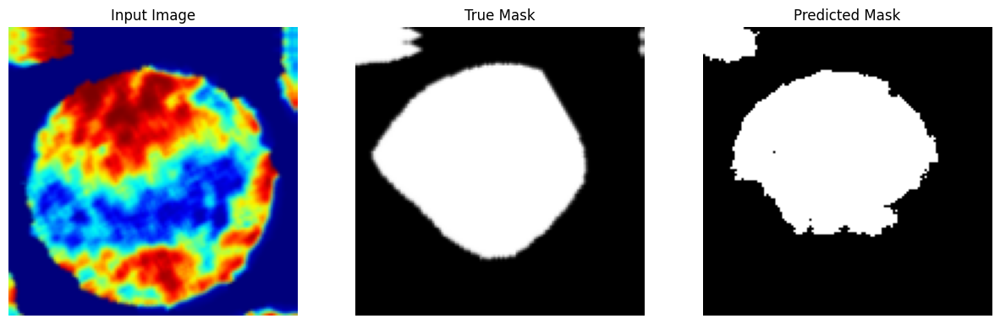


Sample Prediction after epoch 89

6/6 [==============================] - 2s 422ms/step - loss: 0.1387 - accuracy: 0.8822 - val_loss: 0.2937 - val_accuracy: 0.8873
Epoch 90/200
1/1 [==============================] - 0s 158ms/step


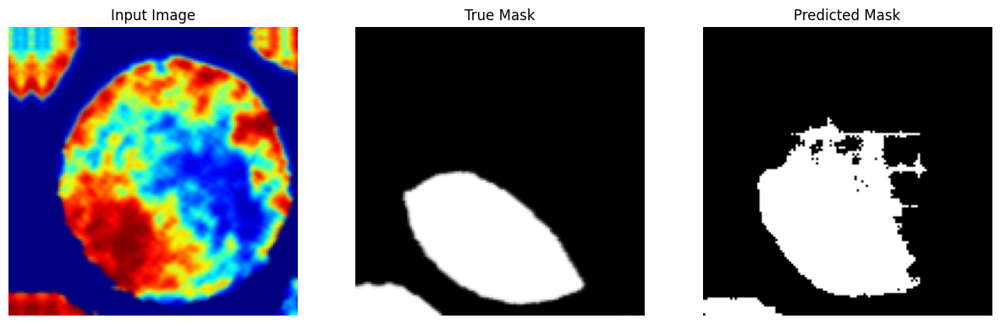


Sample Prediction after epoch 90

6/6 [==============================] - 2s 416ms/step - loss: 0.1490 - accuracy: 0.8760 - val_loss: 0.3206 - val_accuracy: 0.8848
Epoch 91/200
1/1 [==============================] - 0s 142ms/step


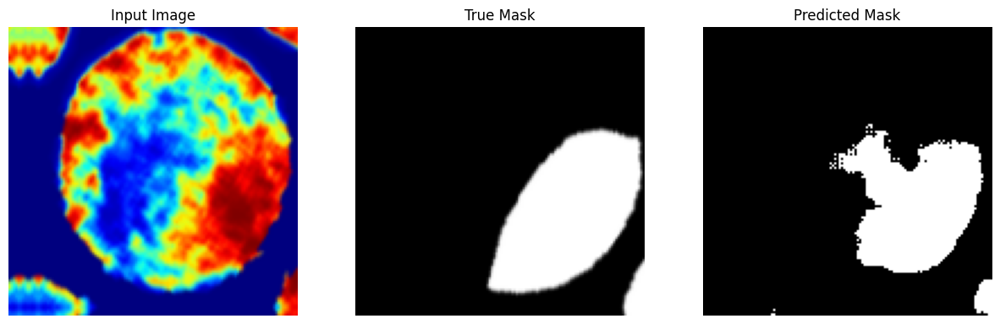


Sample Prediction after epoch 91

6/6 [==============================] - 2s 435ms/step - loss: 0.1242 - accuracy: 0.8889 - val_loss: 0.3326 - val_accuracy: 0.8826
Epoch 92/200
1/1 [==============================] - 0s 143ms/step


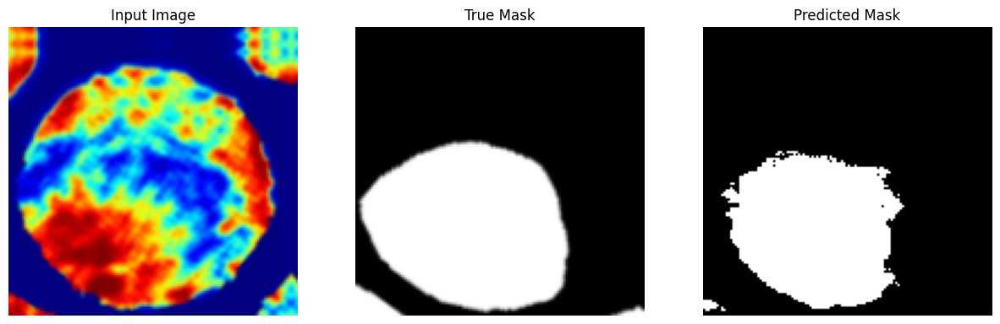


Sample Prediction after epoch 92

6/6 [==============================] - 2s 447ms/step - loss: 0.1262 - accuracy: 0.8887 - val_loss: 0.2973 - val_accuracy: 0.8920
Epoch 93/200
1/1 [==============================] - 0s 142ms/step


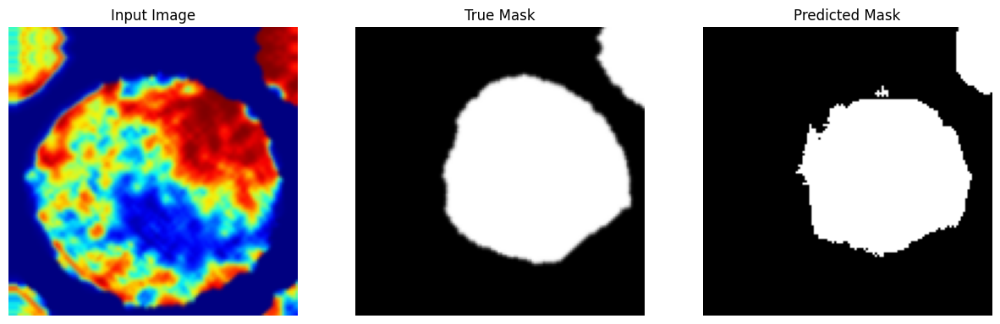


Sample Prediction after epoch 93

6/6 [==============================] - 2s 452ms/step - loss: 0.1444 - accuracy: 0.8839 - val_loss: 0.2963 - val_accuracy: 0.8887
Epoch 94/200
1/1 [==============================] - 0s 158ms/step


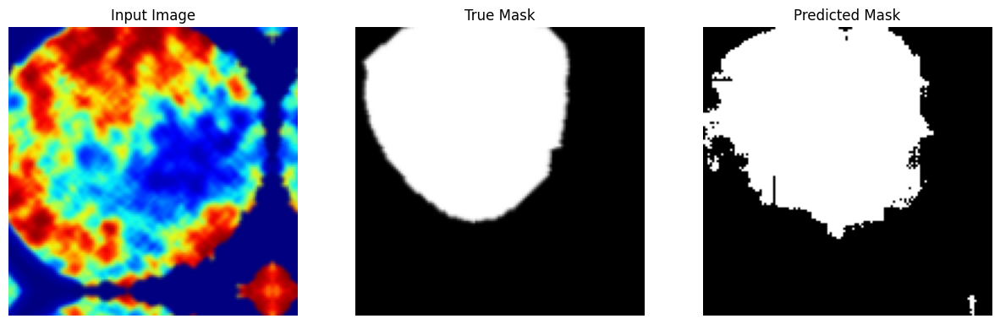


Sample Prediction after epoch 94

6/6 [==============================] - 2s 416ms/step - loss: 0.1394 - accuracy: 0.8831 - val_loss: 0.1975 - val_accuracy: 0.9156
Epoch 95/200
1/1 [==============================] - 0s 159ms/step


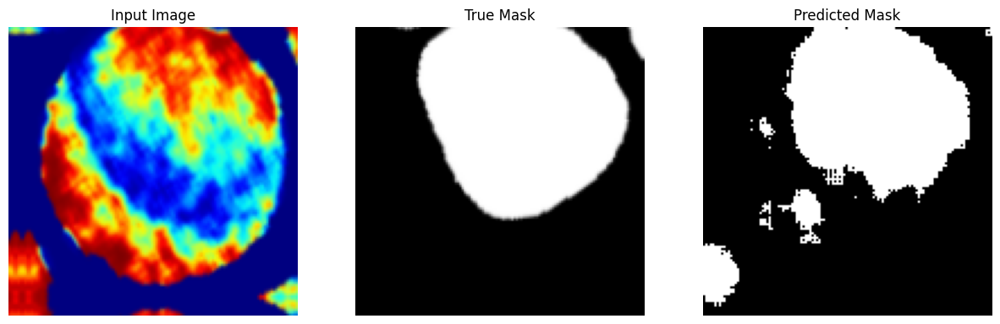


Sample Prediction after epoch 95

6/6 [==============================] - 3s 441ms/step - loss: 0.1279 - accuracy: 0.8881 - val_loss: 0.2638 - val_accuracy: 0.8933
Epoch 96/200
1/1 [==============================] - 0s 143ms/step


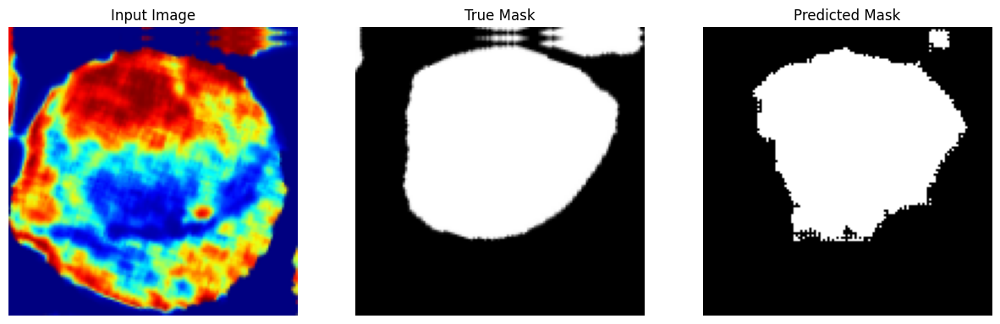


Sample Prediction after epoch 96

6/6 [==============================] - 2s 413ms/step - loss: 0.1388 - accuracy: 0.8809 - val_loss: 0.1871 - val_accuracy: 0.9225
Epoch 97/200
1/1 [==============================] - 0s 143ms/step


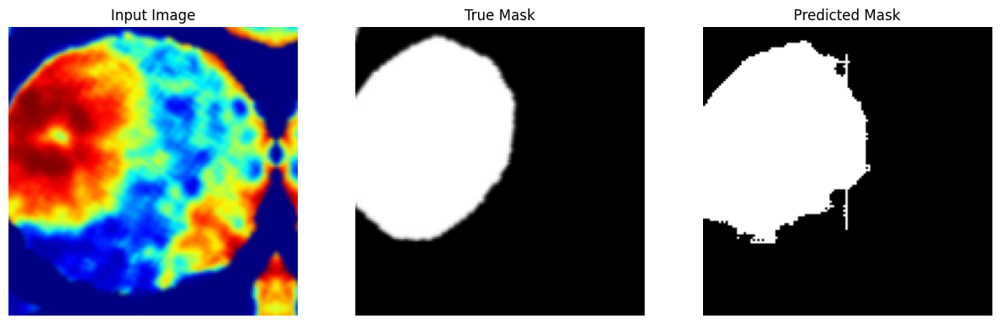


Sample Prediction after epoch 97

6/6 [==============================] - 2s 406ms/step - loss: 0.1374 - accuracy: 0.8878 - val_loss: 0.2647 - val_accuracy: 0.9016
Epoch 98/200
1/1 [==============================] - 0s 142ms/step


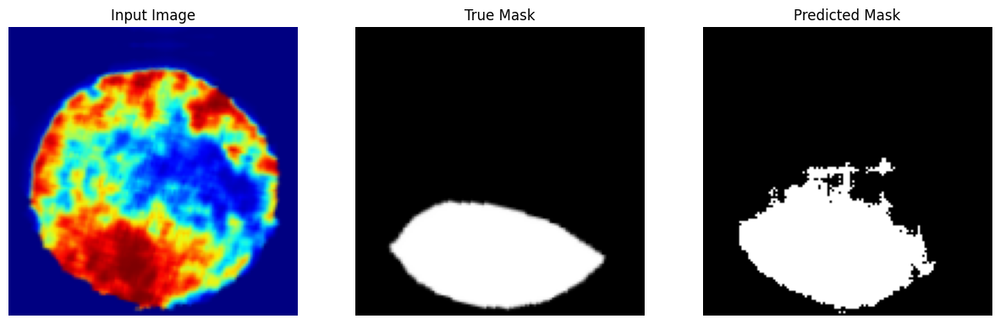


Sample Prediction after epoch 98

6/6 [==============================] - 2s 407ms/step - loss: 0.1351 - accuracy: 0.8819 - val_loss: 0.2049 - val_accuracy: 0.9167
Epoch 99/200
1/1 [==============================] - 0s 141ms/step


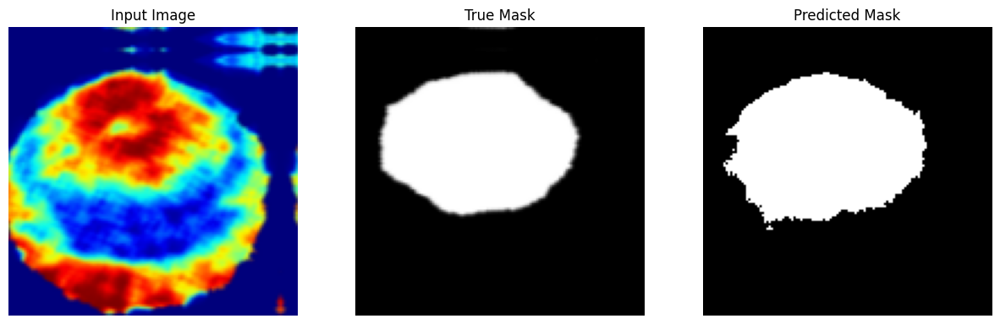


Sample Prediction after epoch 99

6/6 [==============================] - 3s 453ms/step - loss: 0.1440 - accuracy: 0.8846 - val_loss: 0.2007 - val_accuracy: 0.9172
Epoch 100/200
1/1 [==============================] - 0s 134ms/step


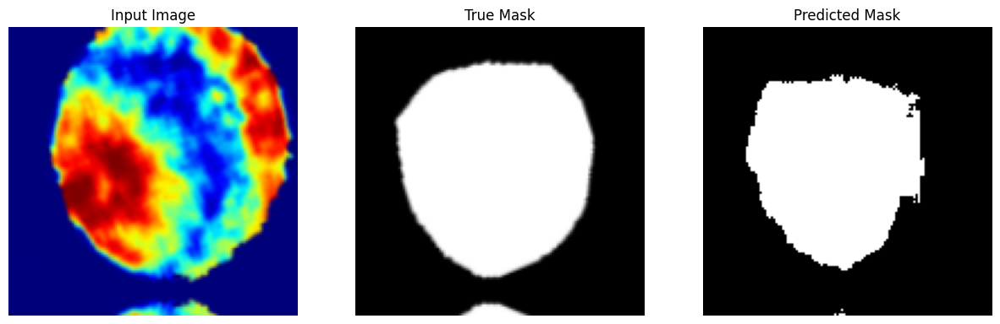


Sample Prediction after epoch 100

6/6 [==============================] - 2s 463ms/step - loss: 0.1222 - accuracy: 0.8836 - val_loss: 0.2364 - val_accuracy: 0.9098
Epoch 101/200
1/1 [==============================] - 0s 142ms/step


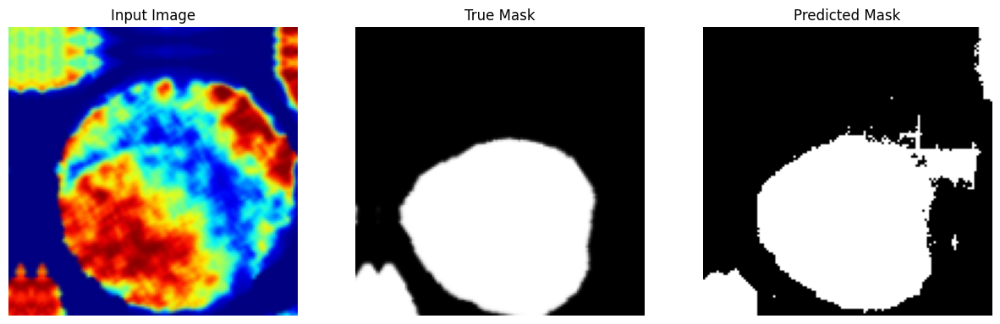


Sample Prediction after epoch 101

6/6 [==============================] - 2s 427ms/step - loss: 0.1424 - accuracy: 0.8803 - val_loss: 0.2161 - val_accuracy: 0.9144
Epoch 102/200
1/1 [==============================] - 0s 142ms/step


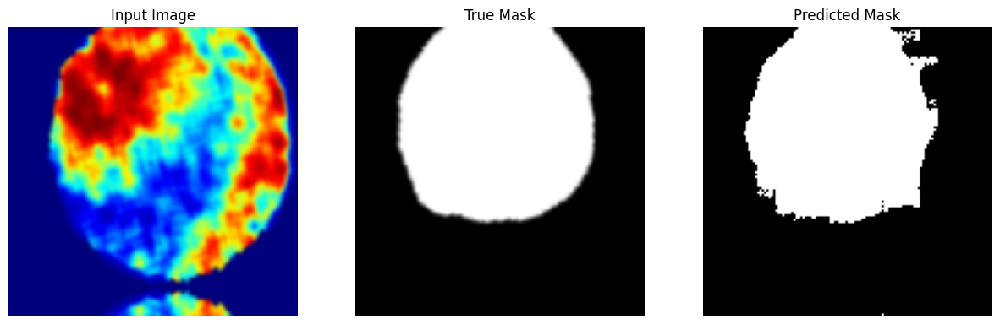


Sample Prediction after epoch 102

6/6 [==============================] - 3s 466ms/step - loss: 0.1336 - accuracy: 0.8815 - val_loss: 0.2183 - val_accuracy: 0.9118
Epoch 103/200
1/1 [==============================] - 0s 142ms/step


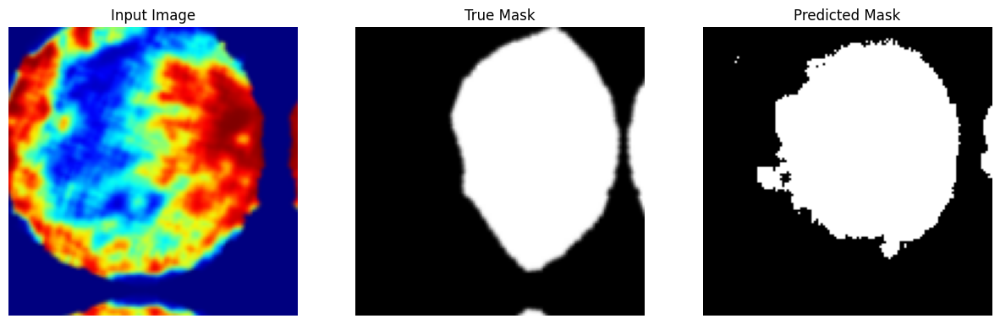


Sample Prediction after epoch 103

6/6 [==============================] - 2s 425ms/step - loss: 0.1316 - accuracy: 0.8884 - val_loss: 0.2115 - val_accuracy: 0.9170
Epoch 104/200
1/1 [==============================] - 0s 157ms/step


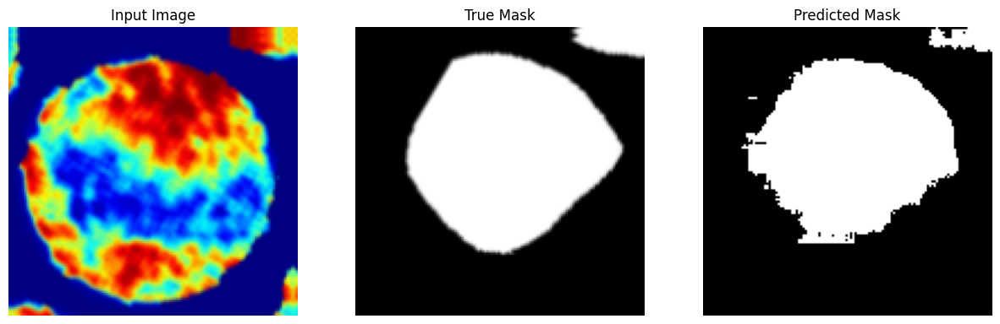


Sample Prediction after epoch 104

6/6 [==============================] - 2s 416ms/step - loss: 0.1245 - accuracy: 0.8881 - val_loss: 0.1998 - val_accuracy: 0.9208
Epoch 105/200
1/1 [==============================] - 0s 142ms/step


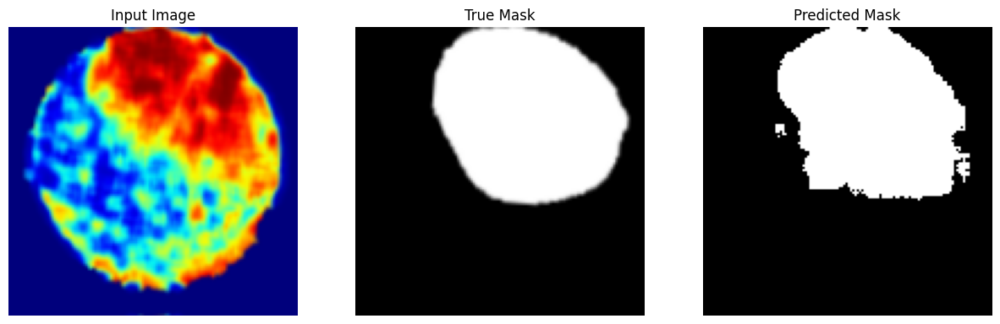


Sample Prediction after epoch 105

6/6 [==============================] - 2s 440ms/step - loss: 0.1473 - accuracy: 0.8802 - val_loss: 0.2253 - val_accuracy: 0.9131
Epoch 106/200
1/1 [==============================] - 0s 157ms/step


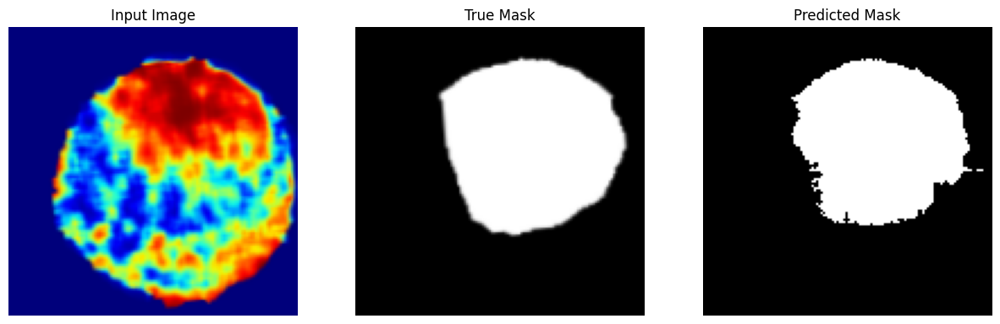


Sample Prediction after epoch 106

6/6 [==============================] - 2s 446ms/step - loss: 0.1416 - accuracy: 0.8784 - val_loss: 0.1829 - val_accuracy: 0.9252
Epoch 107/200
1/1 [==============================] - 0s 156ms/step


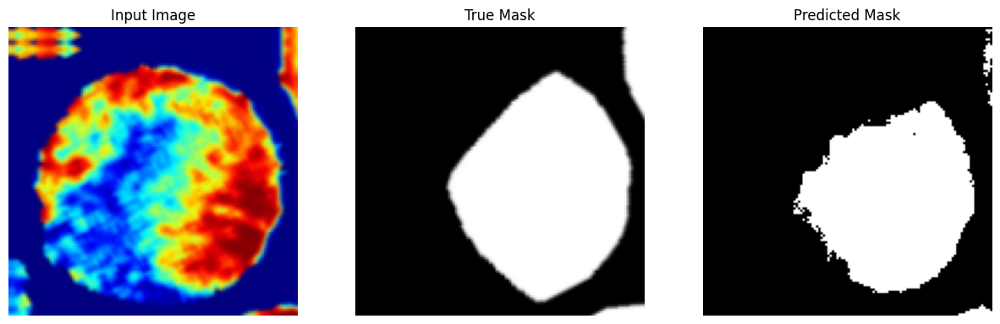


Sample Prediction after epoch 107

6/6 [==============================] - 2s 456ms/step - loss: 0.1350 - accuracy: 0.8822 - val_loss: 0.2125 - val_accuracy: 0.9121
Epoch 108/200
1/1 [==============================] - 0s 142ms/step


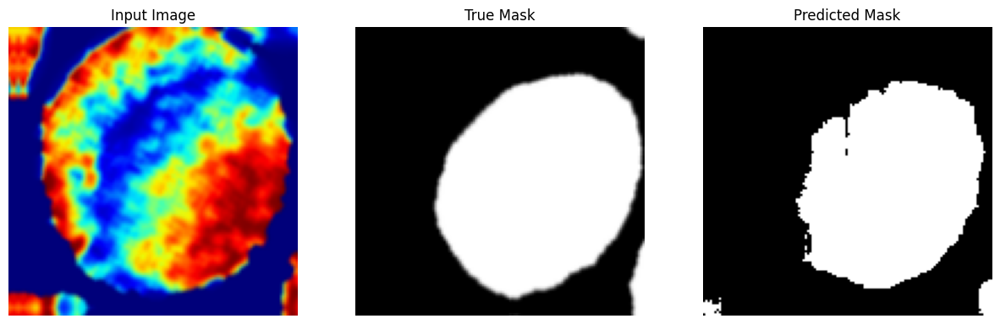


Sample Prediction after epoch 108

6/6 [==============================] - 3s 451ms/step - loss: 0.1222 - accuracy: 0.8883 - val_loss: 0.2443 - val_accuracy: 0.9068
Epoch 109/200
1/1 [==============================] - 0s 141ms/step


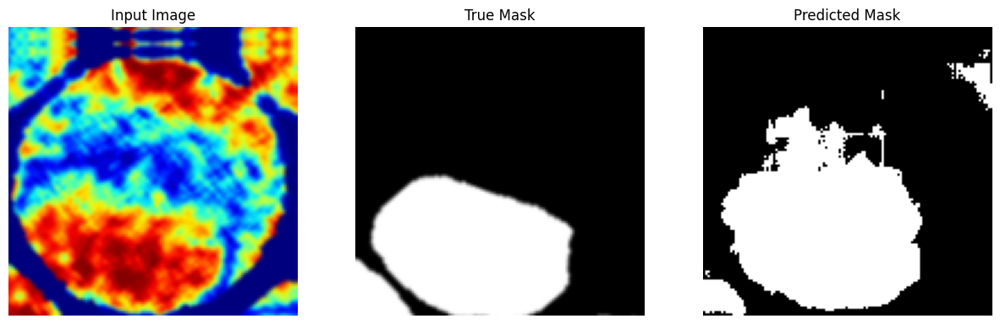


Sample Prediction after epoch 109

6/6 [==============================] - 2s 431ms/step - loss: 0.1348 - accuracy: 0.8840 - val_loss: 0.2043 - val_accuracy: 0.9214
Epoch 110/200
1/1 [==============================] - 0s 157ms/step


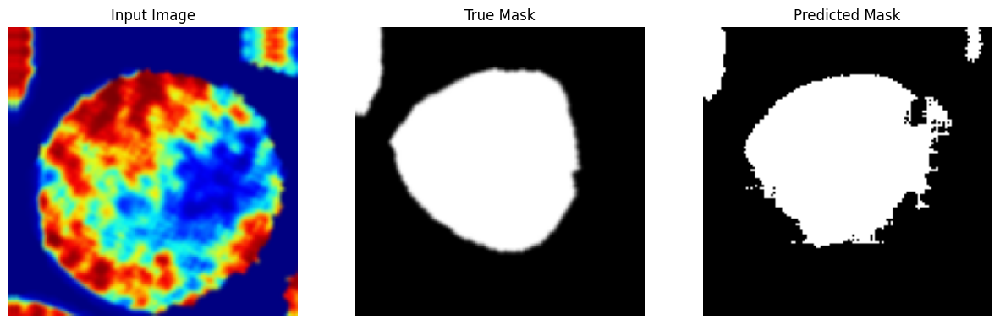


Sample Prediction after epoch 110

6/6 [==============================] - 2s 428ms/step - loss: 0.1417 - accuracy: 0.8823 - val_loss: 0.2616 - val_accuracy: 0.9038
Epoch 111/200
1/1 [==============================] - 0s 126ms/step


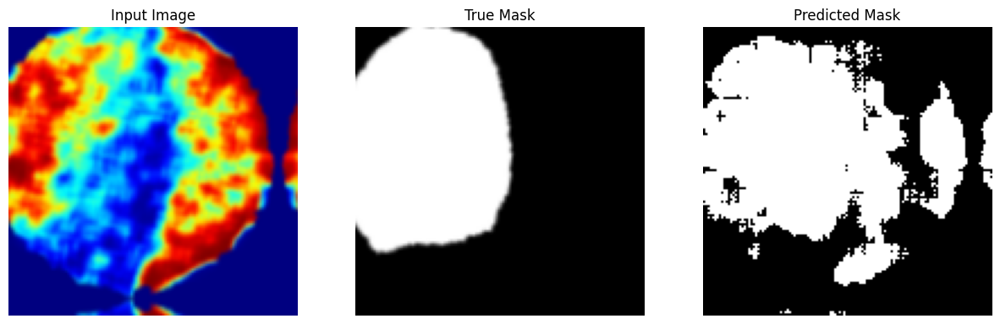


Sample Prediction after epoch 111

6/6 [==============================] - 3s 449ms/step - loss: 0.1337 - accuracy: 0.8825 - val_loss: 0.1979 - val_accuracy: 0.9157
Epoch 112/200
1/1 [==============================] - 0s 143ms/step


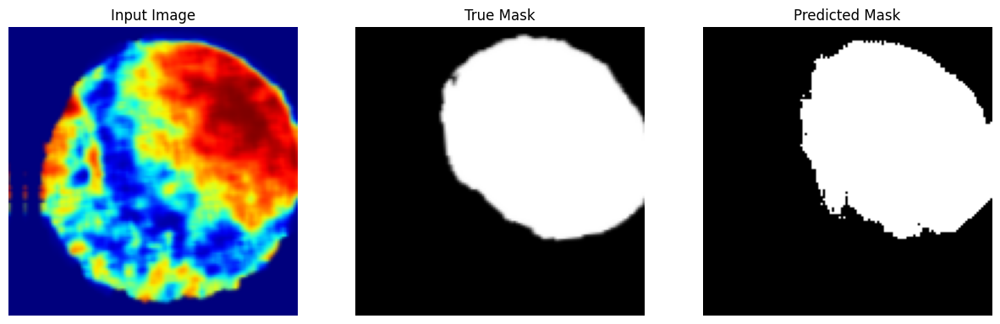


Sample Prediction after epoch 112

6/6 [==============================] - 2s 414ms/step - loss: 0.1330 - accuracy: 0.8849 - val_loss: 0.2066 - val_accuracy: 0.9164
Epoch 113/200
1/1 [==============================] - 0s 142ms/step


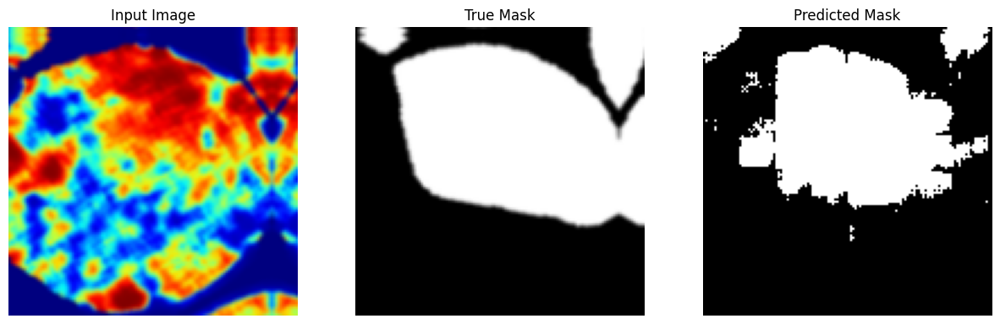


Sample Prediction after epoch 113

6/6 [==============================] - 3s 453ms/step - loss: 0.1392 - accuracy: 0.8837 - val_loss: 0.2397 - val_accuracy: 0.9086
Epoch 114/200
1/1 [==============================] - 0s 143ms/step


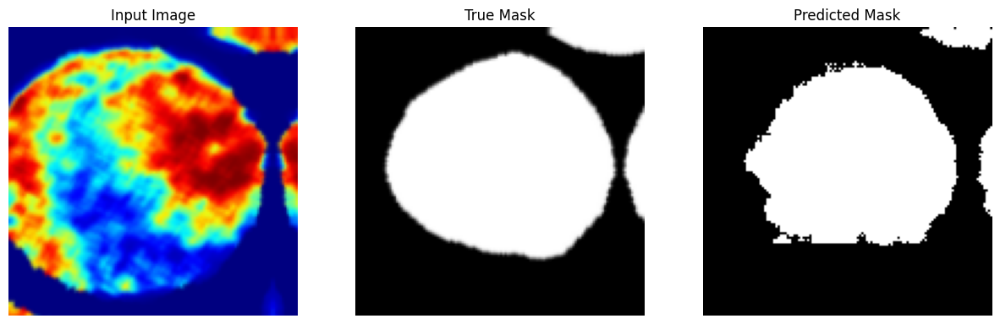


Sample Prediction after epoch 114

6/6 [==============================] - 2s 465ms/step - loss: 0.1489 - accuracy: 0.8737 - val_loss: 0.2504 - val_accuracy: 0.9055
Epoch 115/200
1/1 [==============================] - 0s 157ms/step


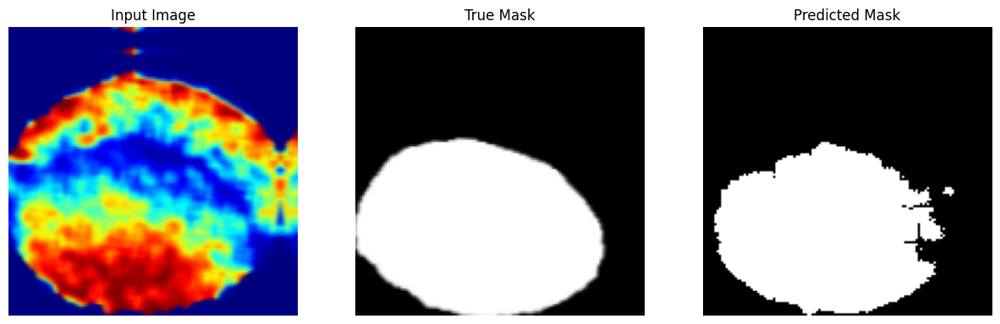


Sample Prediction after epoch 115

6/6 [==============================] - 3s 453ms/step - loss: 0.1392 - accuracy: 0.8758 - val_loss: 0.2309 - val_accuracy: 0.9110
Epoch 116/200
1/1 [==============================] - 0s 126ms/step


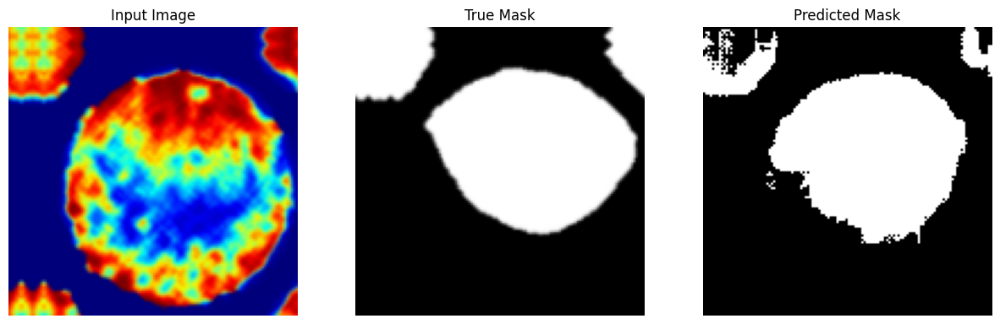


Sample Prediction after epoch 116

6/6 [==============================] - 2s 412ms/step - loss: 0.1199 - accuracy: 0.8927 - val_loss: 0.1979 - val_accuracy: 0.9217
Epoch 117/200
1/1 [==============================] - 0s 142ms/step


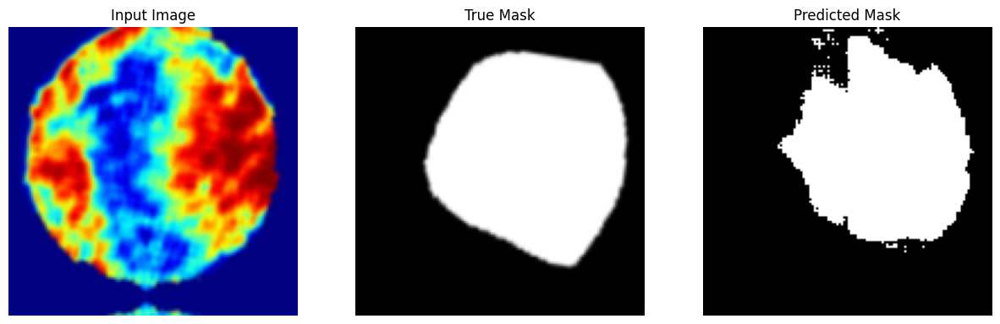


Sample Prediction after epoch 117

6/6 [==============================] - 2s 414ms/step - loss: 0.1449 - accuracy: 0.8774 - val_loss: 0.3240 - val_accuracy: 0.8888
Epoch 118/200
1/1 [==============================] - 0s 143ms/step


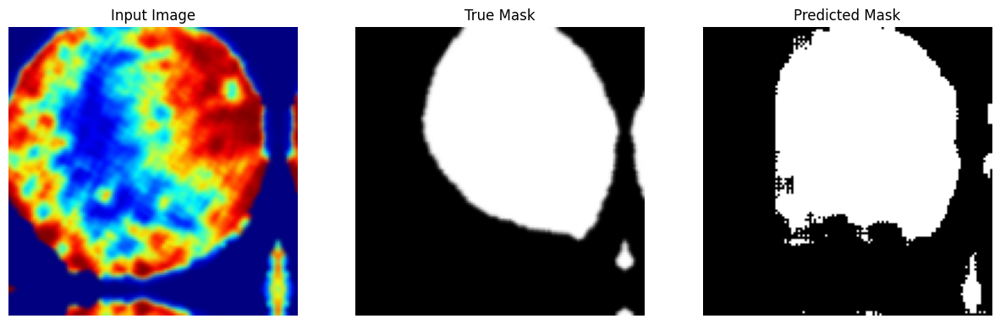


Sample Prediction after epoch 118

6/6 [==============================] - 2s 411ms/step - loss: 0.1323 - accuracy: 0.8824 - val_loss: 0.1998 - val_accuracy: 0.9207
Epoch 119/200
1/1 [==============================] - 0s 157ms/step


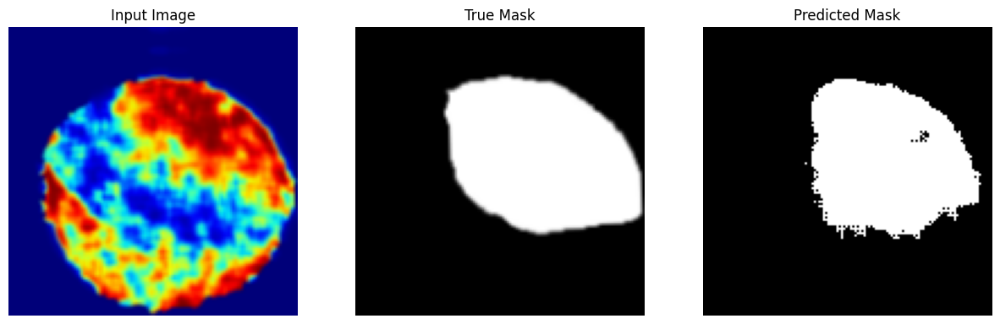


Sample Prediction after epoch 119

6/6 [==============================] - 3s 459ms/step - loss: 0.1283 - accuracy: 0.8926 - val_loss: 0.2905 - val_accuracy: 0.9025
Epoch 120/200
1/1 [==============================] - 0s 142ms/step


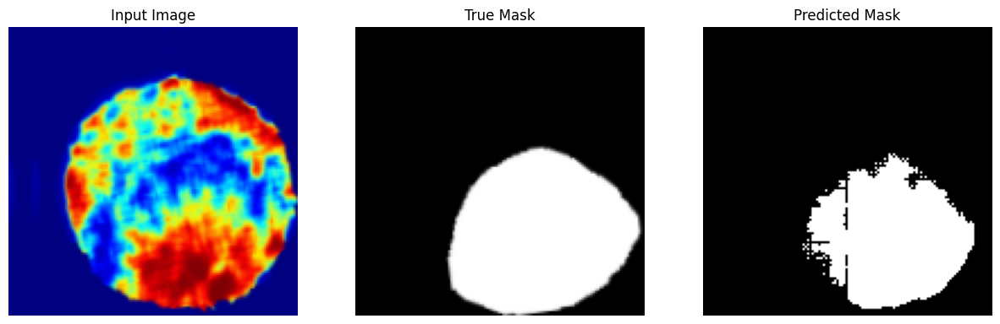


Sample Prediction after epoch 120

6/6 [==============================] - 3s 455ms/step - loss: 0.1377 - accuracy: 0.8806 - val_loss: 0.2467 - val_accuracy: 0.9086
Epoch 121/200
1/1 [==============================] - 0s 140ms/step


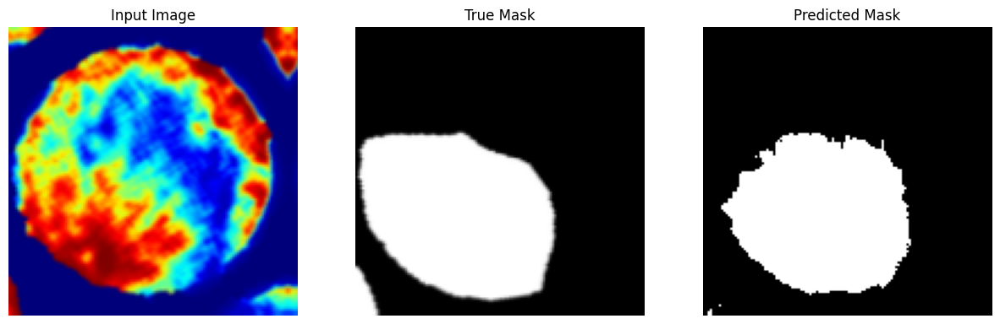


Sample Prediction after epoch 121

6/6 [==============================] - 3s 519ms/step - loss: 0.1299 - accuracy: 0.8856 - val_loss: 0.2347 - val_accuracy: 0.9142
Epoch 122/200
1/1 [==============================] - 0s 141ms/step


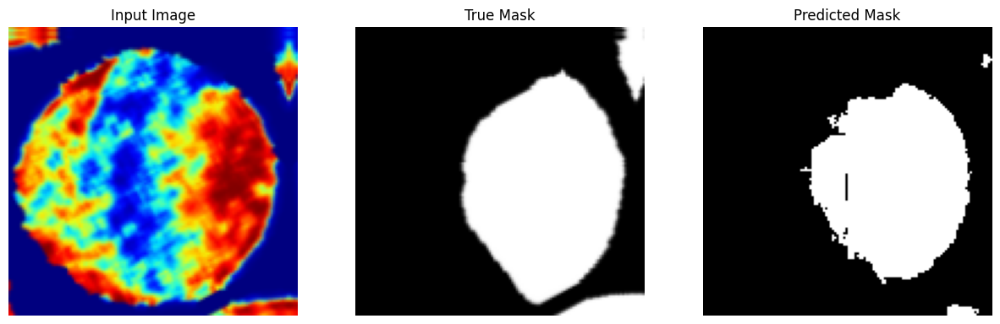


Sample Prediction after epoch 122

6/6 [==============================] - 3s 466ms/step - loss: 0.1328 - accuracy: 0.8793 - val_loss: 0.2841 - val_accuracy: 0.9049
Epoch 123/200
1/1 [==============================] - 0s 142ms/step


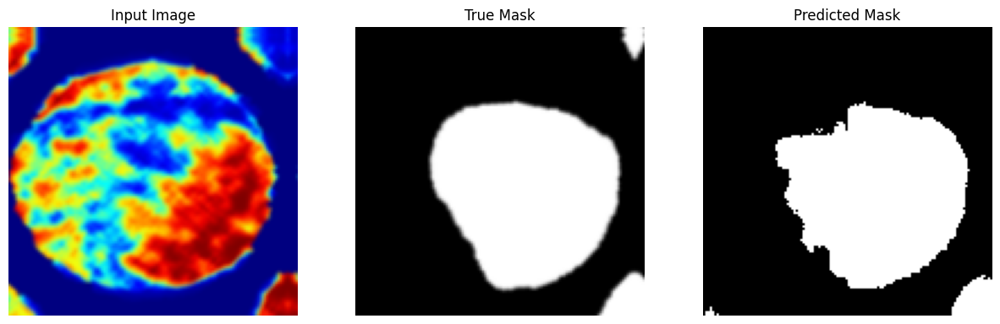


Sample Prediction after epoch 123

6/6 [==============================] - 2s 434ms/step - loss: 0.1219 - accuracy: 0.8899 - val_loss: 0.2165 - val_accuracy: 0.9208
Epoch 124/200
1/1 [==============================] - 0s 174ms/step


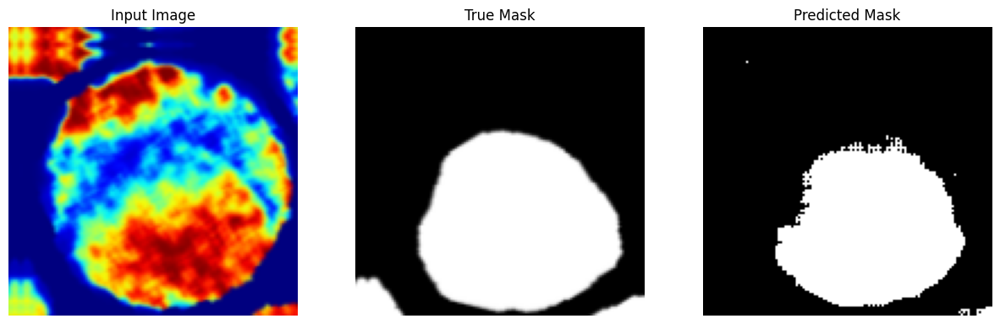


Sample Prediction after epoch 124

6/6 [==============================] - 2s 444ms/step - loss: 0.1277 - accuracy: 0.8845 - val_loss: 0.3133 - val_accuracy: 0.9004
Epoch 125/200
1/1 [==============================] - 0s 142ms/step


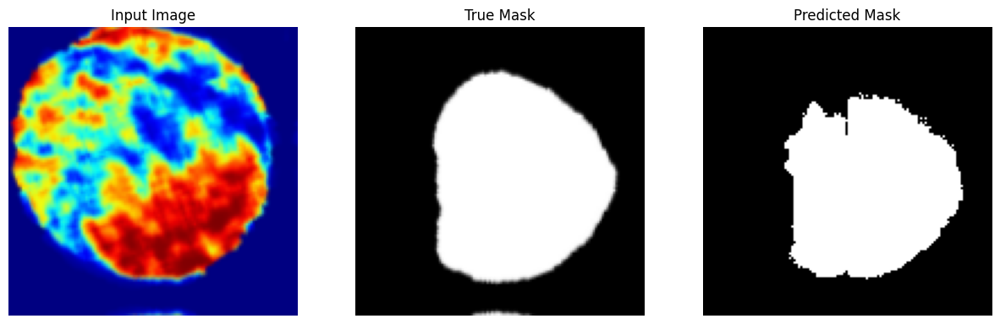


Sample Prediction after epoch 125

6/6 [==============================] - 3s 461ms/step - loss: 0.1284 - accuracy: 0.8856 - val_loss: 0.2467 - val_accuracy: 0.9125
Epoch 126/200
1/1 [==============================] - 0s 155ms/step


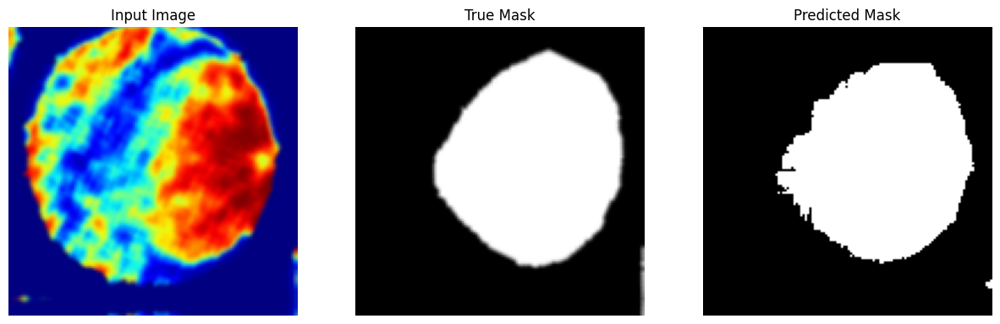


Sample Prediction after epoch 126

6/6 [==============================] - 2s 423ms/step - loss: 0.1395 - accuracy: 0.8758 - val_loss: 0.2079 - val_accuracy: 0.9187
Epoch 127/200
1/1 [==============================] - 0s 158ms/step


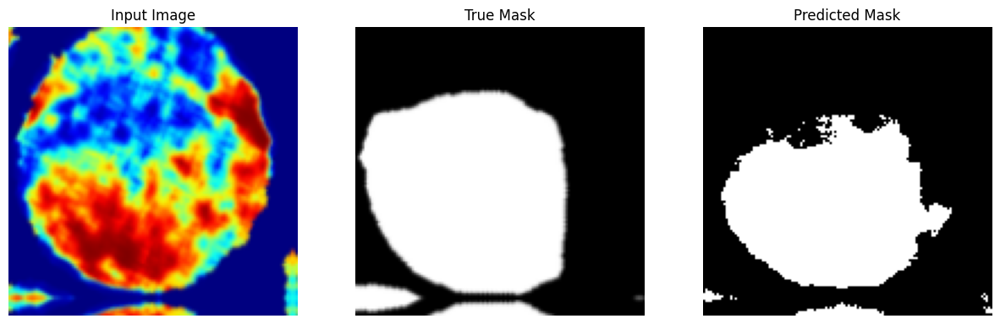


Sample Prediction after epoch 127

6/6 [==============================] - 3s 479ms/step - loss: 0.1344 - accuracy: 0.8809 - val_loss: 0.2030 - val_accuracy: 0.9166
Epoch 128/200
1/1 [==============================] - 0s 150ms/step


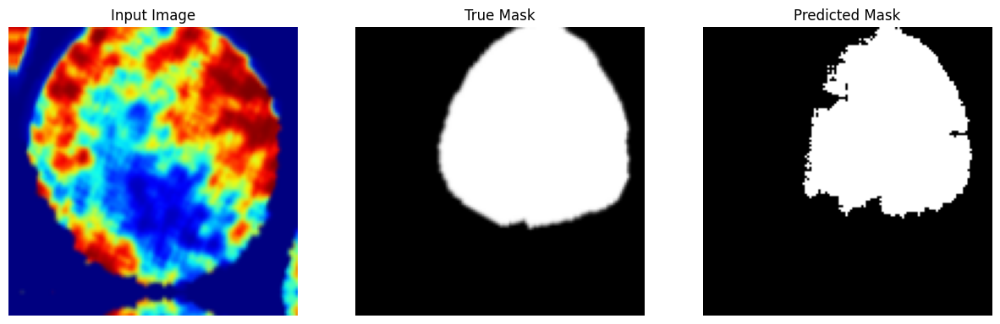


Sample Prediction after epoch 128

6/6 [==============================] - 3s 508ms/step - loss: 0.1277 - accuracy: 0.8854 - val_loss: 0.2907 - val_accuracy: 0.8940
Epoch 129/200
1/1 [==============================] - 0s 142ms/step


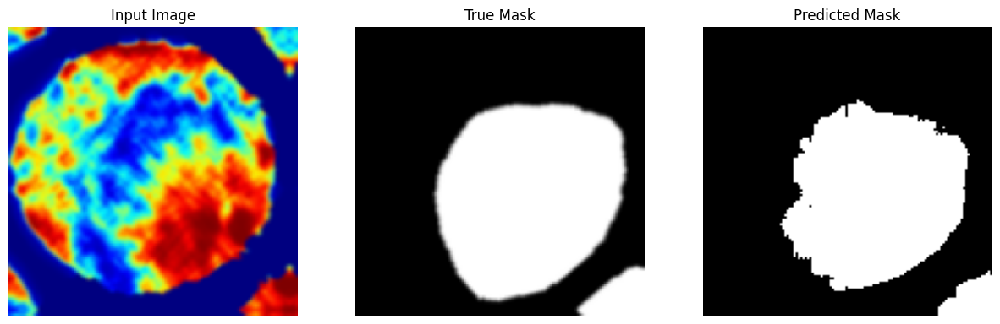


Sample Prediction after epoch 129

6/6 [==============================] - 2s 436ms/step - loss: 0.1272 - accuracy: 0.8856 - val_loss: 0.2338 - val_accuracy: 0.9102
Epoch 130/200
1/1 [==============================] - 0s 135ms/step


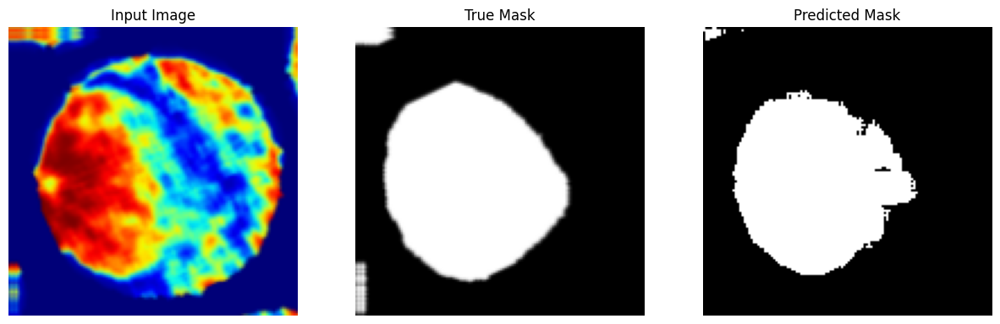


Sample Prediction after epoch 130

6/6 [==============================] - 2s 439ms/step - loss: 0.1374 - accuracy: 0.8824 - val_loss: 0.3063 - val_accuracy: 0.8925
Epoch 131/200
1/1 [==============================] - 0s 125ms/step


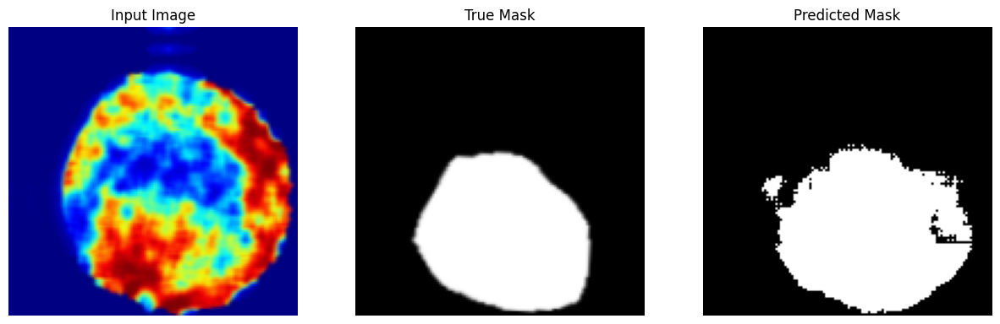


Sample Prediction after epoch 131

6/6 [==============================] - 3s 452ms/step - loss: 0.1262 - accuracy: 0.8851 - val_loss: 0.1888 - val_accuracy: 0.9222
Epoch 132/200
1/1 [==============================] - 0s 142ms/step


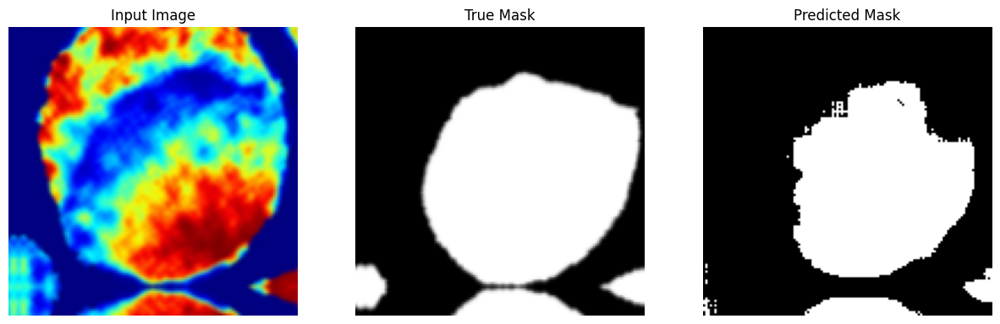


Sample Prediction after epoch 132

6/6 [==============================] - 2s 435ms/step - loss: 0.1446 - accuracy: 0.8781 - val_loss: 0.3175 - val_accuracy: 0.8953
Epoch 133/200
1/1 [==============================] - 0s 128ms/step


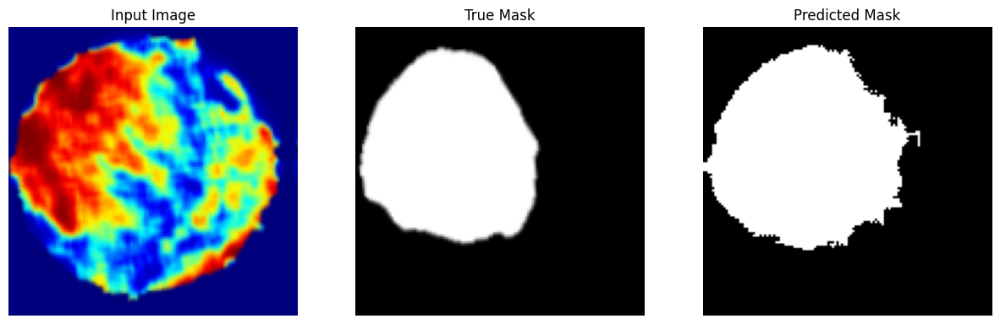


Sample Prediction after epoch 133

6/6 [==============================] - 2s 440ms/step - loss: 0.1376 - accuracy: 0.8742 - val_loss: 0.2180 - val_accuracy: 0.9207
Epoch 134/200
1/1 [==============================] - 0s 142ms/step


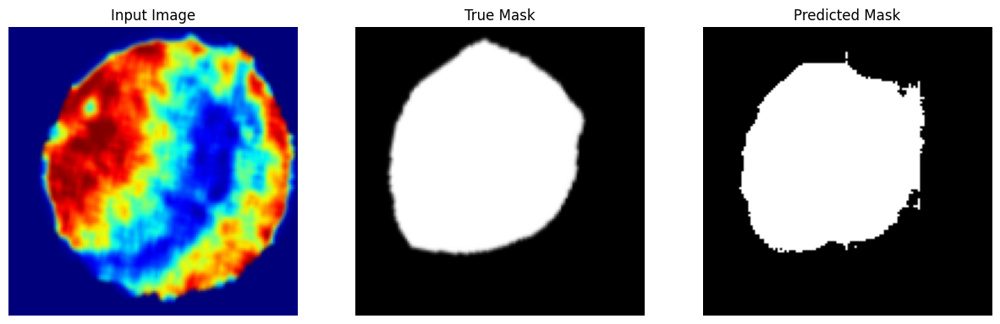


Sample Prediction after epoch 134

6/6 [==============================] - 3s 497ms/step - loss: 0.1293 - accuracy: 0.8901 - val_loss: 0.2221 - val_accuracy: 0.9211
Epoch 135/200
1/1 [==============================] - 0s 142ms/step


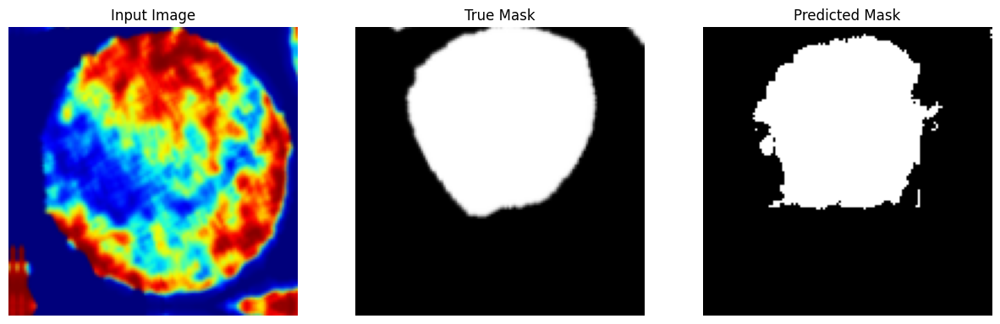


Sample Prediction after epoch 135

6/6 [==============================] - 2s 460ms/step - loss: 0.1346 - accuracy: 0.8861 - val_loss: 0.2277 - val_accuracy: 0.9173
Epoch 136/200
1/1 [==============================] - 0s 154ms/step


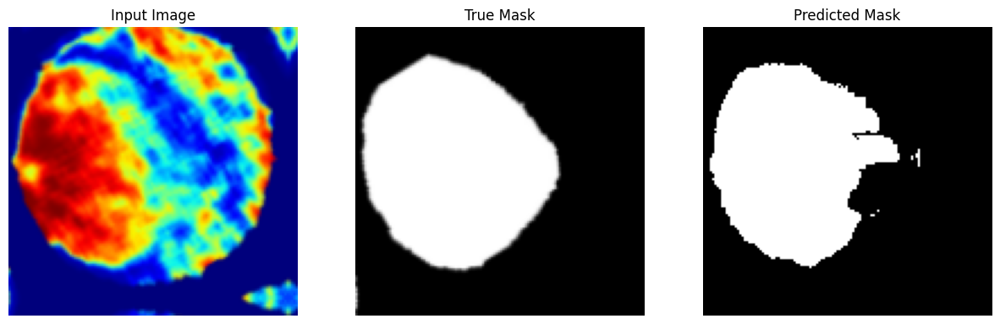


Sample Prediction after epoch 136

6/6 [==============================] - 2s 435ms/step - loss: 0.1300 - accuracy: 0.8887 - val_loss: 0.3156 - val_accuracy: 0.8932
Epoch 137/200
1/1 [==============================] - 0s 141ms/step


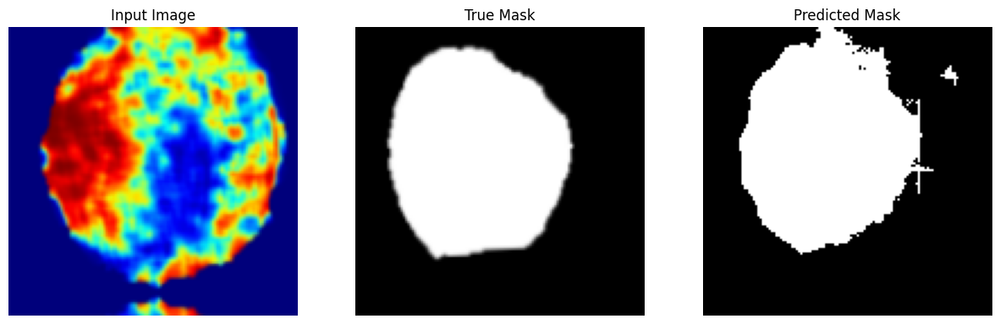


Sample Prediction after epoch 137

6/6 [==============================] - 3s 468ms/step - loss: 0.1254 - accuracy: 0.8875 - val_loss: 0.2230 - val_accuracy: 0.9147
Epoch 138/200
1/1 [==============================] - 0s 143ms/step


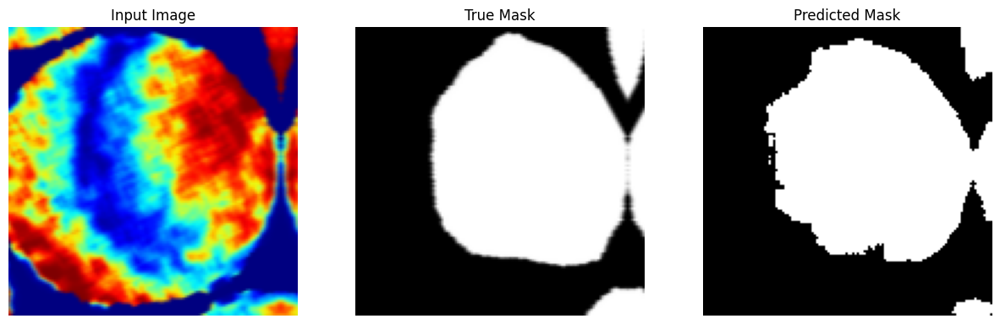


Sample Prediction after epoch 138

6/6 [==============================] - 2s 433ms/step - loss: 0.1184 - accuracy: 0.8917 - val_loss: 0.2201 - val_accuracy: 0.9177
Epoch 139/200
1/1 [==============================] - 0s 139ms/step


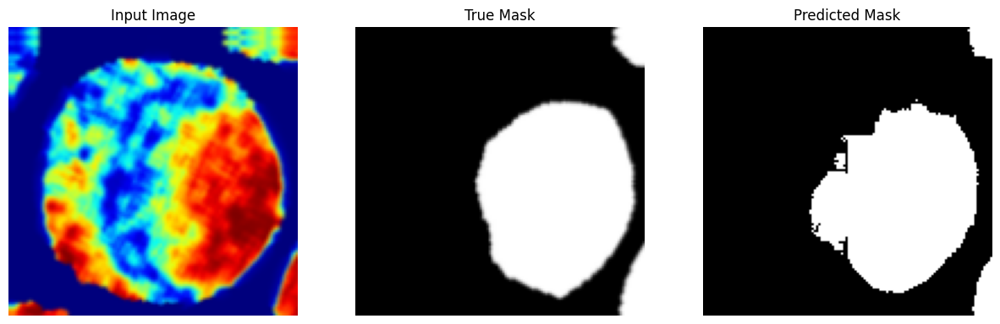


Sample Prediction after epoch 139

6/6 [==============================] - 2s 434ms/step - loss: 0.1229 - accuracy: 0.8833 - val_loss: 0.2283 - val_accuracy: 0.9163
Epoch 140/200
1/1 [==============================] - 0s 140ms/step


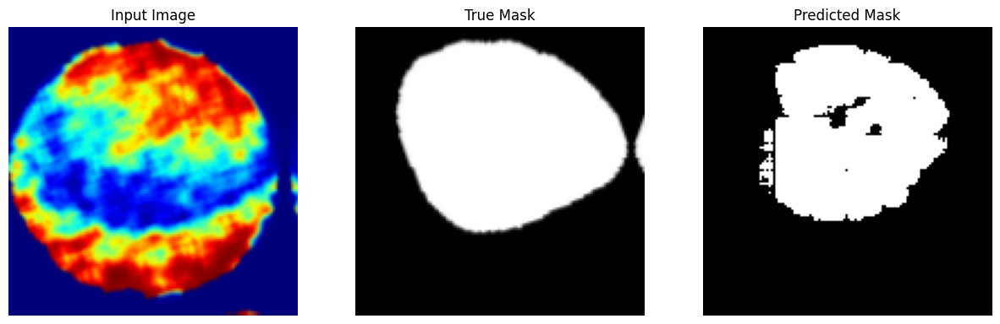


Sample Prediction after epoch 140

6/6 [==============================] - 3s 455ms/step - loss: 0.1243 - accuracy: 0.8872 - val_loss: 0.2924 - val_accuracy: 0.8965
Epoch 141/200
1/1 [==============================] - 0s 137ms/step


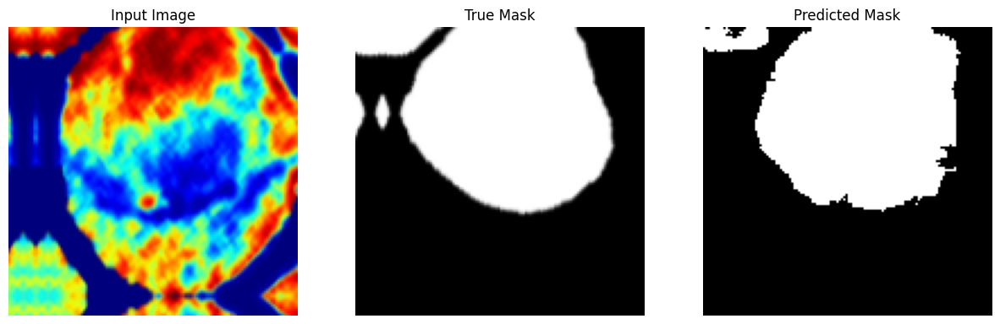


Sample Prediction after epoch 141

6/6 [==============================] - 3s 475ms/step - loss: 0.1225 - accuracy: 0.8894 - val_loss: 0.2621 - val_accuracy: 0.9075
Epoch 142/200
1/1 [==============================] - 0s 143ms/step


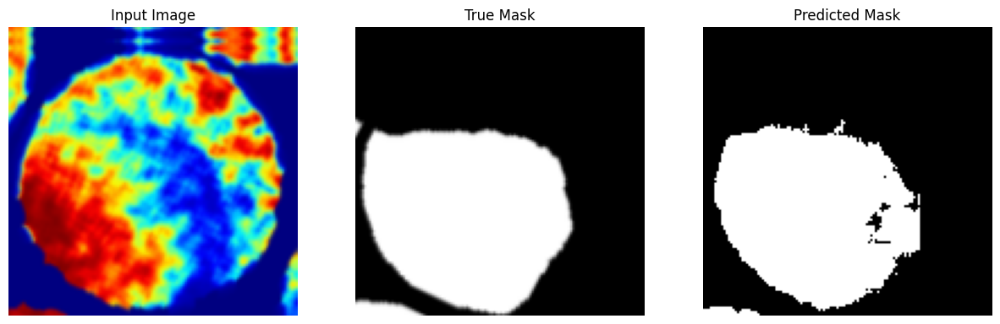


Sample Prediction after epoch 142

6/6 [==============================] - 3s 512ms/step - loss: 0.1344 - accuracy: 0.8823 - val_loss: 0.2524 - val_accuracy: 0.9110
Epoch 143/200
1/1 [==============================] - 0s 140ms/step


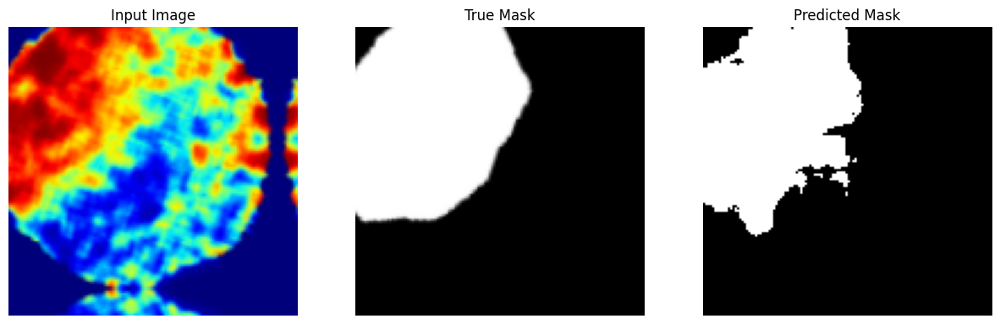


Sample Prediction after epoch 143

6/6 [==============================] - 3s 467ms/step - loss: 0.1169 - accuracy: 0.8868 - val_loss: 0.2085 - val_accuracy: 0.9208
Epoch 144/200
1/1 [==============================] - 0s 157ms/step


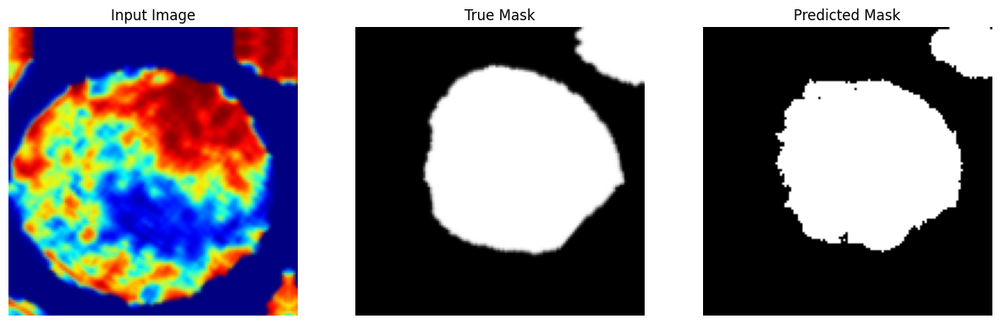


Sample Prediction after epoch 144

6/6 [==============================] - 3s 451ms/step - loss: 0.1230 - accuracy: 0.8887 - val_loss: 0.1938 - val_accuracy: 0.9243
Epoch 145/200
1/1 [==============================] - 0s 142ms/step


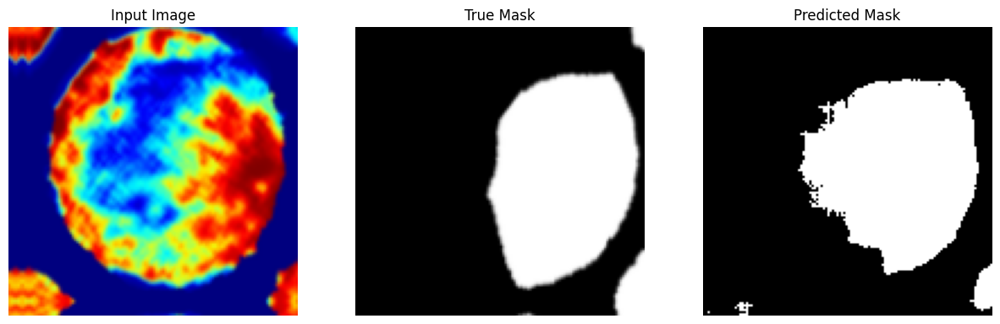


Sample Prediction after epoch 145

6/6 [==============================] - 3s 443ms/step - loss: 0.1179 - accuracy: 0.8915 - val_loss: 0.2045 - val_accuracy: 0.9213
Epoch 146/200
1/1 [==============================] - 0s 143ms/step


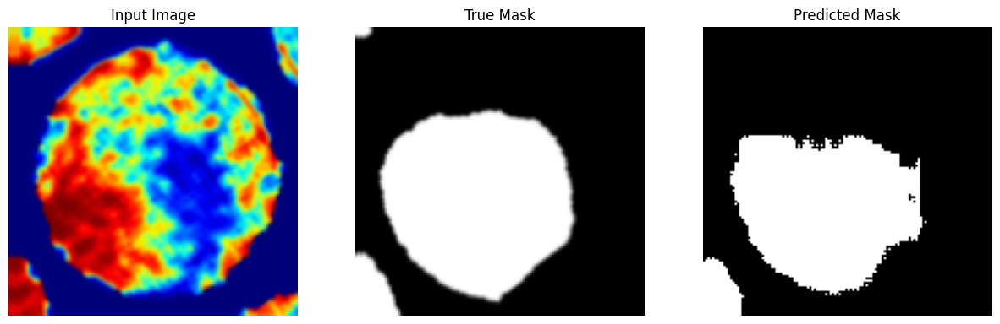


Sample Prediction after epoch 146

6/6 [==============================] - 3s 464ms/step - loss: 0.1417 - accuracy: 0.8748 - val_loss: 0.1930 - val_accuracy: 0.9267
Epoch 147/200
1/1 [==============================] - 0s 142ms/step


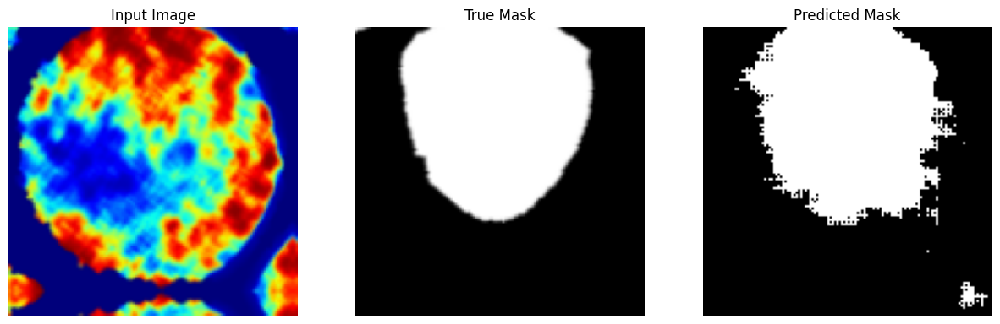


Sample Prediction after epoch 147

6/6 [==============================] - 2s 444ms/step - loss: 0.1374 - accuracy: 0.8919 - val_loss: 0.2491 - val_accuracy: 0.9160
Epoch 148/200
1/1 [==============================] - 0s 142ms/step


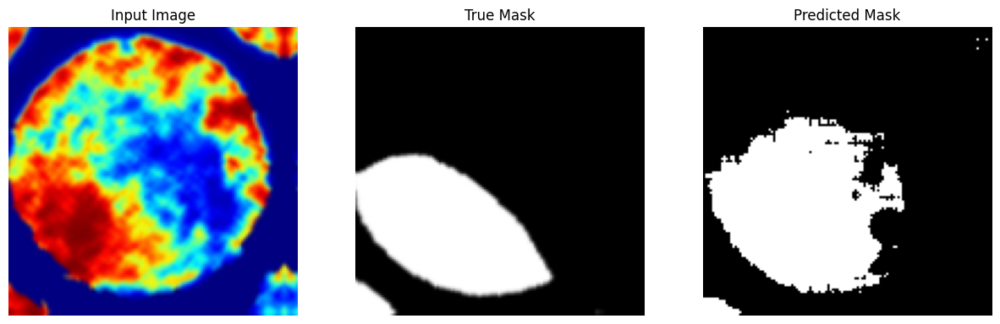


Sample Prediction after epoch 148

6/6 [==============================] - 3s 496ms/step - loss: 0.1267 - accuracy: 0.8810 - val_loss: 0.2101 - val_accuracy: 0.9223
Epoch 149/200
1/1 [==============================] - 0s 142ms/step


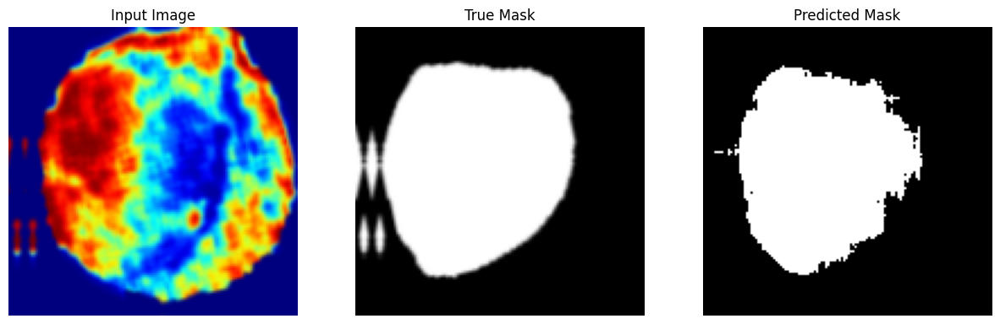


Sample Prediction after epoch 149

6/6 [==============================] - 3s 526ms/step - loss: 0.1350 - accuracy: 0.8824 - val_loss: 0.2294 - val_accuracy: 0.9155
Epoch 150/200
1/1 [==============================] - 0s 138ms/step


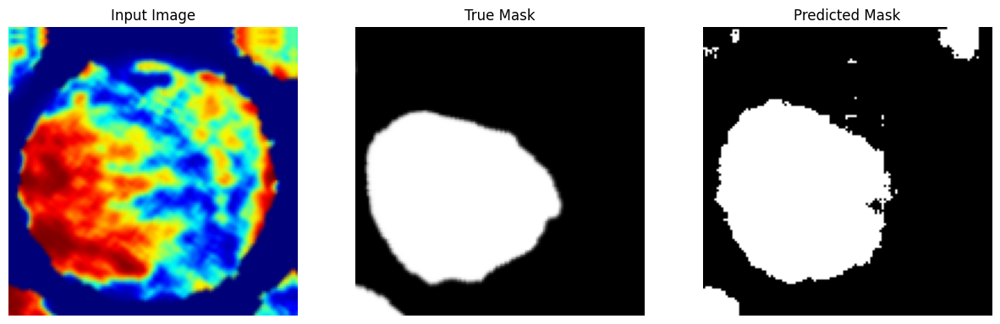


Sample Prediction after epoch 150

6/6 [==============================] - 2s 440ms/step - loss: 0.1212 - accuracy: 0.8852 - val_loss: 0.2596 - val_accuracy: 0.9069
Epoch 151/200
1/1 [==============================] - 0s 141ms/step


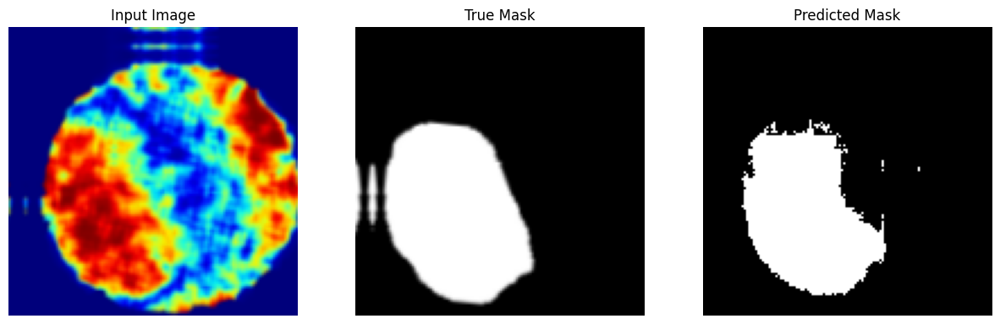


Sample Prediction after epoch 151

6/6 [==============================] - 2s 442ms/step - loss: 0.1150 - accuracy: 0.8882 - val_loss: 0.2708 - val_accuracy: 0.9057
Epoch 152/200
1/1 [==============================] - 0s 126ms/step


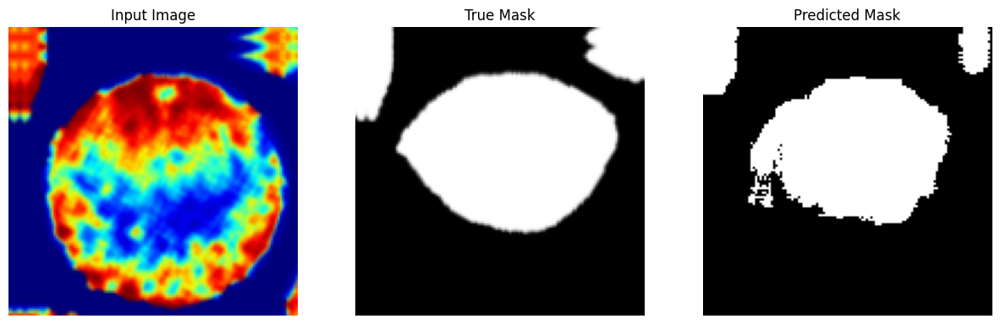


Sample Prediction after epoch 152

6/6 [==============================] - 3s 461ms/step - loss: 0.1112 - accuracy: 0.8947 - val_loss: 0.2933 - val_accuracy: 0.9036
Epoch 153/200
1/1 [==============================] - 0s 142ms/step


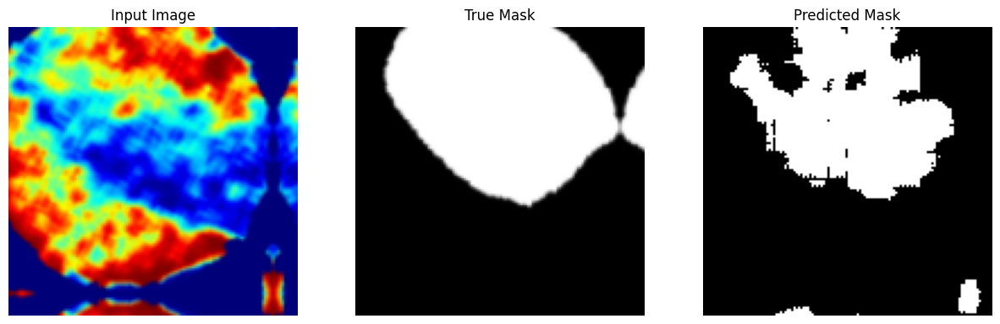


Sample Prediction after epoch 153

6/6 [==============================] - 3s 464ms/step - loss: 0.1200 - accuracy: 0.8850 - val_loss: 0.2505 - val_accuracy: 0.9142


In [74]:
from keras.callbacks import EarlyStopping
EPOCHS = 100
VAL_SUBSPLITS = 5
VALIDATION_STEPS = len(X_test)//BATCH_SIZE
STEPS_PER_EPOCH = len(X_train)//BATCH_SIZE

EPOCHS = 200
VAL_SUBSPLITS = 5
VALIDATION_STEPS = len(X_test) // BATCH_SIZE
STEPS_PER_EPOCH = len(X_train) // BATCH_SIZE

early_stopping = EarlyStopping(
    monitor='val_loss',  # The metric to monitor (e.g., validation loss)
    patience=100,         # Number of epochs to wait without improvement
    restore_best_weights=True  # Restore the model to the best weights
)

model_history = model.fit(train_batches, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=test_batches,
                          callbacks=[DisplayCallback(), early_stopping])

In [75]:
# evaluate the model
model.evaluate(test_batches, verbose=1)

# Compute intersection over union
iou = tf.keras.metrics.MeanIoU(num_classes=OUTPUT_CLASSES)
for images, labels in test_batches:
    pred = model.predict(images)
    pred = tf.argmax(pred, axis=-1)
    pred = pred[..., tf.newaxis]
    iou.update_state(labels, pred)

print("Accuracy = ", model.evaluate(test_batches, verbose=1)[1] * 100, "%")
print("Mean IoU =", iou.result().numpy())

2/2 [==============================] - 0s 111ms/step - loss: 0.1938 - accuracy: 0.9168
Accuracy =  91.67855978012085 %
Mean IoU = 0.82609344


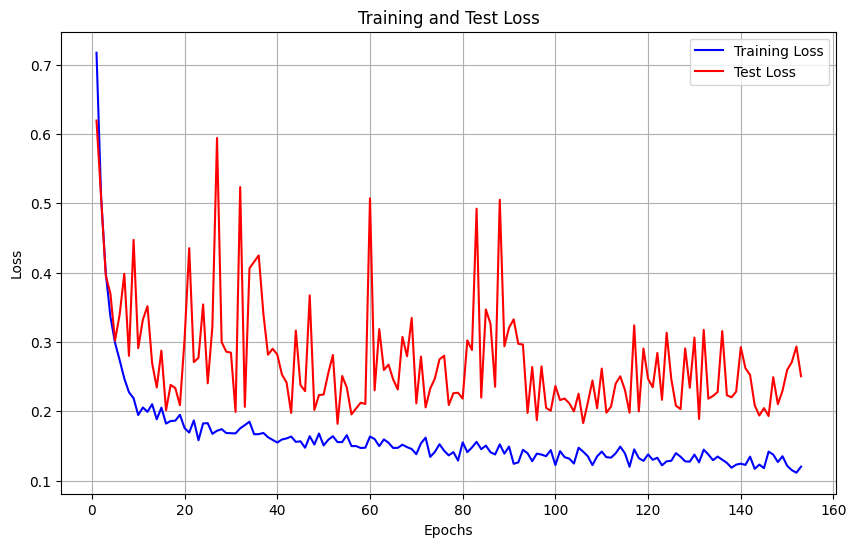

In [76]:
import matplotlib.pyplot as plt

# Extract data from the model history
train_loss = model_history.history['loss']
test_loss = model_history.history['val_loss']

# Create an array of the epoch numbers for the x-axis
epochs = range(1, len(train_loss) + 1)

# Plot the training loss
plt.figure(figsize=(10, 6))
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, test_loss, 'r', label='Test Loss')
plt.title('Training and Test Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

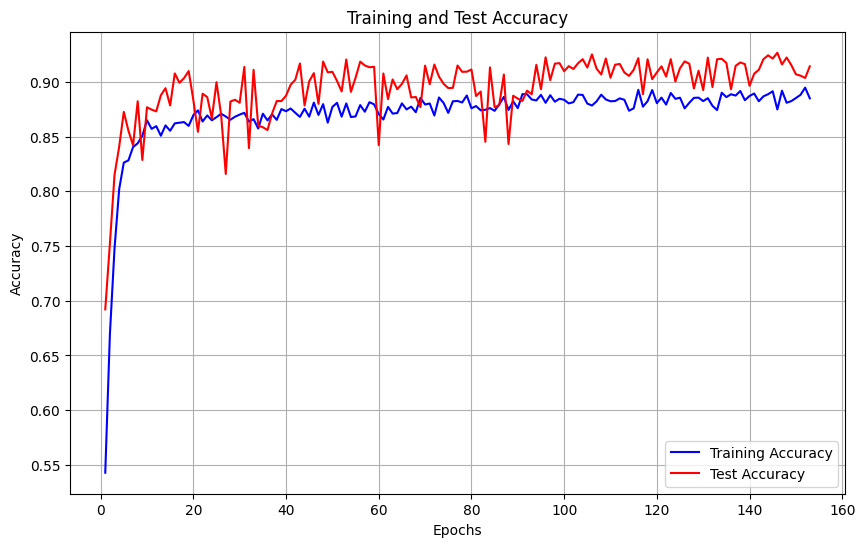

In [77]:
# Plot the training and testing accuracy
train_acc = model_history.history['accuracy']
test_acc = model_history.history['val_accuracy']

plt.figure(figsize=(10, 6))
plt.plot(epochs, train_acc, 'b', label='Training Accuracy')
plt.plot(epochs, test_acc, 'r', label='Test Accuracy')
plt.title('Training and Test Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

In [78]:
# Save the model
tf.keras.models.save_model(model, 'internal_mask_unet_model')

INFO:tensorflow:Assets written to: internal_mask_unet_model\assets


INFO:tensorflow:Assets written to: internal_mask_unet_model\assets
